# Simple exploration

objectif : avoir une vue d'ensemble sur les donnees produites avec le pipeline airflow.
   - statistiques globales
   - identification des crises et intercrises

## Librairies

In [1]:
!/usr/bin/python3 -m pip install --upgrade pip
!pip install plotly
!pip install glob2

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [1]:
import os
import glob

import pandas as pd
import numpy as np

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
from matplotlib import pyplot as plt
import seaborn as sns

## Load dataset

In [2]:
# Path to dir to save figures
figures_path = 'figures/'
# List of files
files_path = "../seizure_detection_pipeline/output/cons-v0_6/*/cons_PAT_*.csv"
# # Path to output files
res_path = "res/general/"

In [3]:
# Creation of a list of file path
patient_files = glob.glob(files_path, recursive = True)
print("Len : ", len(patient_files))
patient_files

Len :  193


['../seizure_detection_pipeline/output/cons-v0_6/PAT_12/cons_PAT_12_Annotations_EEG_15656_s1.csv',
 '../seizure_detection_pipeline/output/cons-v0_6/PAT_12/cons_PAT_12_Annotations_EEG_29797_s1.csv',
 '../seizure_detection_pipeline/output/cons-v0_6/PAT_12/cons_PAT_12_Annotations_EEG_29999_s1.csv',
 '../seizure_detection_pipeline/output/cons-v0_6/PAT_12/cons_PAT_12_Annotations_EEG_30000_s1.csv',
 '../seizure_detection_pipeline/output/cons-v0_6/PAT_17/cons_PAT_17_Annotations_EEG_25353_s1.csv',
 '../seizure_detection_pipeline/output/cons-v0_6/PAT_17/cons_PAT_17_Annotations_EEG_25959_s1.csv',
 '../seizure_detection_pipeline/output/cons-v0_6/PAT_17/cons_PAT_17_Annotations_EEG_25959_s2.csv',
 '../seizure_detection_pipeline/output/cons-v0_6/PAT_17/cons_PAT_17_Annotations_EEG_25959_s3.csv',
 '../seizure_detection_pipeline/output/cons-v0_6/PAT_17/cons_PAT_17_Annotations_EEG_25959_s4.csv',
 '../seizure_detection_pipeline/output/cons-v0_6/PAT_17/cons_PAT_17_Annotations_EEG_25959_s5.csv',
 '../seizu

In [4]:
df_files = pd.DataFrame(patient_files, columns = ['path'])
df_files

,path
0,../seizure_detection_pipeline/output/cons-v0_6...
1,../seizure_detection_pipeline/output/cons-v0_6...
2,../seizure_detection_pipeline/output/cons-v0_6...
3,../seizure_detection_pipeline/output/cons-v0_6...
4,../seizure_detection_pipeline/output/cons-v0_6...
...,...
188,../seizure_detection_pipeline/output/cons-v0_6...
189,../seizure_detection_pipeline/output/cons-v0_6...
190,../seizure_detection_pipeline/output/cons-v0_6...
191,../seizure_detection_pipeline/output/cons-v0_6...


In [5]:
def extract_patient_id(path):
    return int(path.split('cons_PAT_')[1].split('_Annotations')[0])

def extract_session_id(path):
    return int(path.split('_s')[0].split('_')[-1])

def extract_segment_id(path):
    return int(path.split('_s')[1].split('.csv')[0])

In [6]:
df_files['patient_id'] = df_files['path'].apply(extract_patient_id)
df_files['session_id'] = df_files['path'].apply(extract_session_id)
df_files['segment_id'] = df_files['path'].apply(extract_segment_id)
df_files

,path,patient_id,session_id,segment_id
0,../seizure_detection_pipeline/output/cons-v0_6...,12,15656,1
1,../seizure_detection_pipeline/output/cons-v0_6...,12,29797,1
2,../seizure_detection_pipeline/output/cons-v0_6...,12,29999,1
3,../seizure_detection_pipeline/output/cons-v0_6...,12,30000,1
4,../seizure_detection_pipeline/output/cons-v0_6...,17,25353,1
...,...,...,...,...
188,../seizure_detection_pipeline/output/cons-v0_6...,9,10303,5
189,../seizure_detection_pipeline/output/cons-v0_6...,9,10303,6
190,../seizure_detection_pipeline/output/cons-v0_6...,9,10303,7
191,../seizure_detection_pipeline/output/cons-v0_6...,9,10303,8


### Session exploration

##### Patient 18

In [7]:
df_session = pd.read_csv(df_files.loc[15]["path"])
df_session

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,timestamp,filename,label
0,1.0,1000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:19.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
1,2.0,2000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:20.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
2,3.0,3000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:21.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
3,4.0,4000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:22.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
4,5.0,5000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-02-13 15:28:23.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61660,61661.0,61661000.0,779.296875,197.825930,185.351942,12.0,75.000000,15.0,93.750000,188.345592,...,2.326367,5.787183,2777.211894,1.025050,128.289892,298.449415,2.326367,2017-02-14 08:35:59.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
61661,61662.0,61662000.0,732.319079,204.620566,199.553269,14.0,77.777778,17.0,94.444444,201.054379,...,2.173957,5.787935,2510.984394,1.151256,132.825724,288.757390,2.173957,2017-02-14 08:36:00.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
61662,61663.0,61663000.0,709.087171,224.701562,199.630544,14.0,77.777778,17.0,94.444444,201.001668,...,2.278767,5.798858,2728.846549,1.053150,131.376982,299.377530,2.278767,2017-02-14 08:36:01.750,/home/aura-sakhite/seizure_detection_pipeline/...,0
61663,61664.0,61664000.0,NaN,NaN,NaN,12.0,70.588235,14.0,82.352941,NaN,...,2.167153,5.786133,2494.025922,1.134980,132.758307,287.707602,2.167153,2017-02-14 08:36:02.750,/home/aura-sakhite/seizure_detection_pipeline/...,0


In [8]:
df_session.describe()

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
count,61665.000000,6.166500e+04,55074.000000,55074.000000,55074.000000,57144.000000,57144.000000,57144.000000,57144.000000,55074.000000,...,54974.000000,54974.000000,55034.000000,55034.000000,55034.000000,5.739100e+04,55034.000000,55034.000000,55034.000000,61665.000000
mean,30833.000000,3.083300e+07,775.063762,81.833356,62.958888,3.348261,25.478805,6.711518,53.878574,64.665363,...,5492.697060,2.432511,2.653417,4.674710,1507.990297,inf,49.392282,132.220626,2.653417,0.003308
std,17801.296512,1.780130e+07,122.132313,94.657241,68.630763,4.212817,29.605482,3.802956,25.377585,70.596625,...,9897.513483,1.958152,0.851877,0.743071,1551.160433,NaN,45.760450,125.497905,0.851877,0.057422
min,1.000000,1.000000e+03,375.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,7.673692,0.129215,0.798665,3.304956,90.439021,-0.000000e+00,6.329614,16.401099,0.798665,0.000000
25%,15417.000000,1.541700e+07,697.395833,23.084277,22.043905,0.000000,0.000000,4.000000,35.714286,22.439698,...,209.690199,1.176355,2.069778,4.054335,340.953133,9.926637e-01,18.289161,39.015804,2.069778,0.000000
50%,30833.000000,3.083300e+07,760.817308,33.656018,30.667034,1.000000,10.000000,6.000000,54.545455,31.168514,...,766.911630,1.942474,2.560800,4.371641,789.825534,1.369487e+00,24.480221,66.731304,2.560800,0.000000
75%,46249.000000,4.624900e+07,864.346591,110.939177,79.355390,6.000000,47.368421,9.000000,72.727273,81.928110,...,5925.005900,3.081617,3.086299,5.352361,2409.326480,1.765784e+00,72.479432,202.561842,3.086299,0.000000
max,61665.000000,6.166500e+07,1790.039062,628.136660,560.444744,20.000000,100.000000,24.000000,100.000000,564.106660,...,75781.472229,22.990640,10.672185,6.347841,11780.162718,inf,247.964416,613.667515,10.672185,1.000000


In [9]:
df_session.label.unique()

array([0, 1])

In [10]:
df_session.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61665 entries, 0 to 61664
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   interval_index       61665 non-null  float64
 1   interval_start_time  61665 non-null  float64
 2   mean_nni             55074 non-null  float64
 3   sdnn                 55074 non-null  float64
 4   sdsd                 55074 non-null  float64
 5   nni_50               57144 non-null  float64
 6   pnni_50              57144 non-null  float64
 7   nni_20               57144 non-null  float64
 8   pnni_20              57144 non-null  float64
 9   rmssd                55074 non-null  float64
 10  median_nni           55074 non-null  float64
 11  range_nni            55074 non-null  float64
 12  cvsd                 55074 non-null  float64
 13  cvnni                55074 non-null  float64
 14  mean_hr              55074 non-null  float64
 15  max_hr               55074 non-null 

In [11]:
df_session = df_session.sort_values(by = 'timestamp').reset_index(drop=True)

<AxesSubplot:>

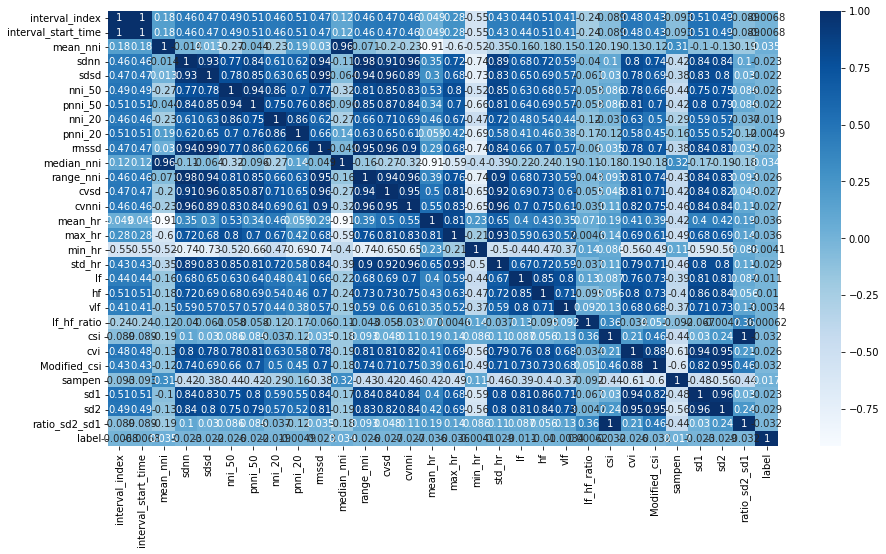

In [12]:
plt.figure(figsize=(15,8))
corr = df_session.corr()
sns.heatmap(corr, cmap="Blues", annot=True)

In [13]:
df_session.corr()

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
interval_index,1.000000,1.000000,0.177004,0.461243,0.467576,0.488822,0.509211,0.463277,0.514270,0.468234,...,0.410308,-0.235804,-0.089283,0.477597,0.430959,-0.093255,0.512121,0.489041,-0.089283,-0.006831
interval_start_time,1.000000,1.000000,0.177004,0.461243,0.467576,0.488822,0.509211,0.463277,0.514270,0.468234,...,0.410308,-0.235804,-0.089283,0.477597,0.430959,-0.093255,0.512121,0.489041,-0.089283,-0.006831
mean_nni,0.177004,0.177004,1.000000,-0.014382,0.013026,-0.271970,-0.044326,-0.234251,0.188252,0.030151,...,-0.148565,-0.116272,-0.186985,-0.133166,-0.121080,0.307813,-0.103546,-0.129059,-0.186985,0.035178
sdnn,0.461243,0.461243,-0.014382,1.000000,0.928752,0.765615,0.838231,0.607178,0.621616,0.944622,...,0.588084,-0.040183,0.099849,0.803080,0.744953,-0.416773,0.840994,0.835222,0.099849,-0.023114
sdsd,0.467576,0.467576,0.013026,0.928752,1.000000,0.781756,0.854551,0.628487,0.654192,0.994235,...,0.567448,-0.061269,0.029706,0.775910,0.686079,-0.375873,0.827658,0.795882,0.029706,-0.022436
nni_50,0.488822,0.488822,-0.271970,0.765615,0.781756,1.000000,0.937647,0.859093,0.703426,0.774354,...,0.570893,-0.058164,0.085721,0.782318,0.664551,-0.435772,0.752561,0.746093,0.085721,-0.026282
pnni_50,0.509211,0.509211,-0.044326,0.838231,0.854551,0.937647,1.000000,0.751430,0.760986,0.858937,...,0.574199,-0.058390,0.086053,0.813247,0.701380,-0.419185,0.796358,0.786124,0.086053,-0.021900
nni_20,0.463277,0.463277,-0.234251,0.607178,0.628487,0.859093,0.751430,1.000000,0.860916,0.616630,...,0.444877,-0.123296,-0.037221,0.626985,0.495444,-0.286979,0.585023,0.568530,-0.037221,-0.019114
pnni_20,0.514270,0.514270,0.188252,0.621616,0.654192,0.703426,0.760986,0.860916,1.000000,0.656237,...,0.378762,-0.168005,-0.115882,0.578987,0.448370,-0.164281,0.554653,0.522713,-0.115882,-0.004933
rmssd,0.468234,0.468234,0.030151,0.944622,0.994235,0.774354,0.858937,0.616630,0.656237,1.000000,...,0.572518,-0.059505,0.034819,0.782525,0.696895,-0.378465,0.835806,0.805724,0.034819,-0.022635


In [12]:
df_session.corr()['label']

interval_index        -0.006831
interval_start_time   -0.006831
mean_nni               0.035178
sdnn                  -0.023114
sdsd                  -0.022436
nni_50                -0.026282
pnni_50               -0.021900
nni_20                -0.019114
pnni_20               -0.004933
rmssd                 -0.022635
median_nni             0.033792
range_nni             -0.025752
cvsd                  -0.026610
cvnni                 -0.026705
mean_hr               -0.036151
max_hr                -0.035965
min_hr                -0.004124
std_hr                -0.028700
lf                    -0.011063
hf                    -0.009985
vlf                   -0.003356
lf_hf_ratio            0.000624
csi                   -0.031695
cvi                   -0.026346
Modified_csi          -0.031940
sampen                 0.016520
sd1                   -0.023446
sd2                   -0.029275
ratio_sd2_sd1         -0.031695
label                  1.000000
Name: label, dtype: float64

In [ ]:
sns.pairplot(df_session)

Exception ignored in: <function TransformNode.set_children.<locals>.<lambda> at 0x7fd56ad33048>
Traceback (most recent call last):
  File "/home/aura-sakhite/.local/lib/python3.6/site-packages/matplotlib/transforms.py", line 200, in <lambda>
    self, lambda _, pop=child._parents.pop, k=id(self): pop(k))
KeyboardInterrupt


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7fd5bf423b70> (for post_execute):


ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.6/site-packages/IPython/core/events.py", line 88, in trigger
    func(*args, **kwargs)
  File "/usr/local/lib/python3.6/site-packages/ipykernel/pylab/backend_inline.py", line 121, in flush_figures
    return show(True)
  File "/usr/local/lib/python3.6/site-packages/ipykernel/pylab/backend_inline.py", line 43, in show
    metadata=_fetch_figure_metadata(figure_manager.canvas.figure)
  File "/usr/local/lib/python3.6/site-packages/IPython/core/display.py", line 313, in display
    format_dict, md_dict = format(obj, include=include, exclude=exclude)
  File "/usr/local/lib/python3.6/site-packages/IPython/core/formatters.py", line 180, in format
    data = formatter(obj)
  File "<decorator-gen-9>", line 2, in __call__
  File "/usr/local/lib/python3.6/site-packages/IPython/core/formatters.py", line 224, in catch_format_error
    r = method(self, *args, **kwargs)
  File "/usr/local/lib/python3.6/site-packages/IPython/core/format

In [15]:
#session start
df_session['timestamp'].iloc[0]

'2017-02-13 15:28:19.750'

In [16]:
#session end
df_session['timestamp'].iloc[-1]

'2017-02-14 08:36:03.750'

In [17]:
#session duration : since time between row is 1sec
df_session.shape[0]

61665

In [18]:
#session in hour
df_session.shape[0]/3600

17.129166666666666

In [19]:
#total_seizure_duration_sec
df_session[df_session['label']==1].label.sum()

204

In [20]:
#total_interseizure_duration_sec
(df_session['label'] == 0).sum()    

61461

In [13]:
## Analysis of seizures inside session ##
# Detect change of state
df_session['previous_label'] = df_session['label'].shift(1)
df_session['change_of_state'] = (df_session['label'] != df_session['previous_label'])
df_session['change_of_state'].value_counts()
df_session['future_change_of_state'] = df_session['change_of_state'].shift(-1).fillna(True)

In [14]:
df_session_copy = df_session.set_index("timestamp")

### Seizure informations from session

In [15]:
df_seizure = pd.DataFrame()
df_seizure['start_date'] = df_session.loc[(df_session['label']==1) 
                                               & (df_session['change_of_state']), 'timestamp'].reset_index(
        drop=True)
df_seizure['end_date'] = df_session.loc[(df_session['label']==1) 
                                             &(df_session['future_change_of_state']),'timestamp'].reset_index(
        drop=True)

df_seizure['duration_sec'] = (pd.to_datetime(df_seizure['end_date']) 
                                 - pd.to_datetime(df_seizure['start_date'])).apply(
        lambda x : x.total_seconds() + 1)
    

In [16]:
df_seizure.head()

,start_date,end_date,duration_sec
0,2017-02-13 16:10:05.750,2017-02-13 16:10:09.750,5.0
1,2017-02-13 16:15:41.750,2017-02-13 16:15:45.750,5.0
2,2017-02-13 16:19:10.750,2017-02-13 16:19:14.750,5.0
3,2017-02-13 16:25:50.750,2017-02-13 16:25:53.750,4.0
4,2017-02-13 16:26:37.750,2017-02-13 16:26:39.750,3.0


In [17]:
df_seizure.describe()

,duration_sec
count,28.000000
mean,7.285714
std,13.103172
min,1.000000
25%,3.000000
50%,4.500000
75%,6.250000
max,73.000000


<AxesSubplot:title={'center':'Duree des seizure du patient 18'}>

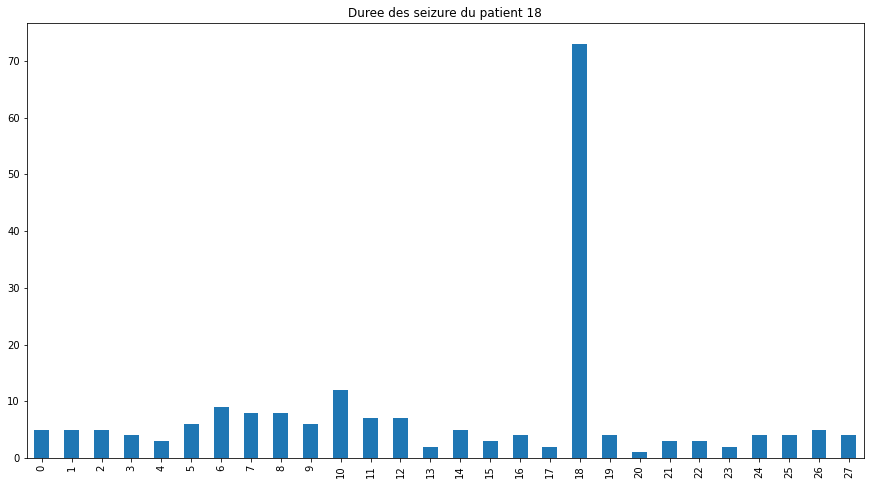

In [18]:
plt.figure(figsize=(15,8))
df_seizure.duration_sec.plot(kind="bar", title="Duree des seizure du patient 18")

In [21]:
result = {}
for index, row in df_seizure.iterrows():
    result[index]=df_session_copy.loc[row['start_date']:row['end_date']]

In [22]:
result[0]

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,filename,label,previous_label,change_of_state,future_change_of_state
timestamp,,,,,,,,,,,,,,,,,,,,,
2017-02-13 16:10:05.750,2507.0,2507000.0,893.821023,87.098307,47.407458,4.0,40.000000,8.0,80.000000,48.111935,...,827.891144,1.365241,25.560701,72.734926,2.845576,/home/aura-sakhite/seizure_detection_pipeline/...,1,0.0,True,False
2017-02-13 16:10:06.750,2508.0,2508000.0,893.465909,87.015450,54.064532,5.0,50.000000,9.0,90.000000,54.070176,...,818.425867,1.427116,26.336085,73.406630,2.787302,/home/aura-sakhite/seizure_detection_pipeline/...,1,1.0,False,False
2017-02-13 16:10:07.750,2509.0,2509000.0,892.755682,86.827136,48.015106,4.0,40.000000,8.0,80.000000,48.710797,...,836.869153,1.406914,26.249213,74.106607,2.823193,/home/aura-sakhite/seizure_detection_pipeline/...,1,1.0,False,False
2017-02-13 16:10:08.750,2510.0,2510000.0,890.625000,84.396699,51.372757,5.0,50.000000,8.0,80.000000,51.586169,...,873.472933,1.365241,26.623757,76.248166,2.863915,/home/aura-sakhite/seizure_detection_pipeline/...,1,1.0,False,False
2017-02-13 16:10:09.750,2511.0,2511000.0,887.695312,73.949590,49.581291,5.0,45.454545,8.0,72.727273,50.038271,...,912.093981,1.408767,26.762229,78.117969,2.918963,/home/aura-sakhite/seizure_detection_pipeline/...,1,1.0,False,True


In [ ]:
sns.boxplot(x=, y=i, data=describe_num_df)

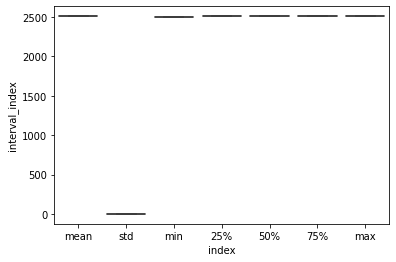

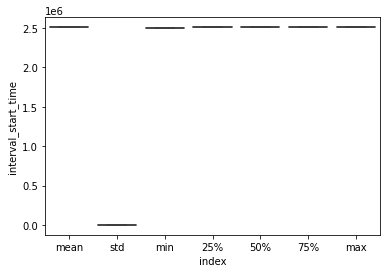

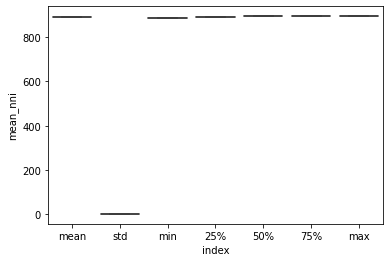

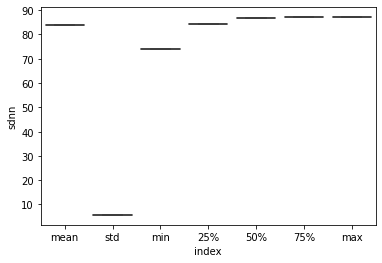

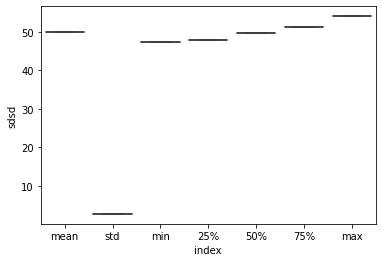

...

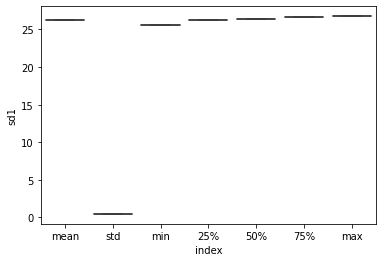

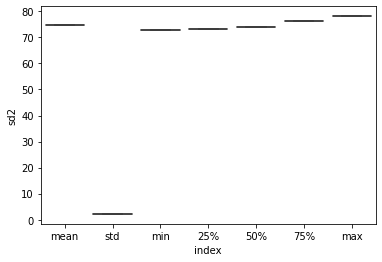

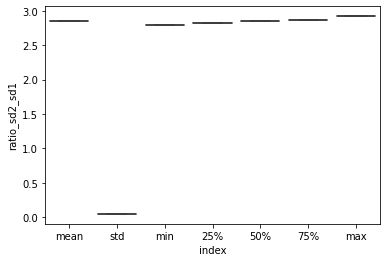

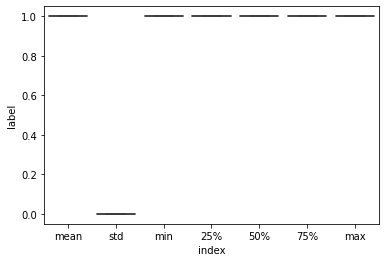

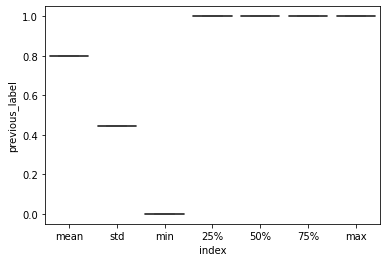

In [20]:
plt.figure(figsize=(25,5))
plt.subplot(1,4,1)
sns.boxplot(x='label',y='sdnn', data=result[0])
plt.subplot(1,4,2)
sns.boxplot(x='label',y='sdsd', data=result[0])
plt.subplot(1,4,3)
sns.boxplot(x='label',y='mean_hr', data=result[0])
plt.subplot(1,4,4)
sns.boxplot(x='label',y='std_hr', data=result[0]);

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



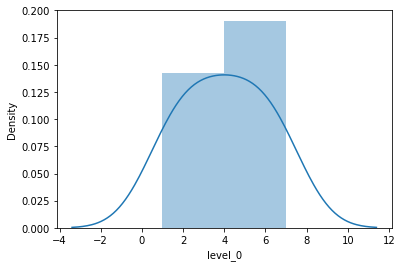

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



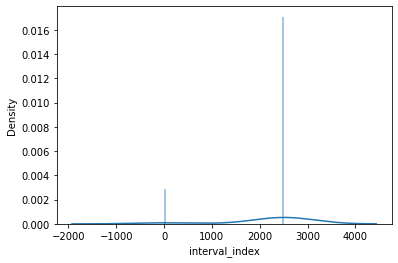

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



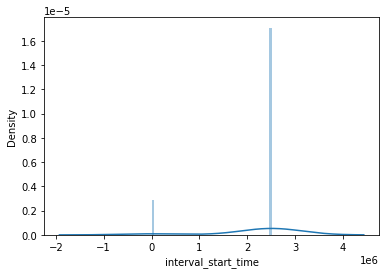

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



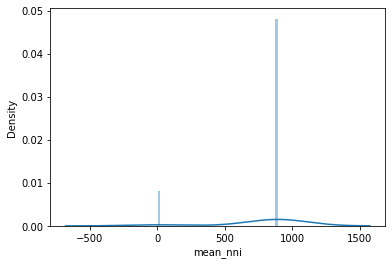

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



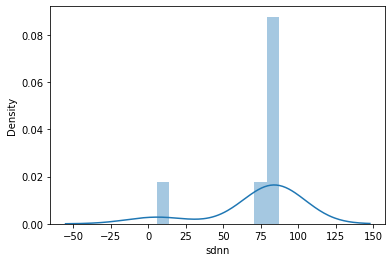

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



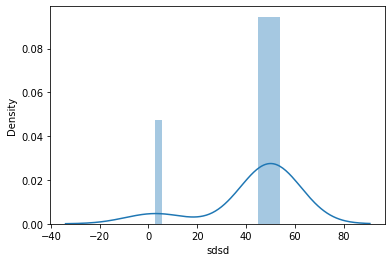

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



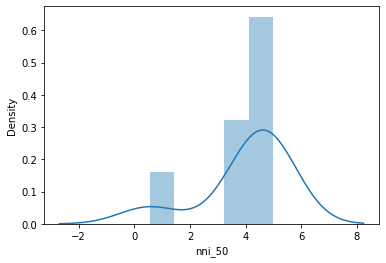

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



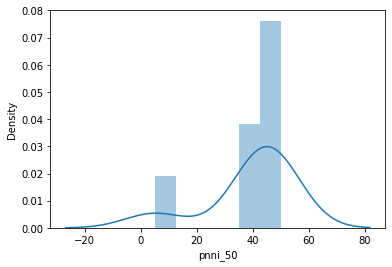

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



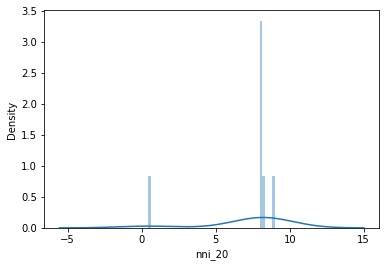

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



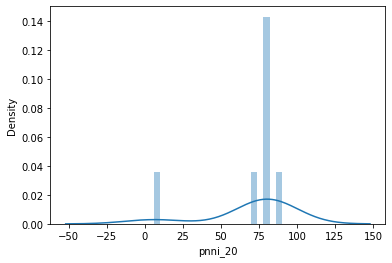

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



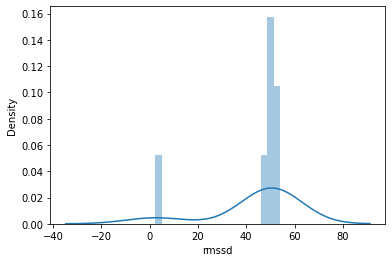

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



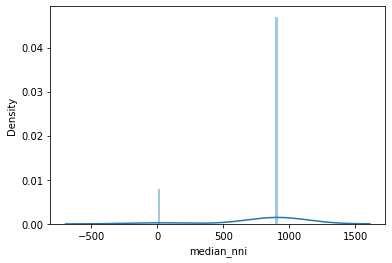

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



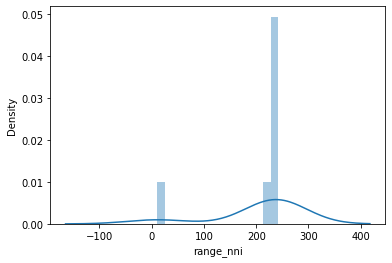

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



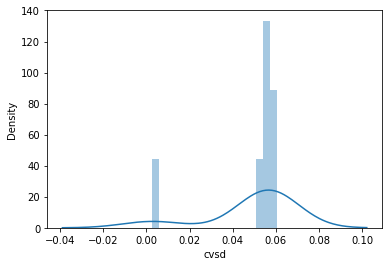

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



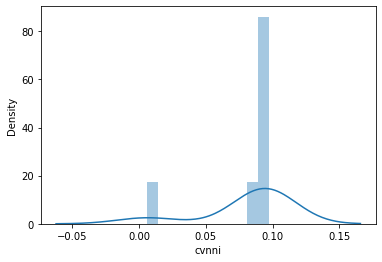

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



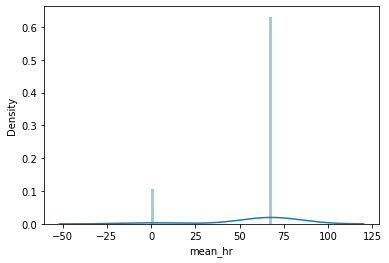

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



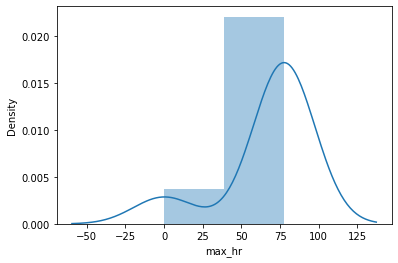

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



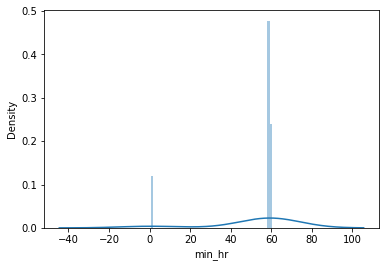

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



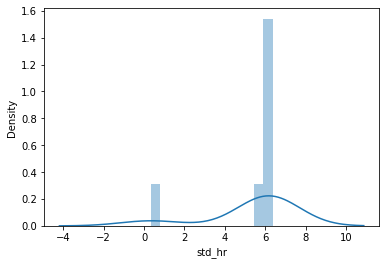

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



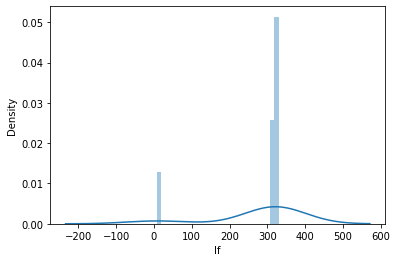

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



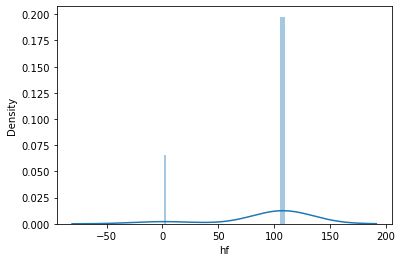

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



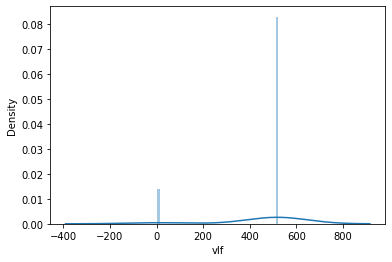

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



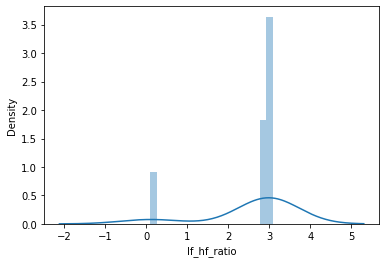

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



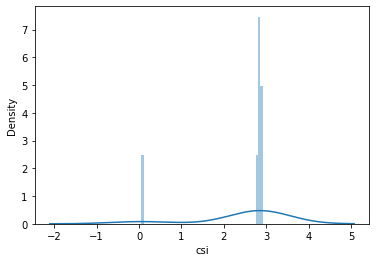

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



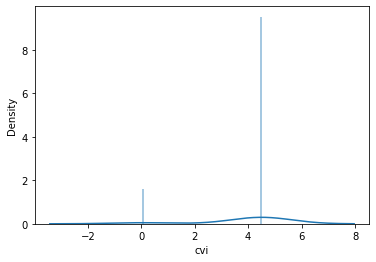

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



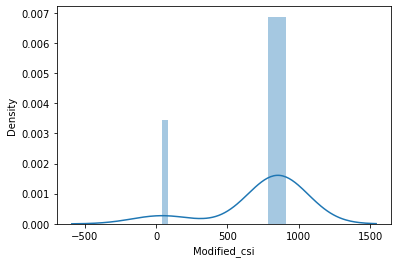

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



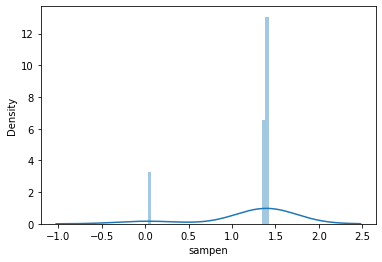

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



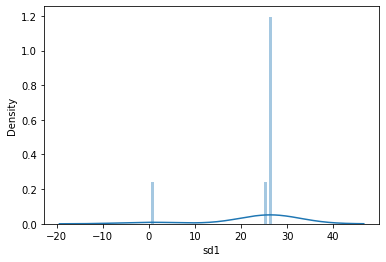

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



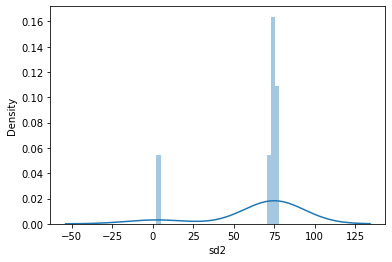

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



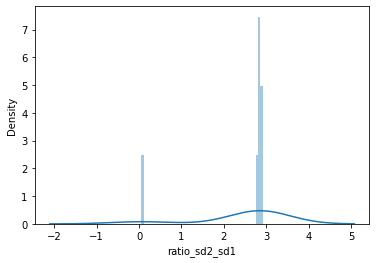

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



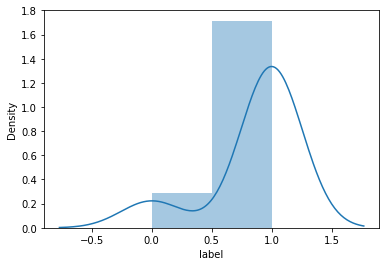

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



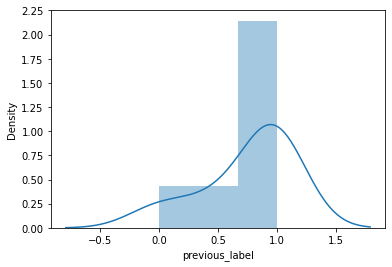

In [30]:
result[0].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = result[0][result[0]['index'] != 'count']
for i in result[0].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

In [31]:
result[18]

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label,previous_label
count,73.000000,7.300000e+01,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,...,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.0,73.000000
mean,37285.000000,3.728500e+07,918.230869,31.720061,32.223718,1.438356,14.678290,6.000000,60.433098,32.659275,...,1.327152,1.701935,4.236893,292.471668,1.579075,25.269641,42.792498,1.701935,1.0,0.986301
std,21.217131,2.121713e+04,16.018693,5.924548,4.597985,1.142443,11.690303,1.130388,10.308702,4.588954,...,0.118329,0.163659,0.020073,40.721186,0.290895,1.436981,2.035069,0.163659,0.0,0.117041
min,37249.000000,3.724900e+07,887.044271,19.085830,21.338282,0.000000,0.000000,3.000000,33.333333,21.466612,...,1.188363,1.464782,4.203543,225.212957,1.223775,22.670784,38.437954,1.464782,1.0,0.000000
25%,37267.000000,3.726700e+07,908.380682,27.088910,29.648926,1.000000,9.090909,5.000000,50.000000,30.055288,...,1.246216,1.544634,4.221859,256.871124,1.386294,24.123551,41.158628,1.544634,1.0,1.000000
50%,37285.000000,3.728500e+07,914.417614,31.071936,31.880840,1.000000,11.111111,6.000000,60.000000,32.282740,...,1.280799,1.643850,4.232105,283.099465,1.446919,25.568054,43.281545,1.643850,1.0,1.000000
75%,37303.000000,3.730300e+07,928.125000,37.485941,34.992438,2.000000,20.000000,7.000000,70.000000,35.415709,...,1.363267,1.832675,4.256394,327.065611,1.871802,26.379496,44.458207,1.832675,1.0,1.000000
max,37321.000000,3.732100e+07,951.349432,41.715466,41.782270,4.000000,40.000000,8.000000,80.000000,41.871647,...,1.590473,1.998989,4.288192,368.839879,2.639057,27.392424,46.216960,1.998989,1.0,1.000000


/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



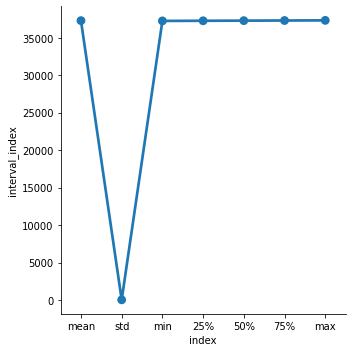

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



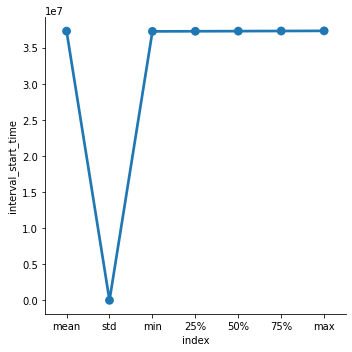

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



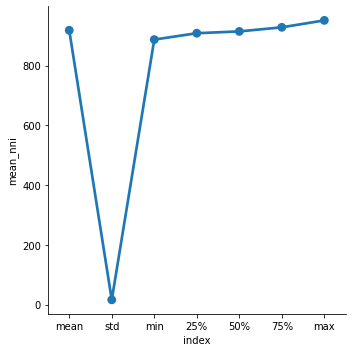

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



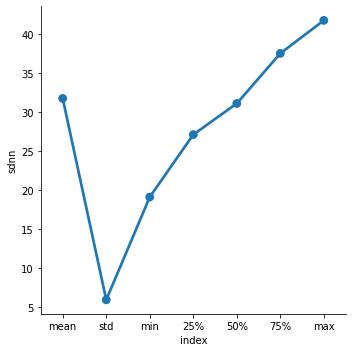

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



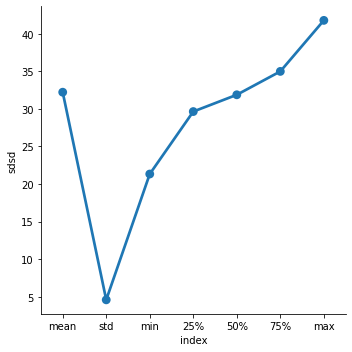

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



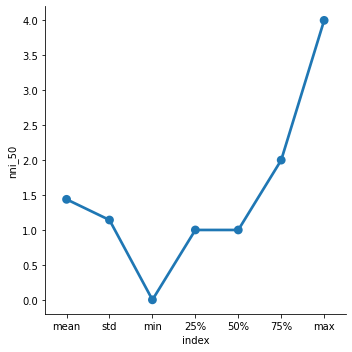

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



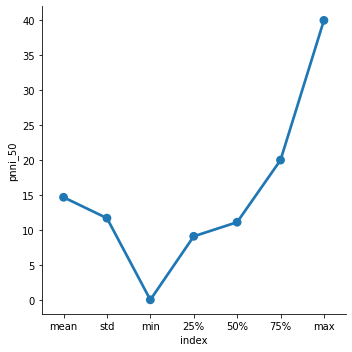

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



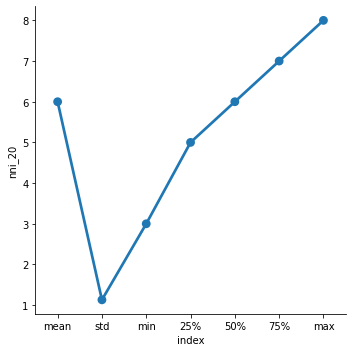

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



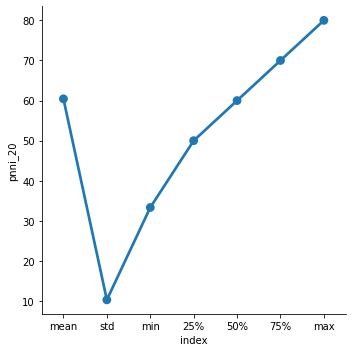

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



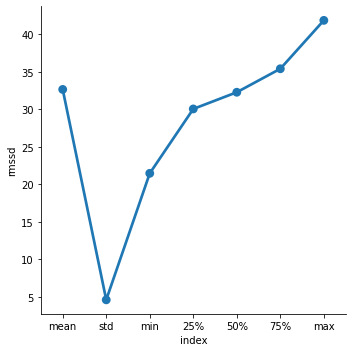

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



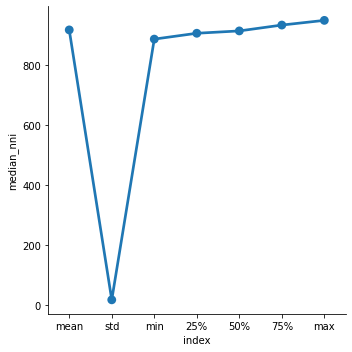

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



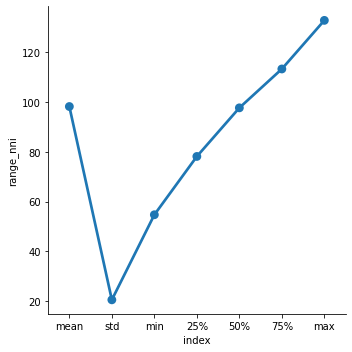

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



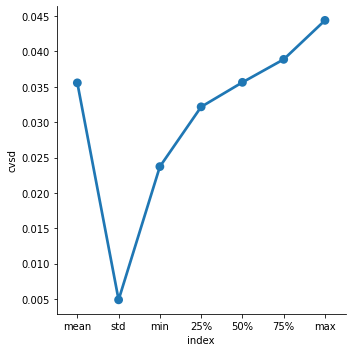

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



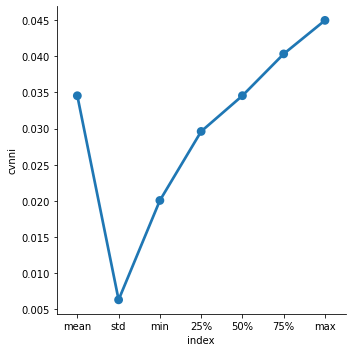

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



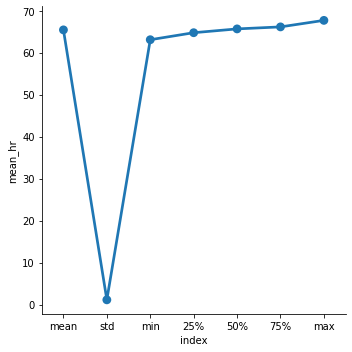

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



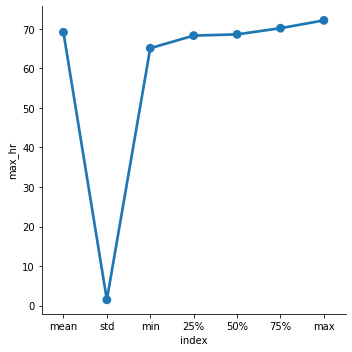

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



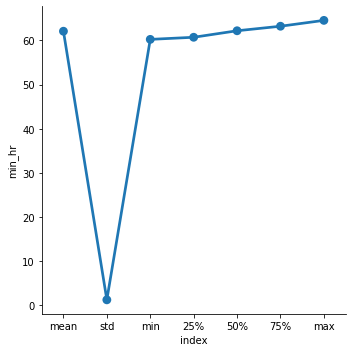

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



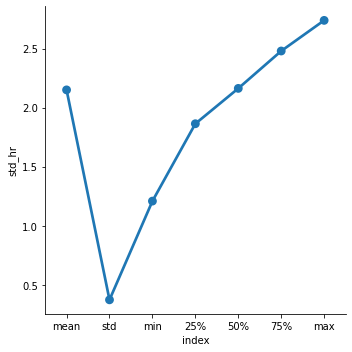

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



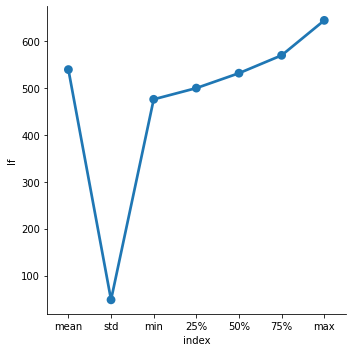

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



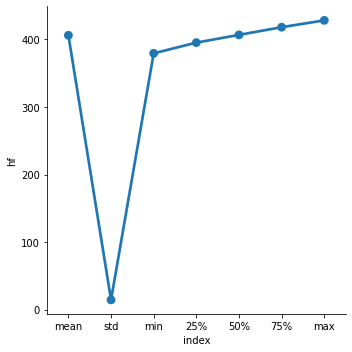

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



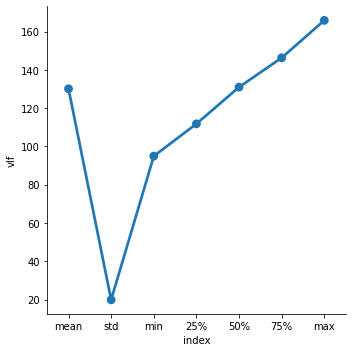

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



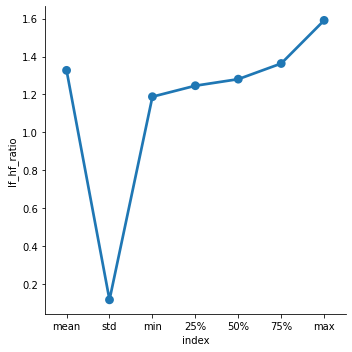

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



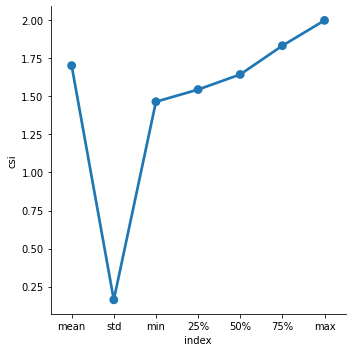

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



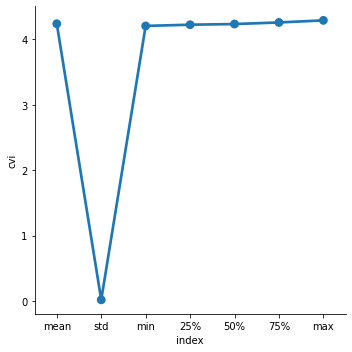

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



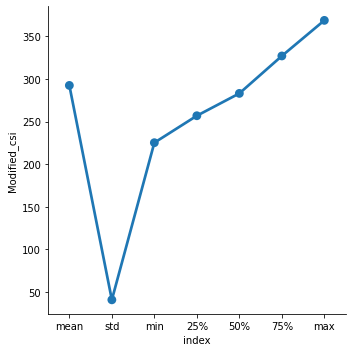

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



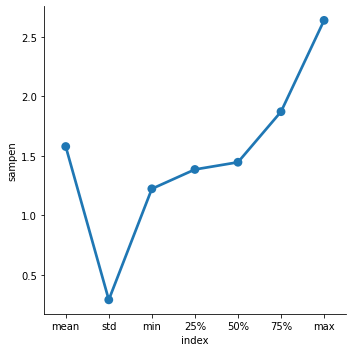

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



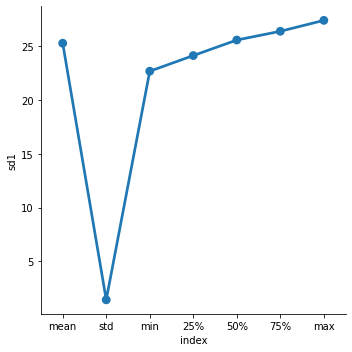

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



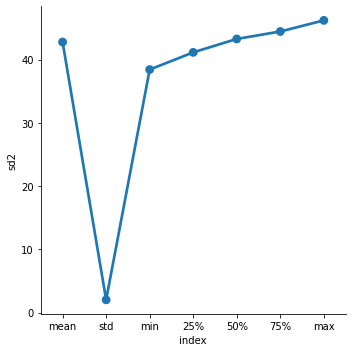

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



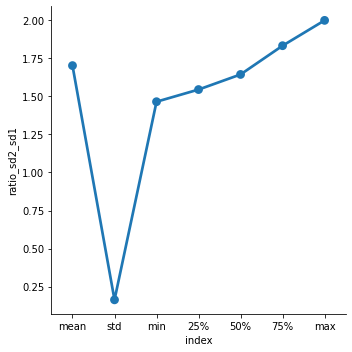

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



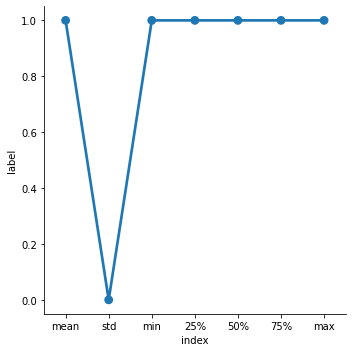

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



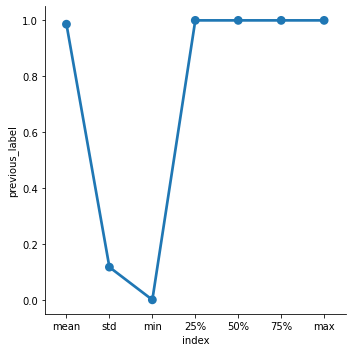

In [32]:
result[18].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = result[18][result[18]['index'] != 'count']
for i in result[18].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



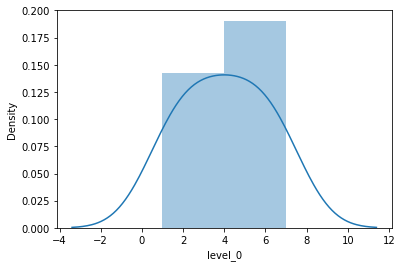

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



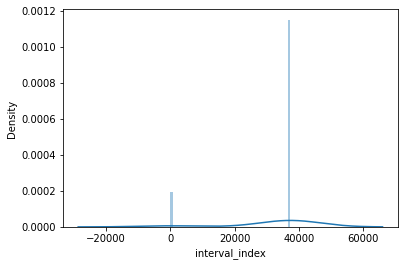

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



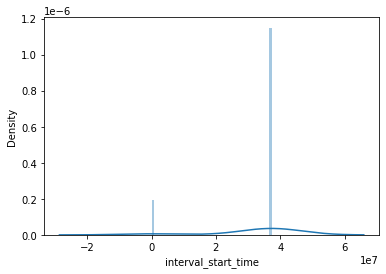

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



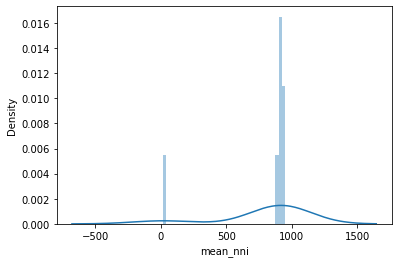

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



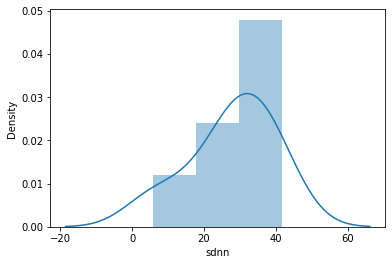

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



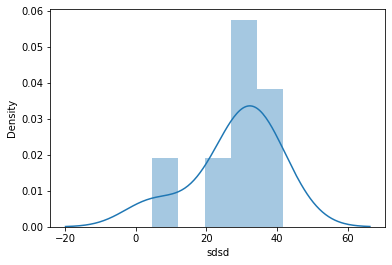

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



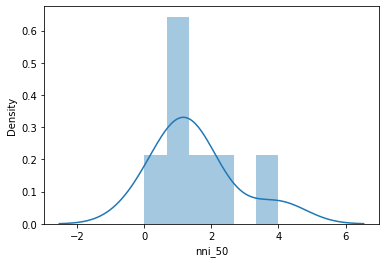

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



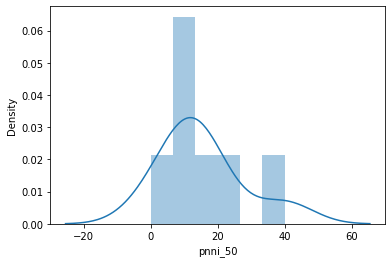

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



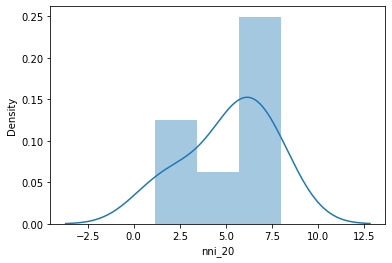

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



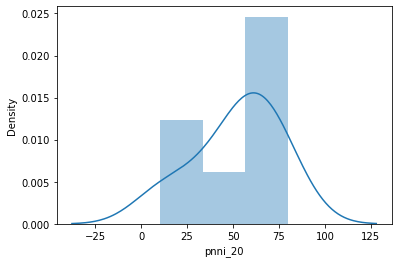

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



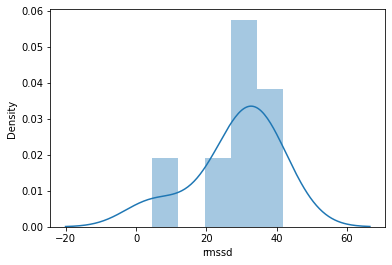

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



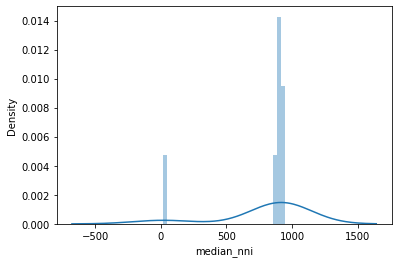

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



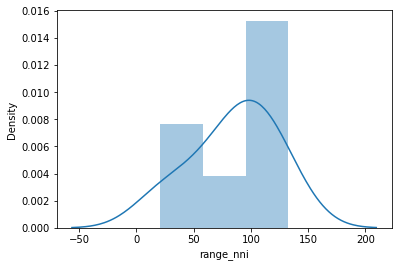

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



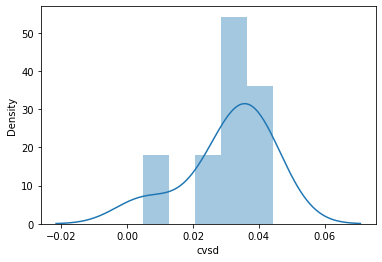

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



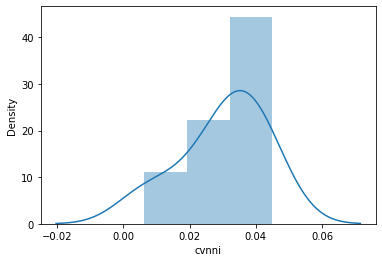

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



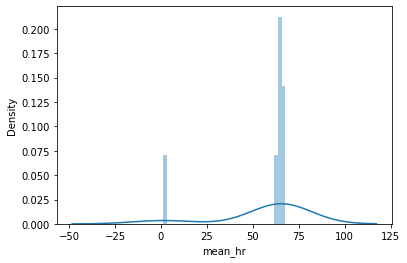

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



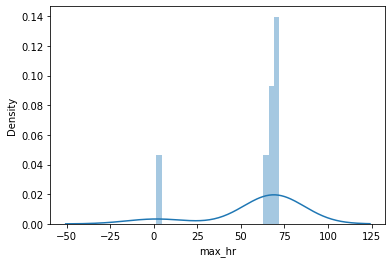

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



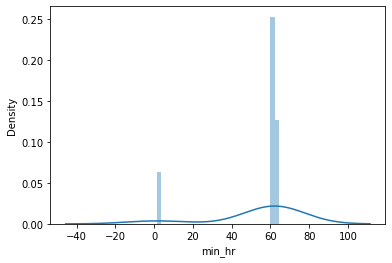

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



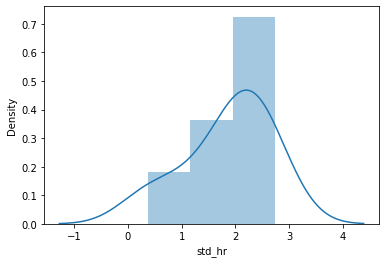

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



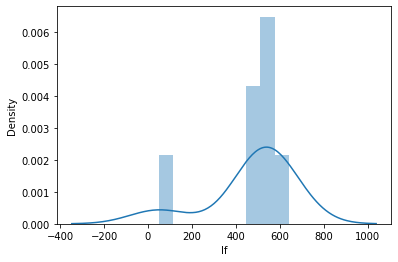

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



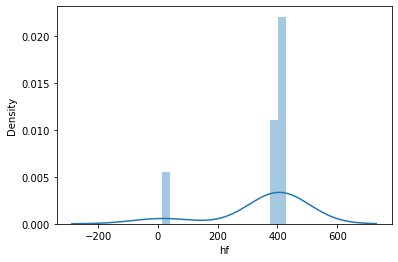

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



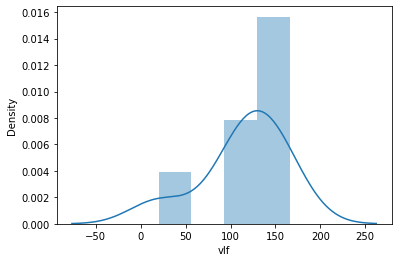

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



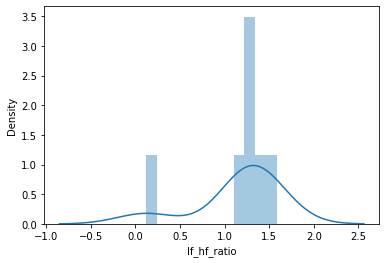

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



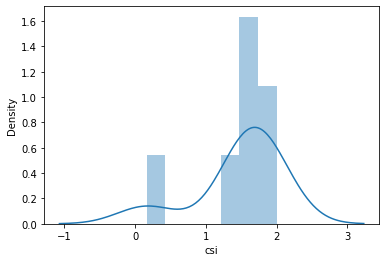

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



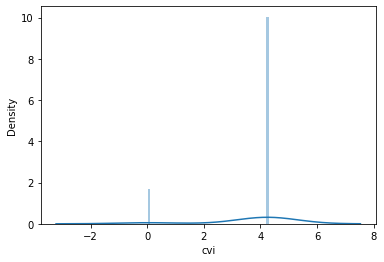

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



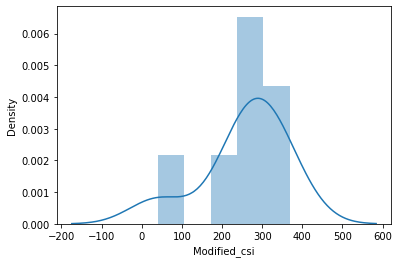

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



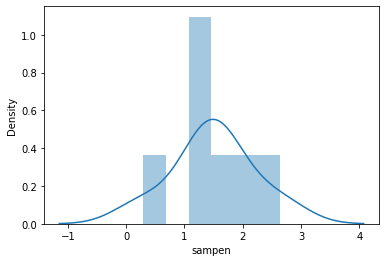

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



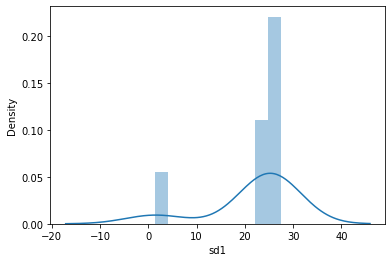

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



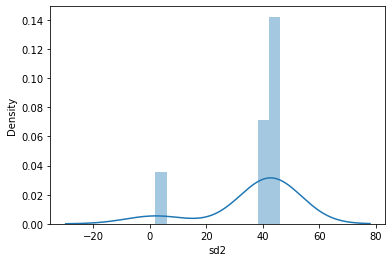

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



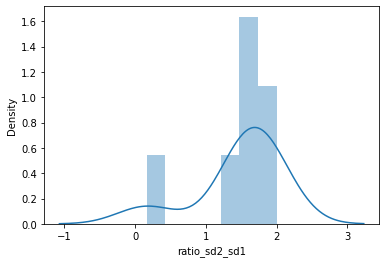

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



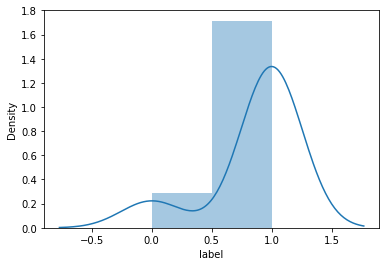

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



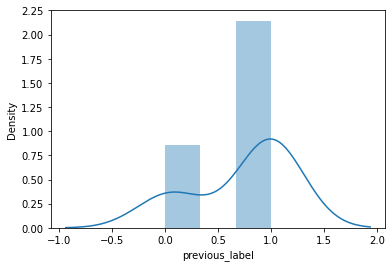

In [33]:
result[18].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = result[18][result[18]['index'] != 'count']
for i in result[18].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

In [34]:
result[4]

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label,previous_label
count,3.0,3.0,3.000000,3.000000,3.000000,3.0,3.0,3.000000,3.000000,3.000000,...,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.0,3.000000
mean,3500.0,3500000.0,864.938447,16.054302,17.855309,0.0,0.0,2.333333,23.333333,18.013015,...,3.459009,2.469002,4.329623,567.030362,1.448197,23.253781,57.414087,2.469002,1.0,0.666667
std,1.0,1000.0,2.848298,3.666988,2.083530,0.0,0.0,0.577350,5.773503,2.322263,...,0.094638,0.007913,0.004541,5.703305,0.006546,0.084464,0.392823,0.007913,0.0,0.577350
min,3499.0,3499000.0,862.215909,13.765407,15.991789,0.0,0.0,2.000000,20.000000,16.010861,...,3.373320,2.463638,4.326675,563.251801,1.442384,23.200052,57.156519,2.463638,1.0,0.000000
25%,3499.5,3499500.0,863.458807,13.939554,16.730535,0.0,0.0,2.000000,20.000000,16.740071,...,3.408222,2.464459,4.327008,563.750152,1.444651,23.205103,57.188021,2.464459,1.0,0.500000
50%,3500.0,3500000.0,864.701705,14.113701,17.469281,0.0,0.0,2.000000,20.000000,17.469281,...,3.443124,2.465280,4.327342,564.248503,1.446919,23.210155,57.219523,2.465280,1.0,1.000000
75%,3500.5,3500500.0,866.299716,17.198749,18.787070,0.0,0.0,2.500000,25.000000,19.014092,...,3.501854,2.471685,4.331098,568.919642,1.451103,23.280646,57.542871,2.471685,1.0,1.000000
max,3501.0,3501000.0,867.897727,20.283797,20.104858,0.0,0.0,3.000000,30.000000,20.558902,...,3.560585,2.478090,4.334853,573.590781,1.455287,23.351138,57.866219,2.478090,1.0,1.000000


/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



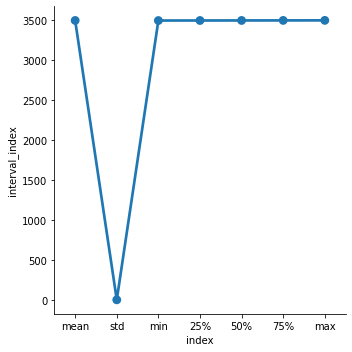

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



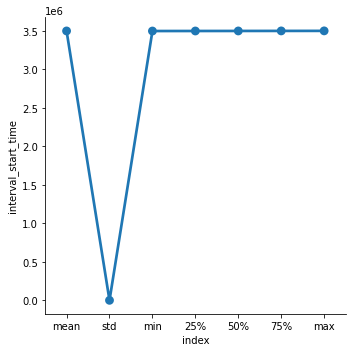

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



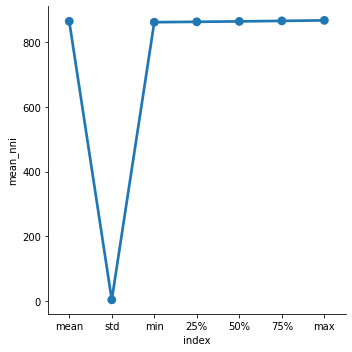

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



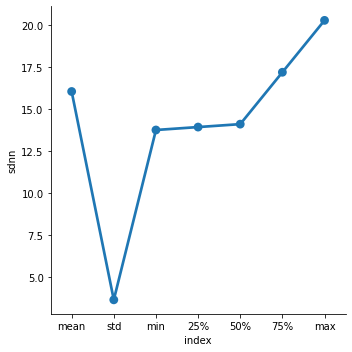

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



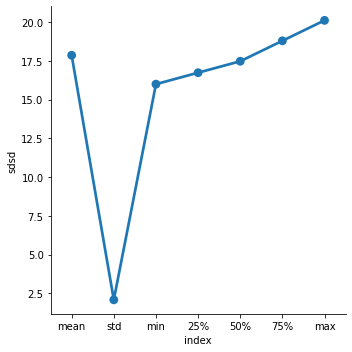

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



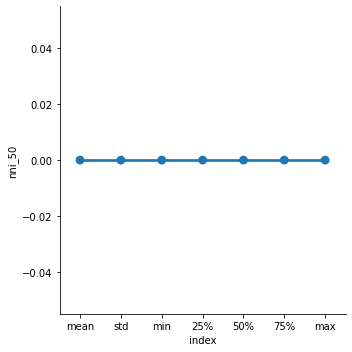

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



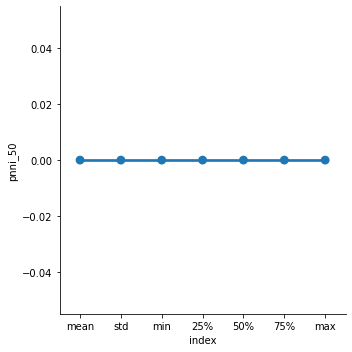

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



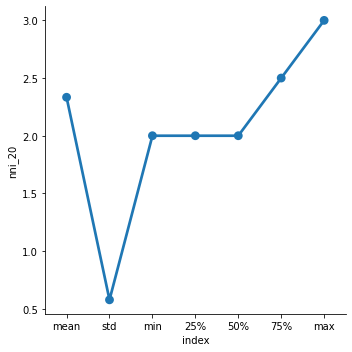

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



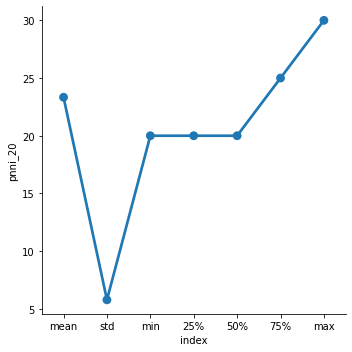

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



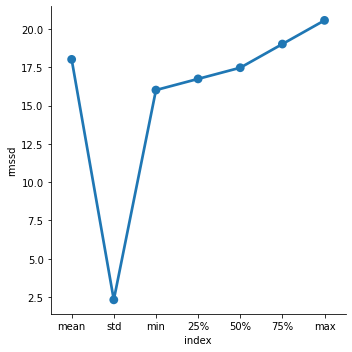

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



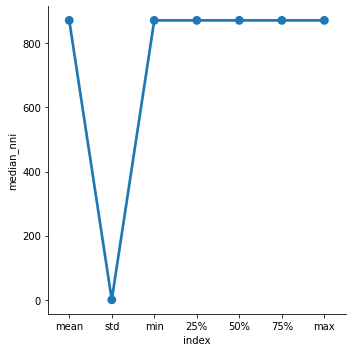

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



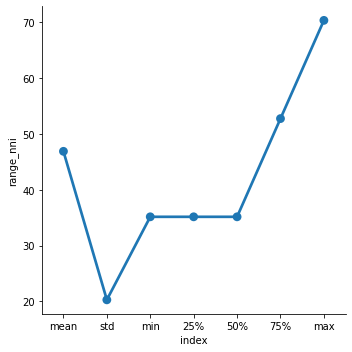

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



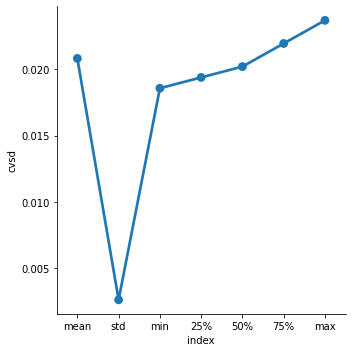

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



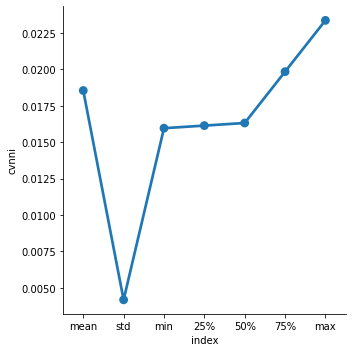

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



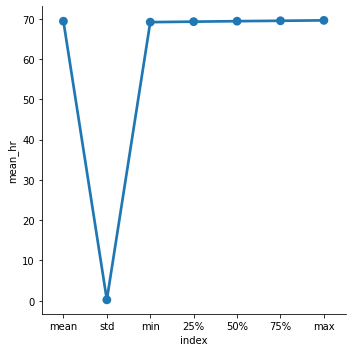

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



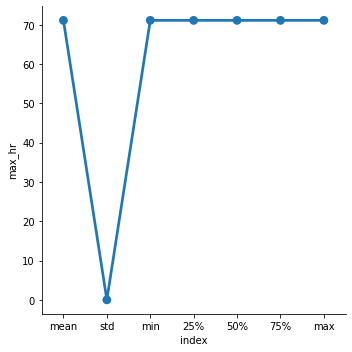

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



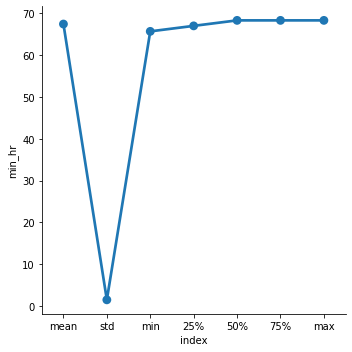

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



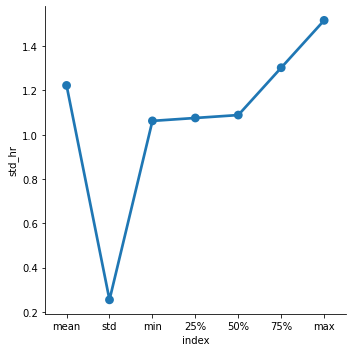

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



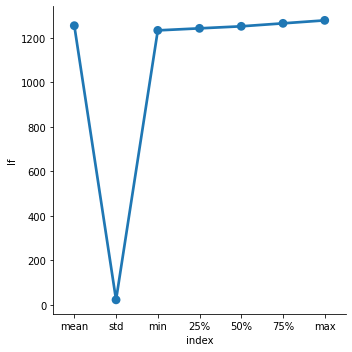

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



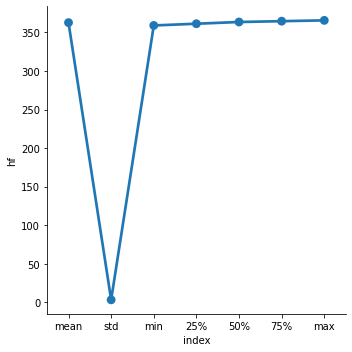

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



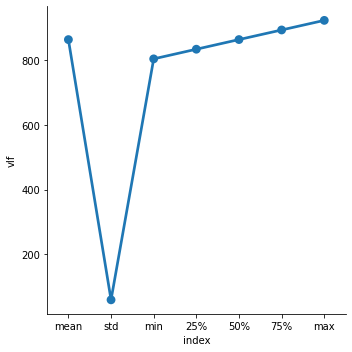

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



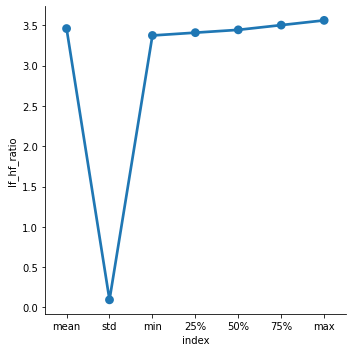

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



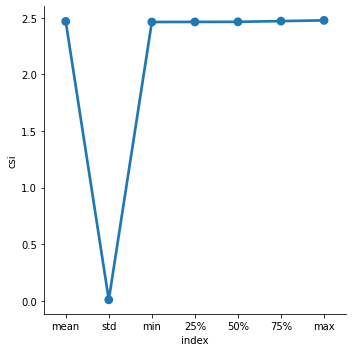

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



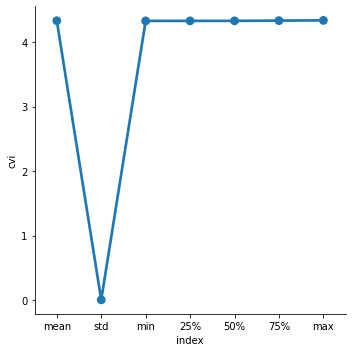

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



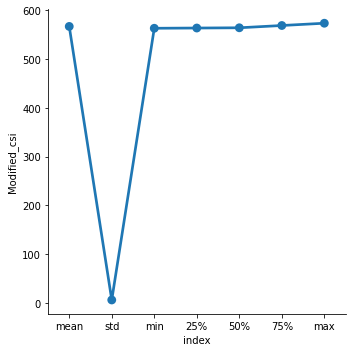

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



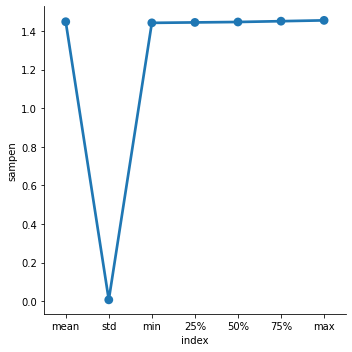

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



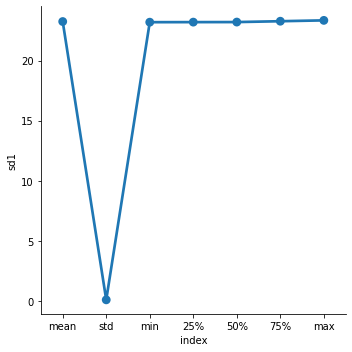

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



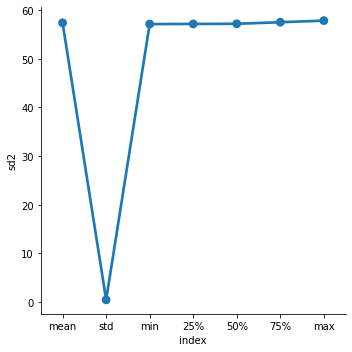

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



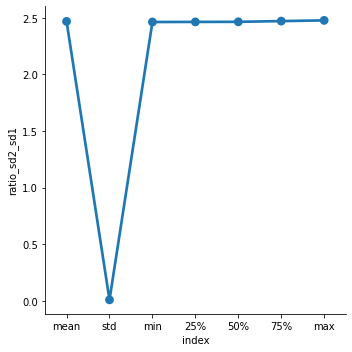

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



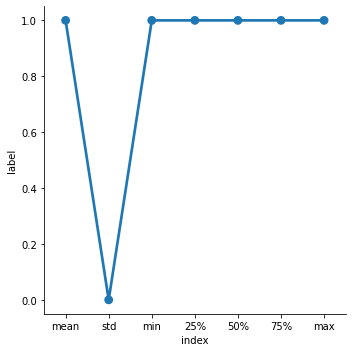

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



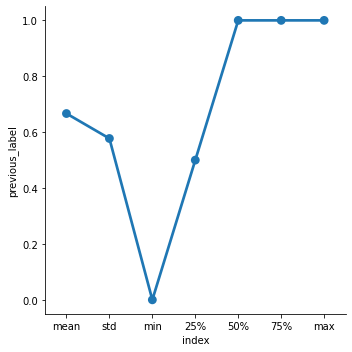

In [35]:
result[4].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = result[4][result[4]['index'] != 'count']
for i in result[4].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



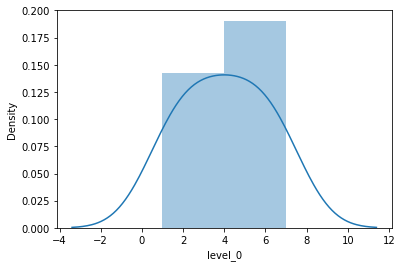

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



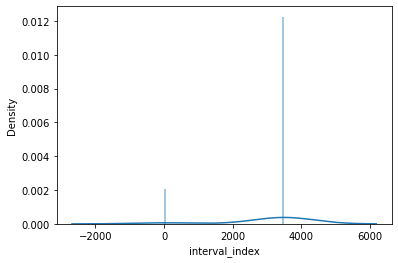

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



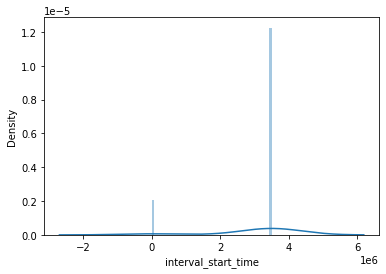

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



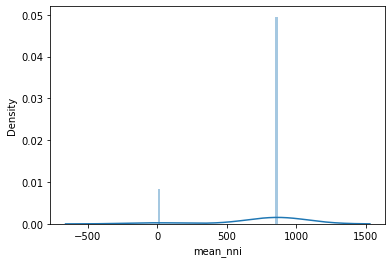

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



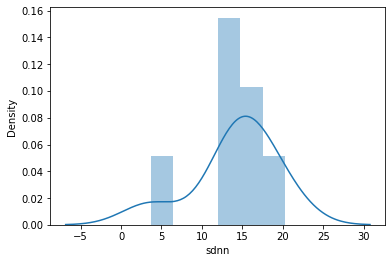

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



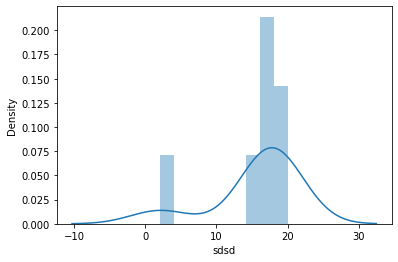

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



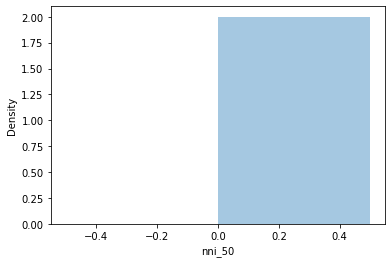

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



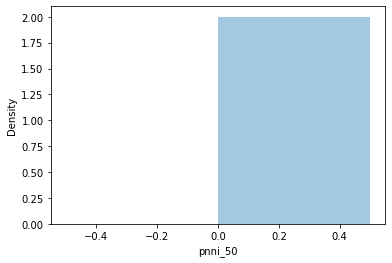

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



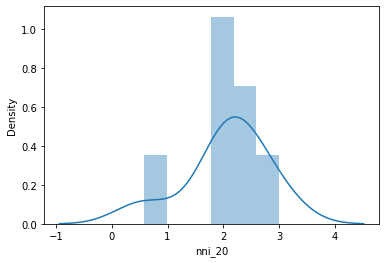

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



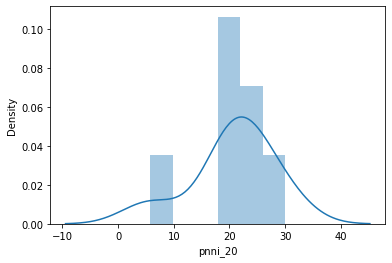

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



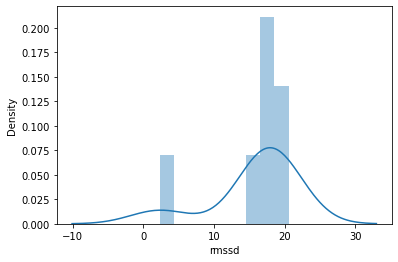

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



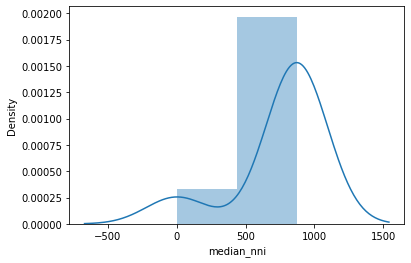

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



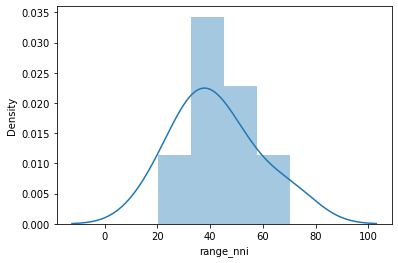

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



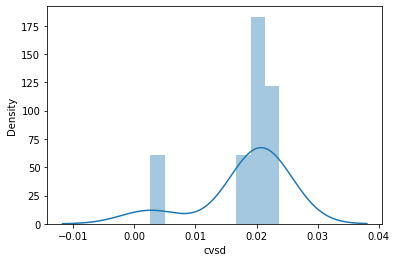

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



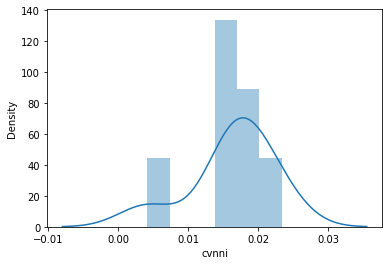

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



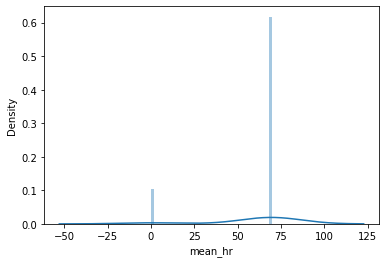

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



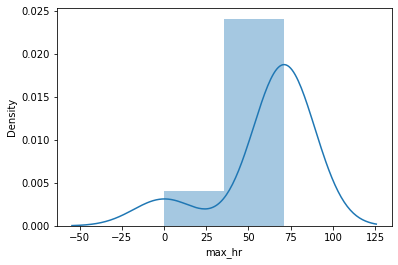

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



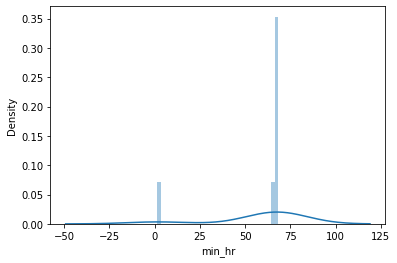

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



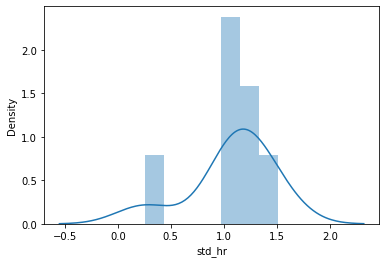

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



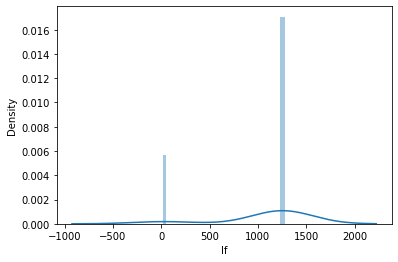

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



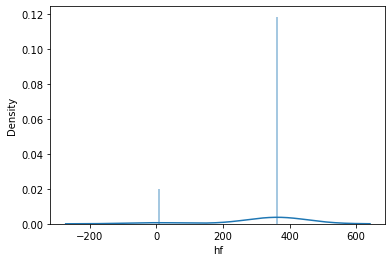

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



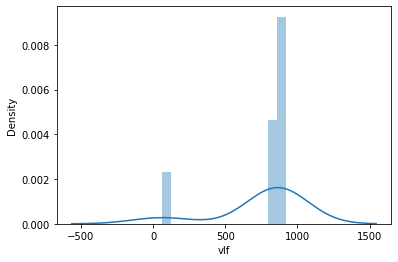

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



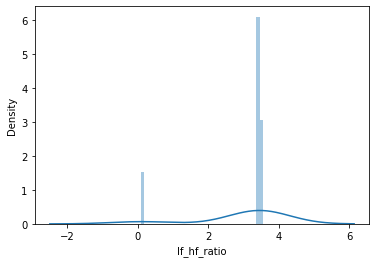

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



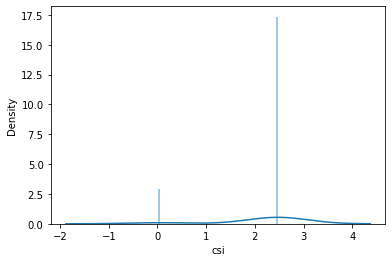

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



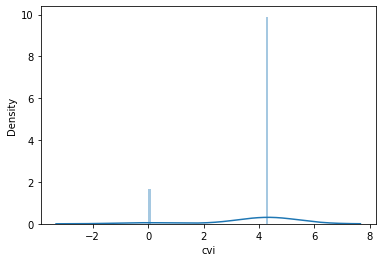

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



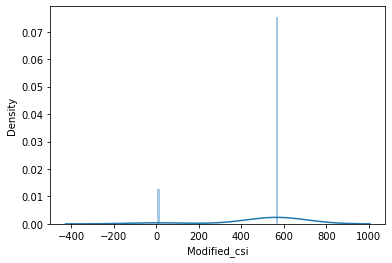

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



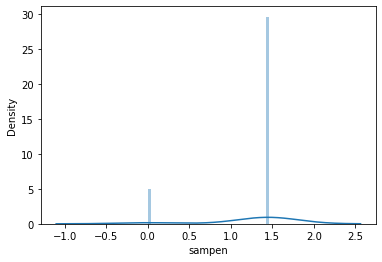

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



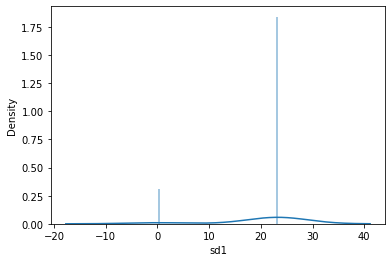

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



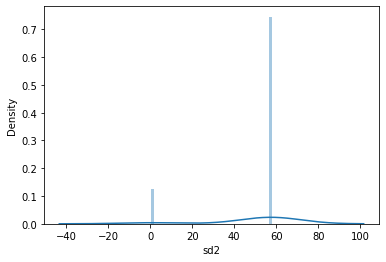

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



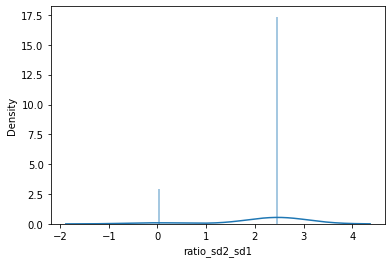

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



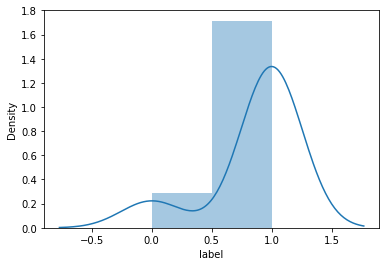

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



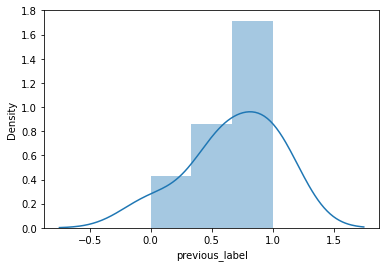

In [36]:
result[4].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = result[4][result[4]['index'] != 'count']
for i in result[4].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

In [37]:
result[6]

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label,previous_label
count,9.000000,9.000000e+00,9.000000,9.000000,9.000000,9.0,9.0,9.000000,9.000000,9.000000,...,9.000000,9.000000,9.000000,9.000000,9.000000,9.000000,9.000000,9.000000,9.0,9.000000
mean,14815.000000,1.481500e+07,720.796131,21.368192,21.226600,0.0,0.0,6.222222,47.863248,21.370087,...,5.636245,2.158116,4.656696,675.299106,0.986959,36.245764,78.223860,2.158116,1.0,0.888889
std,2.738613,2.738613e+03,4.722743,2.381008,1.357214,0.0,0.0,0.971825,7.475579,1.343611,...,0.211493,0.013449,0.005753,10.546276,0.008543,0.140895,0.747360,0.013449,0.0,0.333333
min,14811.000000,1.481100e+07,714.285714,17.178913,19.230769,0.0,0.0,5.000000,38.461538,19.289368,...,5.240754,2.135347,4.645575,656.130267,0.971576,35.974363,76.817753,2.135347,1.0,0.000000
25%,14813.000000,1.481300e+07,717.912946,20.961937,20.748409,0.0,0.0,6.000000,46.153846,20.783193,...,5.493043,2.145693,4.654708,665.849072,0.979513,36.292486,77.738239,2.145693,1.0,1.000000
50%,14815.000000,1.481500e+07,718.191964,21.605979,21.033654,0.0,0.0,6.000000,46.153846,21.340482,...,5.704129,2.165668,4.659576,681.588751,0.989809,36.303926,78.639288,2.165668,1.0,1.000000
75%,14817.000000,1.481700e+07,724.888393,23.006059,21.742852,0.0,0.0,7.000000,53.846154,21.883583,...,5.805345,2.167742,4.660634,682.963273,0.992480,36.334746,78.764359,2.167742,1.0,1.000000
max,14819.000000,1.481900e+07,727.678571,24.163160,23.468298,0.0,0.0,8.000000,61.538462,23.537447,...,5.839954,2.170165,4.661019,683.999859,0.996949,36.339930,78.800720,2.170165,1.0,1.000000


In [38]:
result[10]

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label,previous_label
count,12.000000,1.200000e+01,12.000000,12.000000,12.000000,12.0,12.0,12.000000,12.000000,12.000000,...,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.000000,12.0,12.000000
mean,18624.500000,1.862450e+07,628.229677,20.486608,14.571738,0.0,0.0,3.666667,24.310516,14.976190,...,1.896134,2.370713,4.749044,866.989713,0.814977,38.478826,91.278070,2.370713,1.0,0.916667
std,3.605551,3.605551e+03,9.789826,4.760528,2.323364,0.0,0.0,1.723281,11.290525,2.236833,...,0.176018,0.078804,0.032341,76.218797,0.025181,0.823452,4.935805,0.078804,0.0,0.288675
min,18619.000000,1.861900e+07,616.699219,12.906398,10.718289,0.0,0.0,1.000000,6.666667,11.321388,...,1.675796,2.299625,4.716107,796.670283,0.769520,37.576698,86.510460,2.299625,1.0,0.000000
25%,18621.750000,1.862175e+07,619.959214,17.180612,13.368041,0.0,0.0,2.500000,16.785714,13.834615,...,1.756895,2.308089,4.721709,804.884659,0.795681,37.773969,87.180838,2.308089,1.0,1.000000
50%,18624.500000,1.862450e+07,628.417969,20.875774,15.961076,0.0,0.0,4.500000,28.958333,16.046449,...,1.884828,2.323281,4.732225,822.744841,0.818407,38.106726,88.532627,2.323281,1.0,1.000000
75%,18627.250000,1.862725e+07,632.873535,23.502922,16.210797,0.0,0.0,5.000000,33.333333,16.595769,...,2.009388,2.423718,4.784270,930.863198,0.835223,39.426791,96.010414,2.423718,1.0,1.000000
max,18630.000000,1.863000e+07,646.728516,27.639767,16.540046,0.0,0.0,5.000000,33.333333,17.264270,...,2.195936,2.503256,4.794051,988.060559,0.851752,39.652125,98.677520,2.503256,1.0,1.000000


/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



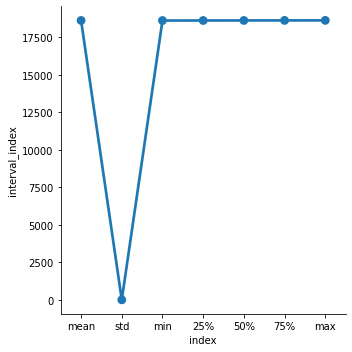

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



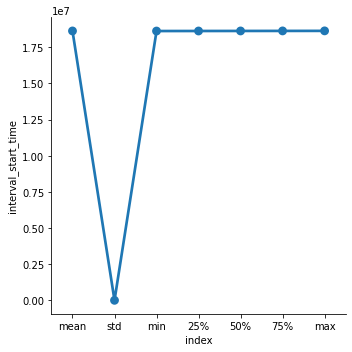

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



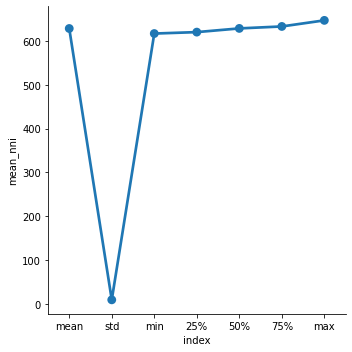

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



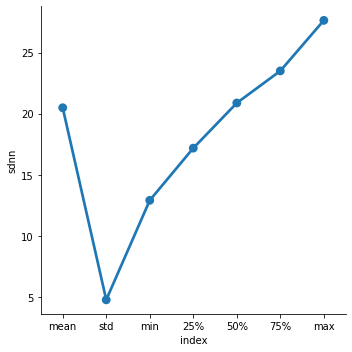

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



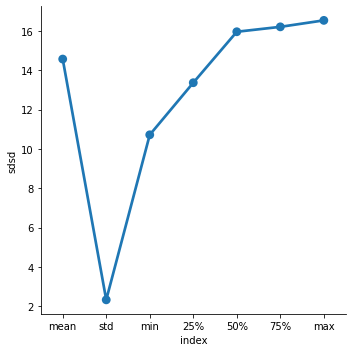

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



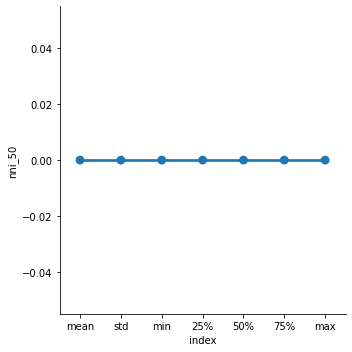

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



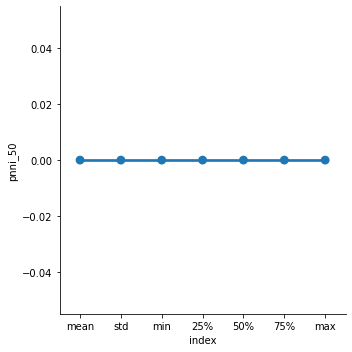

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



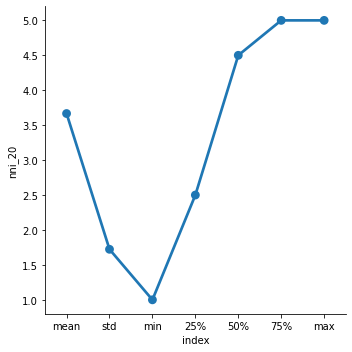

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



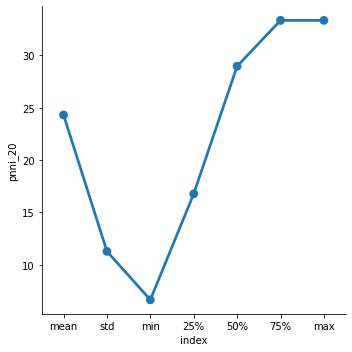

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



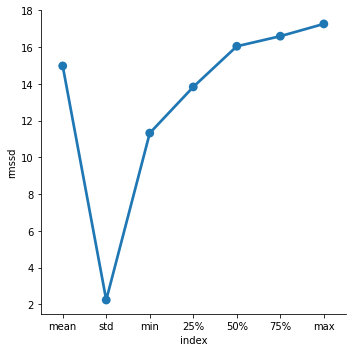

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



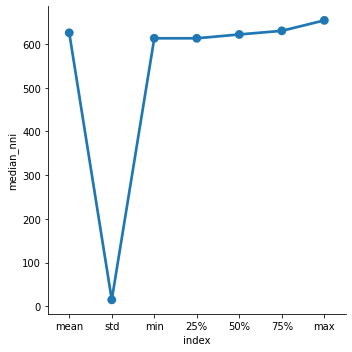

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



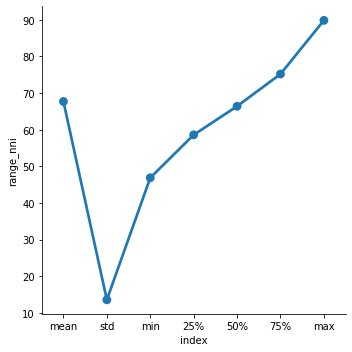

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



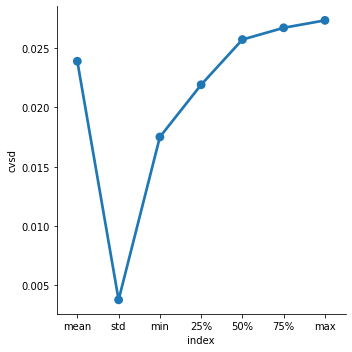

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



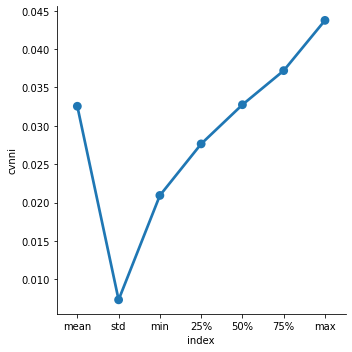

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



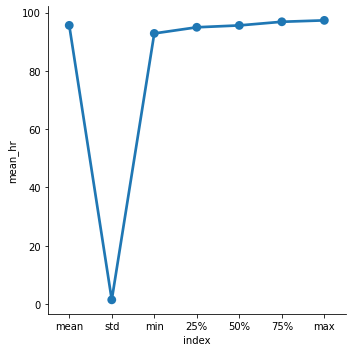

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



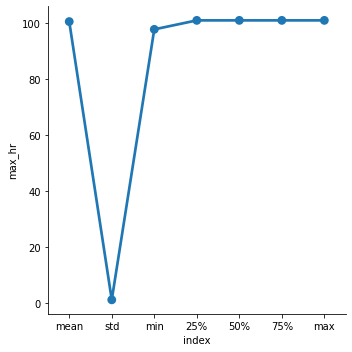

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



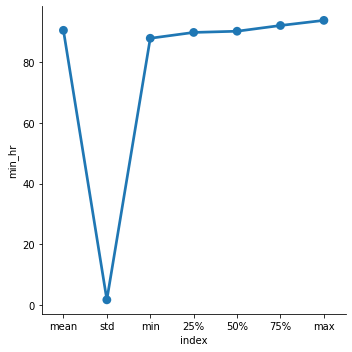

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



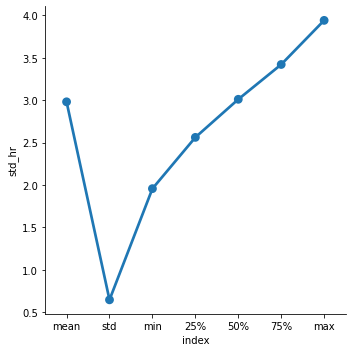

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



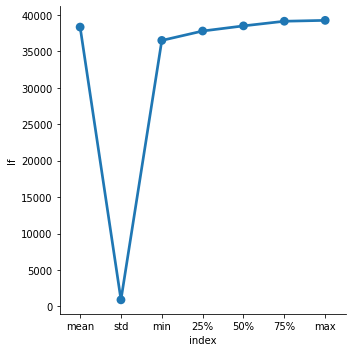

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



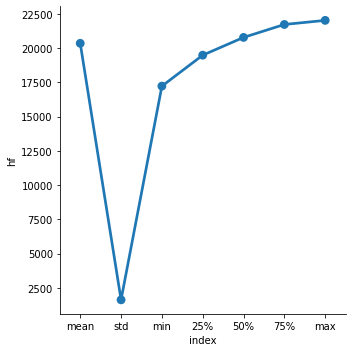

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



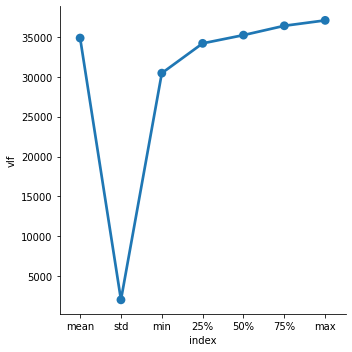

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



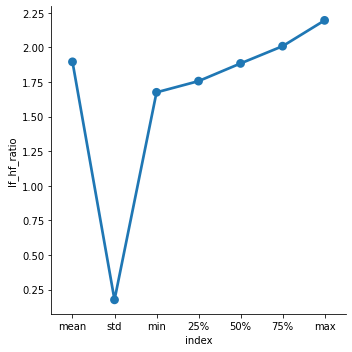

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



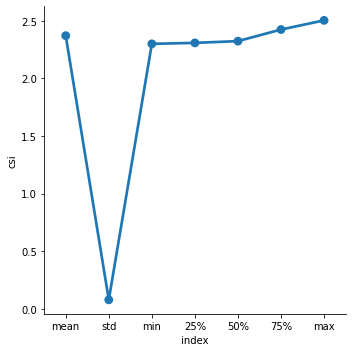

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



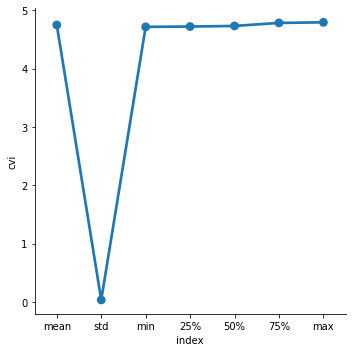

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



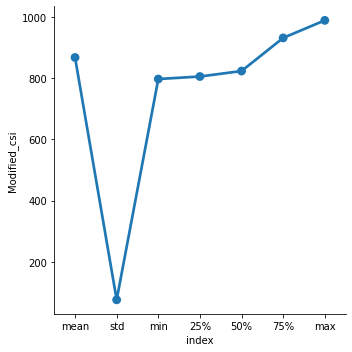

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



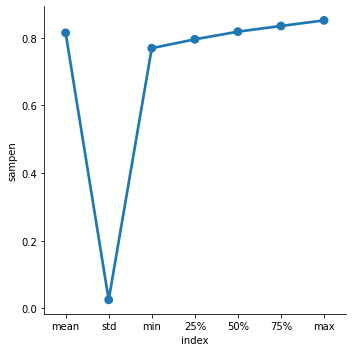

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



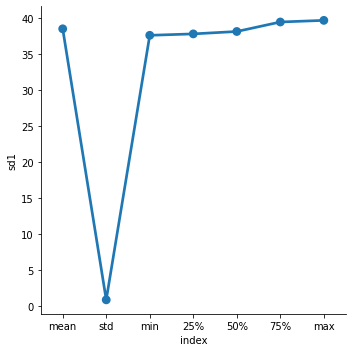

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



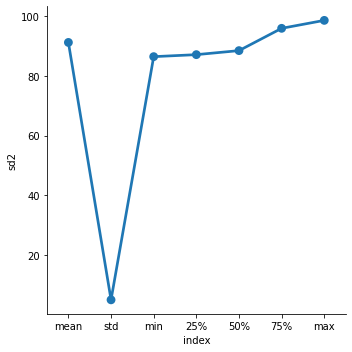

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



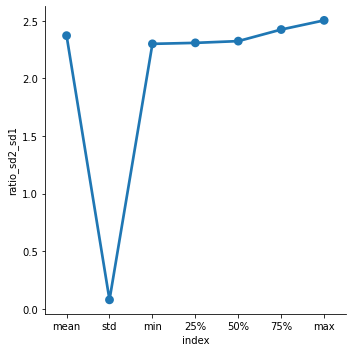

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



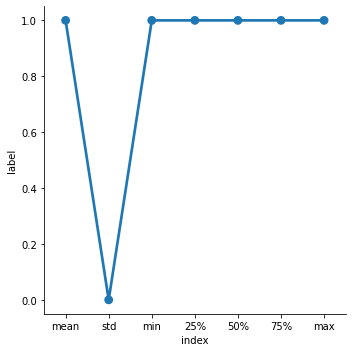

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



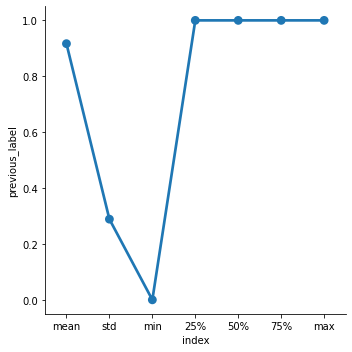

In [39]:
result[10].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = result[10][result[10]['index'] != 'count']
for i in result[10].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



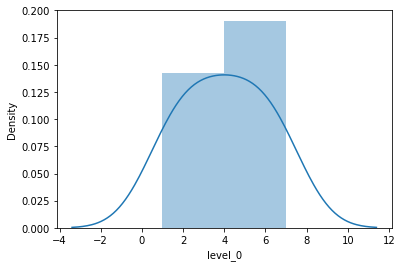

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



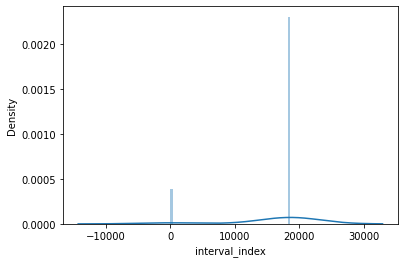

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



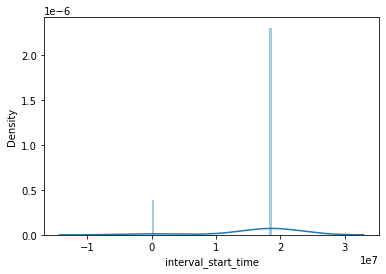

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



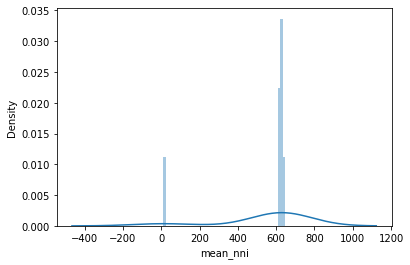

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



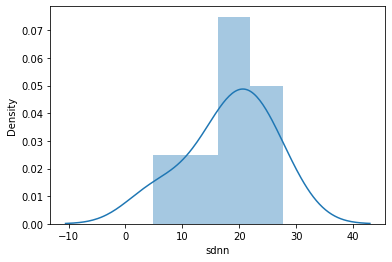

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



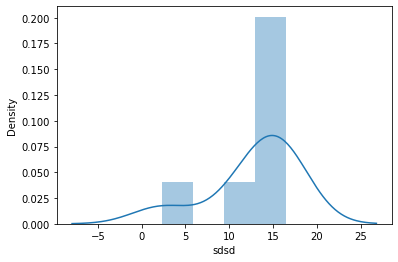

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



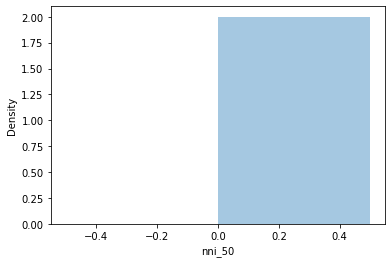

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:316: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



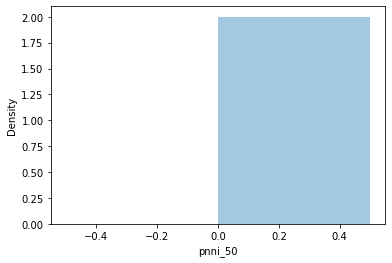

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



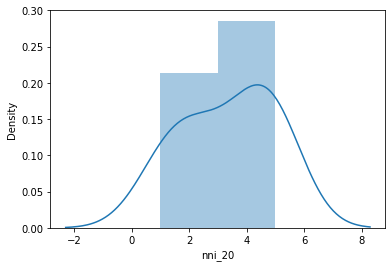

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



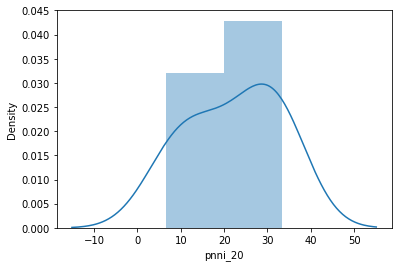

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



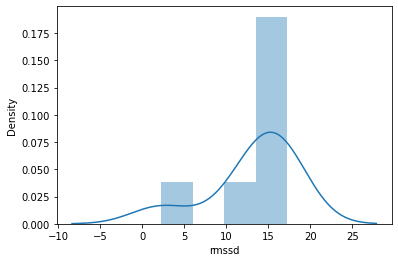

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



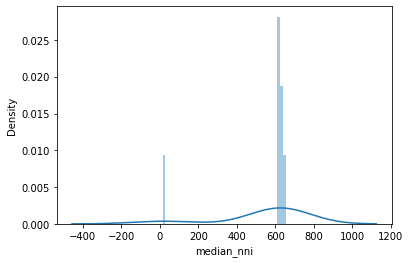

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



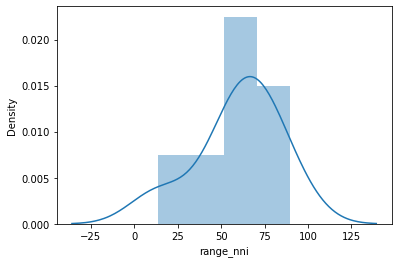

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



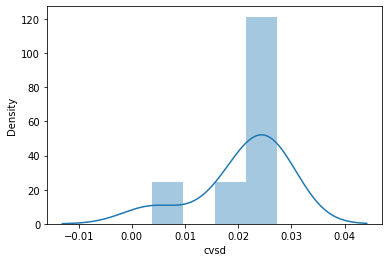

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



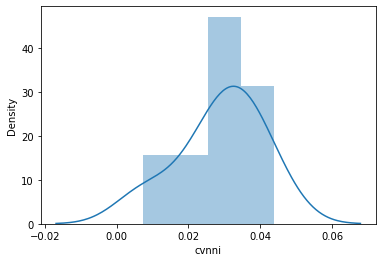

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



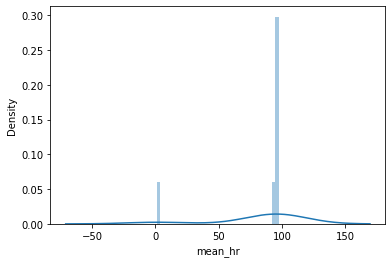

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



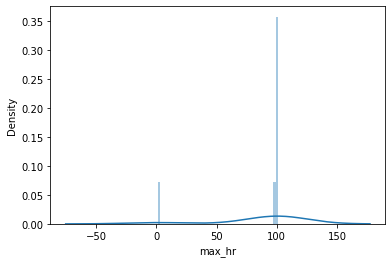

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



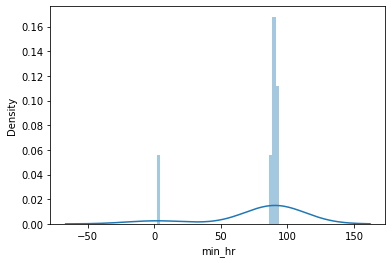

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



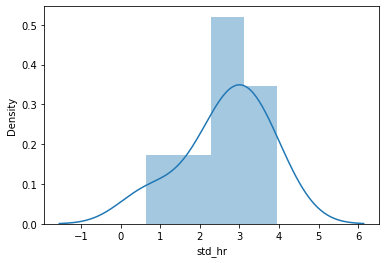

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



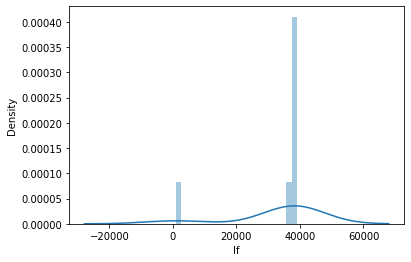

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



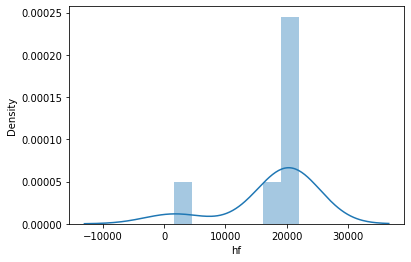

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



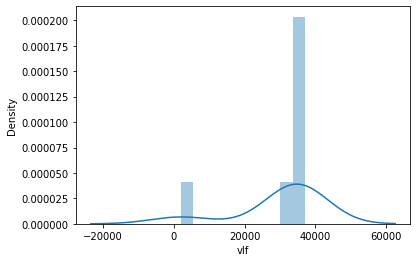

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



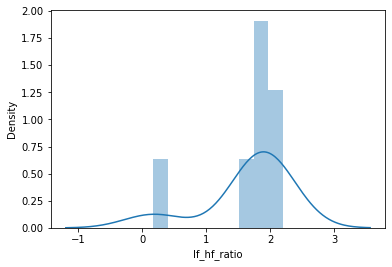

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



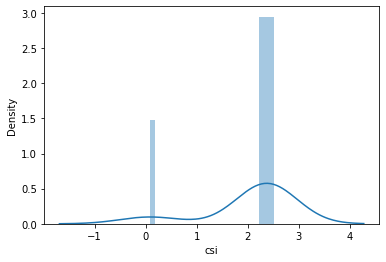

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



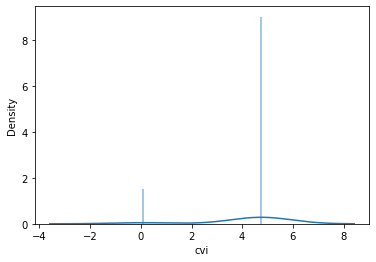

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



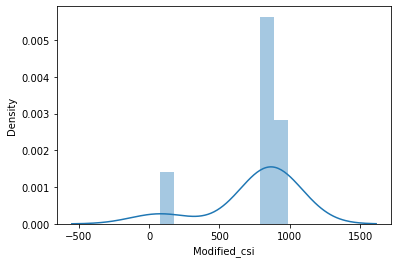

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



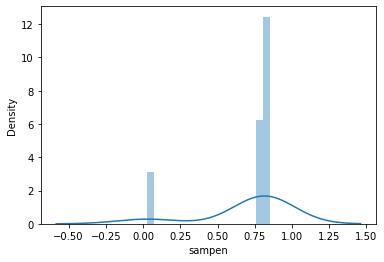

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



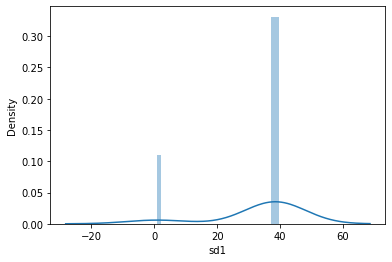

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



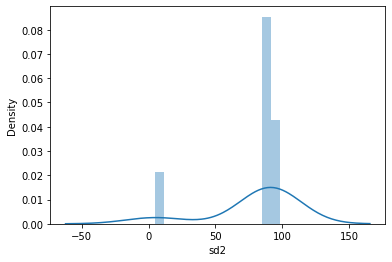

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



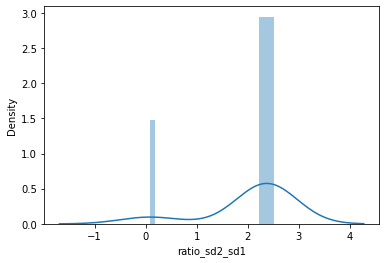

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



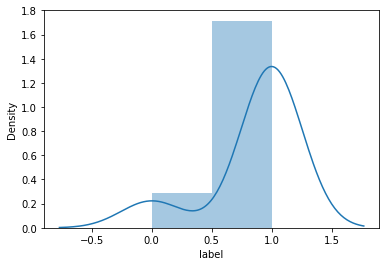

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



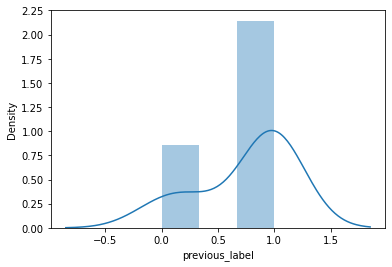

In [40]:
result[10].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = result[10][result[10]['index'] != 'count']
for i in result[10].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

In [41]:
# Create df_interseizures with detail of start and end of each interseizure
df_interseizure = pd.DataFrame()
df_interseizure['start_date'] = df_session.loc[(df_session['label']==0) 
                                           & (df_session['change_of_state']), 'timestamp'].reset_index(
    drop=True)
df_interseizure['end_date'] = df_session.loc[(df_session['label']==0) 
                                         &(df_session['future_change_of_state']),'timestamp'].reset_index(
    drop=True)

df_interseizure['duration_sec'] = (pd.to_datetime(df_interseizure['end_date']) 
                             - pd.to_datetime(df_interseizure['start_date'])).apply(lambda x: 
                                                                                     x.total_seconds()+1)

In [42]:
df_interseizure

,start_date,end_date,duration_sec
0,2017-02-13 15:28:19.750,2017-02-13 16:10:04.750,2506.0
1,2017-02-13 16:10:10.750,2017-02-13 16:15:40.750,331.0
2,2017-02-13 16:15:46.750,2017-02-13 16:19:09.750,204.0
3,2017-02-13 16:19:15.750,2017-02-13 16:25:49.750,395.0
4,2017-02-13 16:25:54.750,2017-02-13 16:26:36.750,43.0
5,2017-02-13 16:26:40.750,2017-02-13 16:35:24.750,525.0
6,2017-02-13 16:35:31.750,2017-02-13 19:35:08.750,10778.0
7,2017-02-13 19:35:18.750,2017-02-13 19:37:34.750,137.0
8,2017-02-13 19:37:43.750,2017-02-13 20:04:15.750,1593.0
9,2017-02-13 20:04:24.750,2017-02-13 20:10:49.750,386.0


<AxesSubplot:title={'center':'Duree des interseizures du patient 18'}>

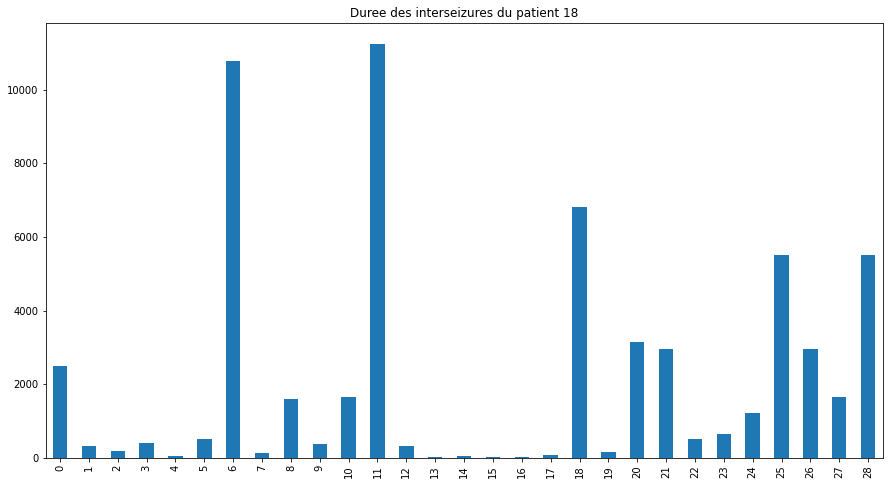

In [43]:
plt.figure(figsize=(15,8))
df_interseizure.duration_sec.plot(kind="bar", title="Duree des interseizures du patient 18")

In [44]:
inter_result = {}
for index, row in df_interseizure.iterrows():
    inter_result[index]=df_session_copy.loc[row['start_date']:row['end_date']].describe()

In [45]:
inter_result[6]

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label,previous_label
count,10778.000000,1.077800e+04,10510.000000,10510.000000,10510.000000,10778.000000,10778.000000,10778.000000,10778.000000,10510.000000,...,10510.000000,10510.000000,10510.000000,10510.000000,1.077800e+04,10510.000000,10510.000000,10510.000000,10778.0,10778.000000
mean,9421.500000,9.421500e+06,735.339250,62.477556,47.227067,2.267489,17.022058,5.585452,43.279679,48.489548,...,2.660479,2.746473,4.579203,1239.333433,inf,39.489015,108.109950,2.746473,0.0,0.000093
std,3111.484935,3.111485e+06,80.378491,74.767816,53.756437,3.344524,24.203570,3.178226,21.850544,55.494202,...,1.946619,0.663881,0.629377,1193.870626,NaN,34.979809,95.699046,0.663881,0.0,0.009632
min,4033.000000,4.033000e+06,410.725911,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.307790,1.243673,3.610731,104.973317,8.236360e-02,10.780490,20.385878,1.243673,0.0,0.000000
25%,6727.250000,6.727250e+06,699.497768,20.423576,19.353109,0.000000,0.000000,3.000000,27.272727,19.661027,...,1.355320,2.288143,4.008989,437.281609,9.090025e-01,16.110877,41.460631,2.288143,0.0,0.000000
50%,9421.500000,9.421500e+06,737.680288,30.117661,24.489900,1.000000,7.692308,5.000000,41.666667,24.859223,...,2.150576,2.682083,4.464961,877.603052,1.252763e+00,24.025169,73.669741,2.682083,0.0,0.000000
75%,12115.750000,1.211575e+07,769.531250,68.932449,49.217195,4.000000,27.272727,7.000000,57.142857,50.281845,...,3.183260,3.131094,5.038742,1593.793876,1.673976e+00,50.870431,138.944346,3.131094,0.0,0.000000
max,14810.000000,1.481000e+07,1532.087054,538.334009,553.784132,18.000000,100.000000,24.000000,100.000000,564.106660,...,20.611959,9.140121,6.225789,9157.007202,inf,229.635752,548.247798,9.140121,0.0,1.000000


/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



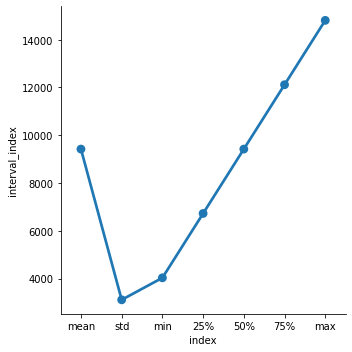

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



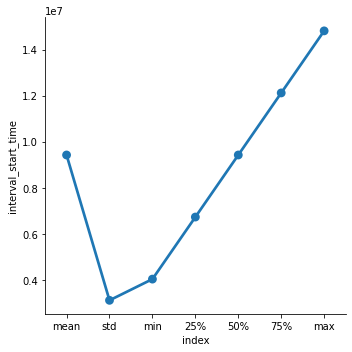

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



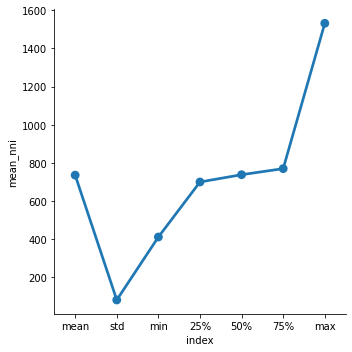

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



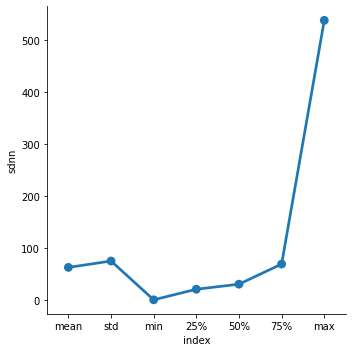

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



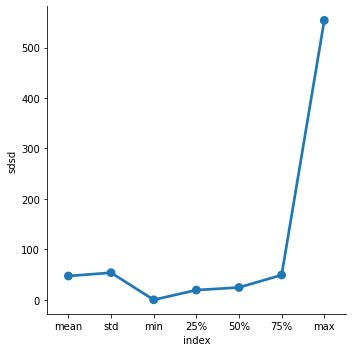

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



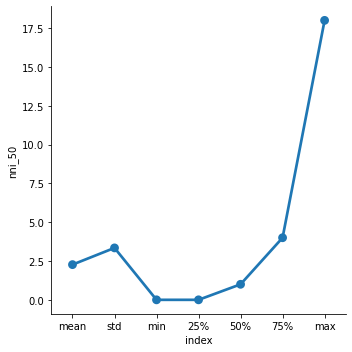

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



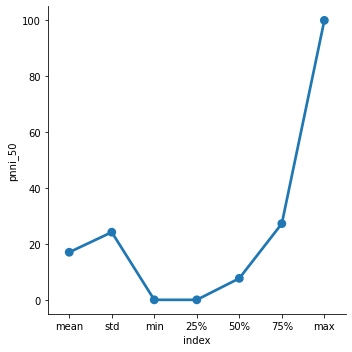

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



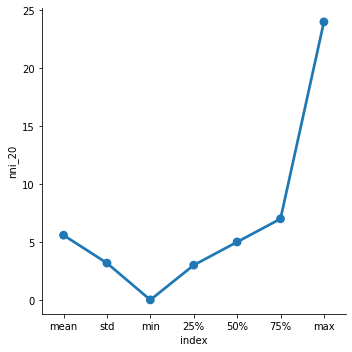

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



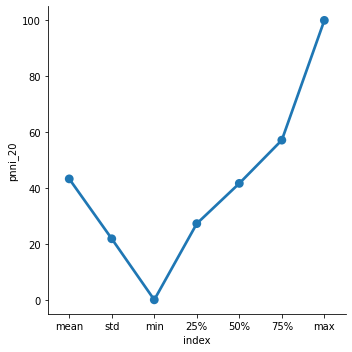

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



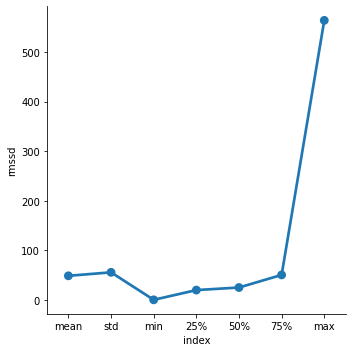

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



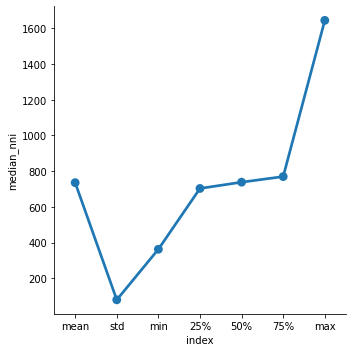

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



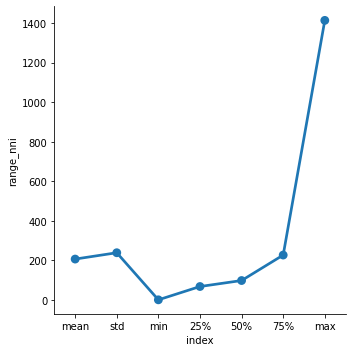

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



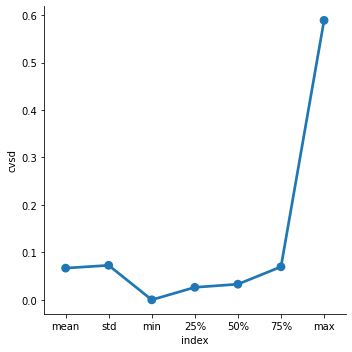

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



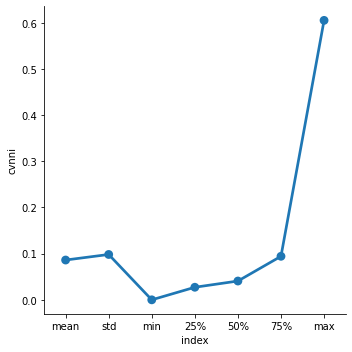

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



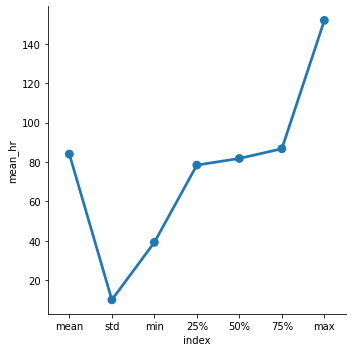

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



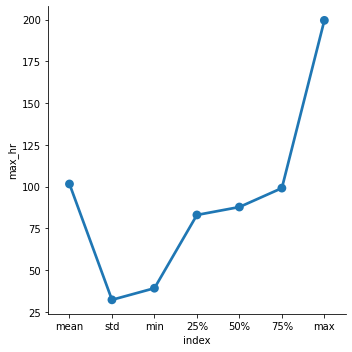

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



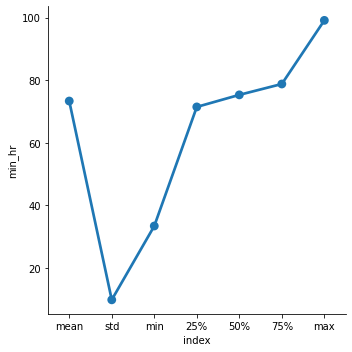

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



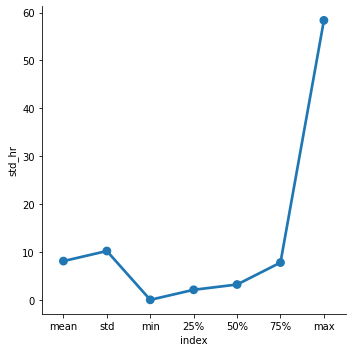

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



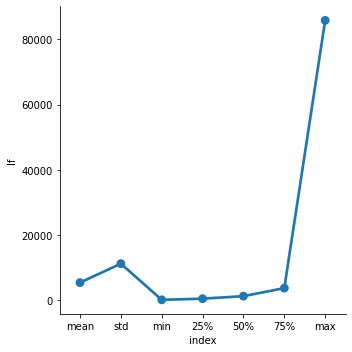

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



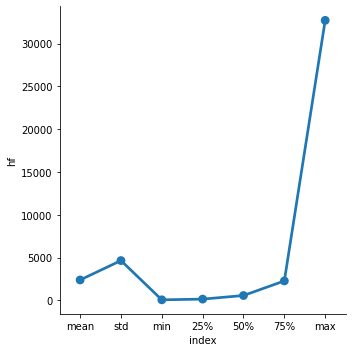

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



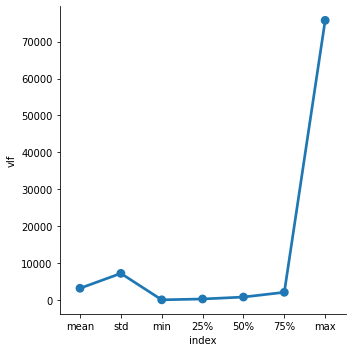

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



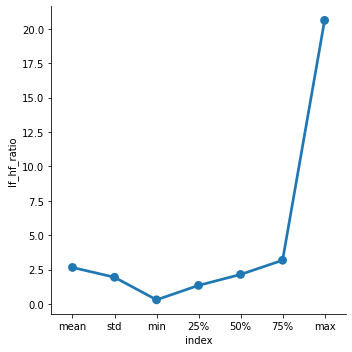

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



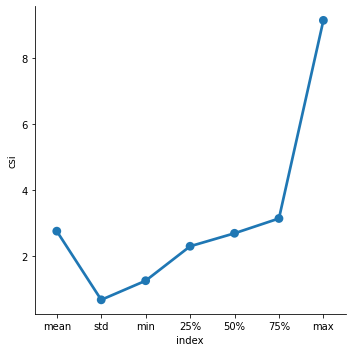

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



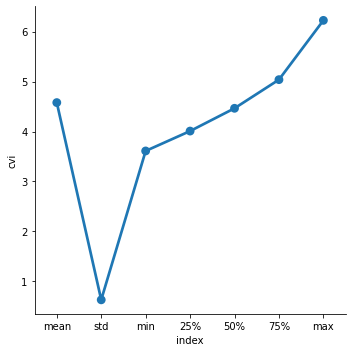

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



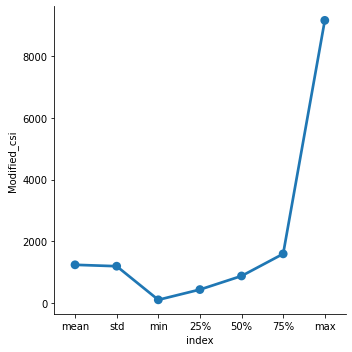

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



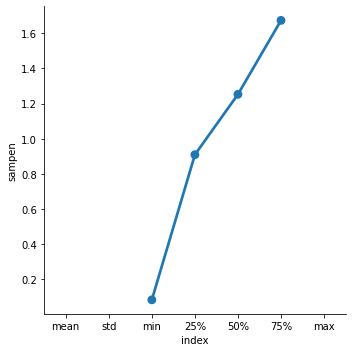

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



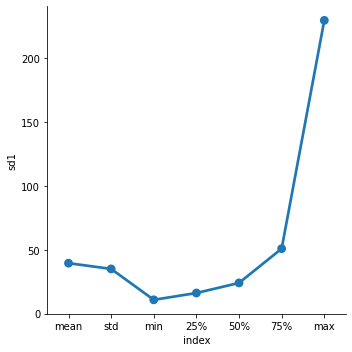

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



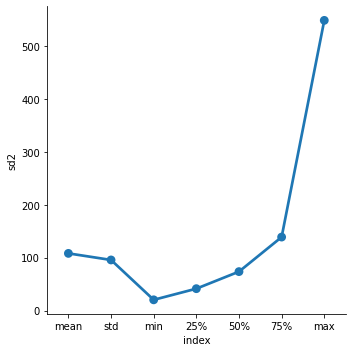

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



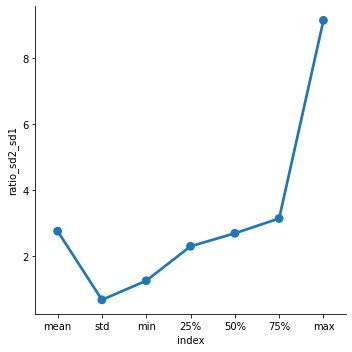

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



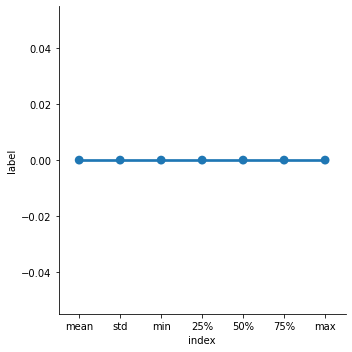

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



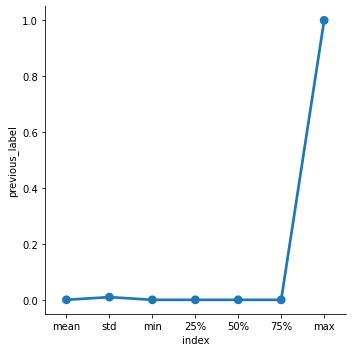

In [46]:
inter_result[6].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = inter_result[6][inter_result[6]['index'] != 'count']
for i in inter_result[6].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



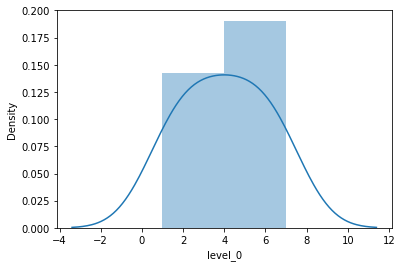

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



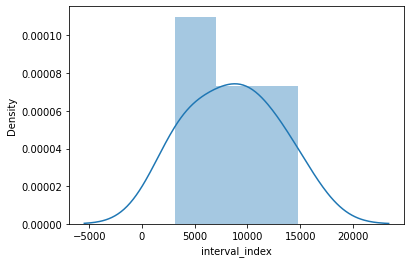

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



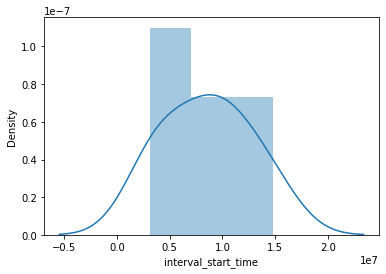

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



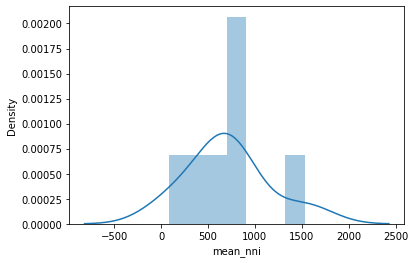

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



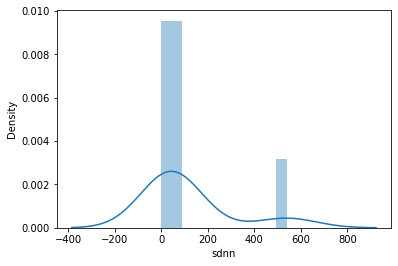

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



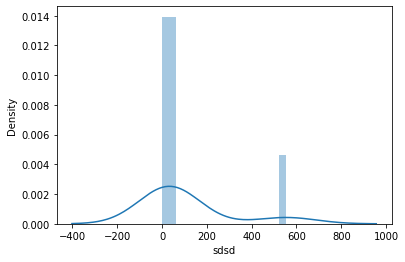

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



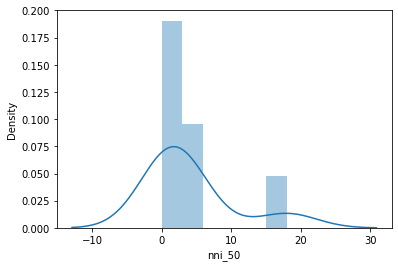

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



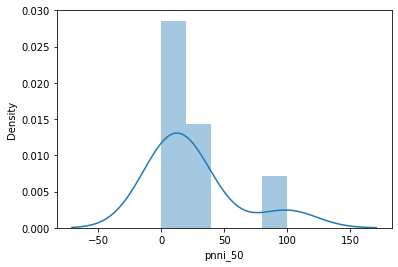

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



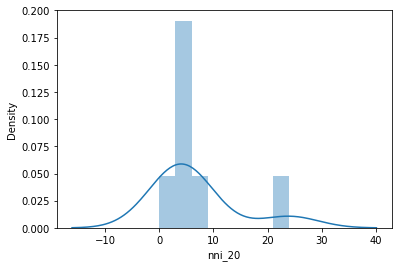

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



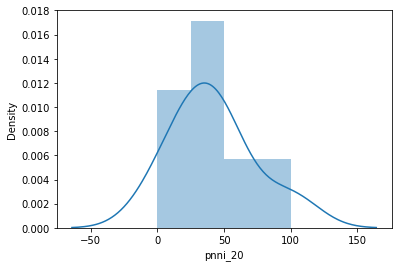

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



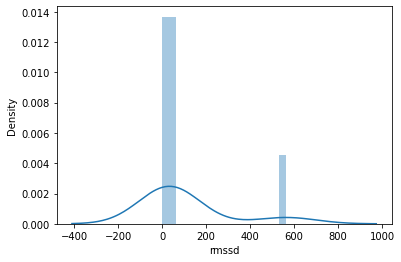

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



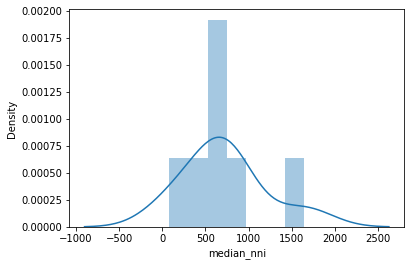

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



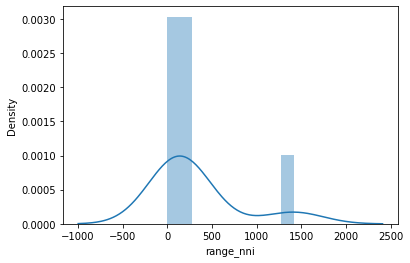

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



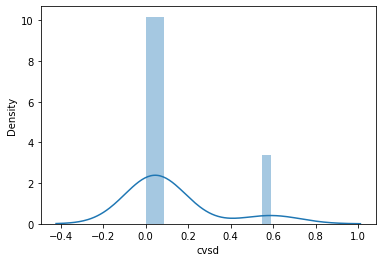

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



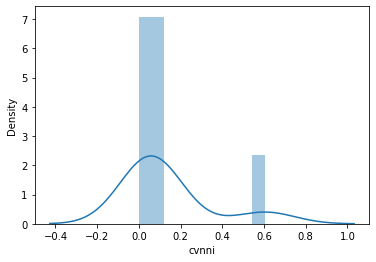

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



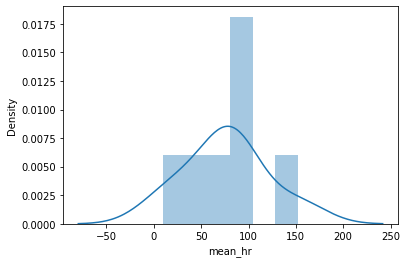

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



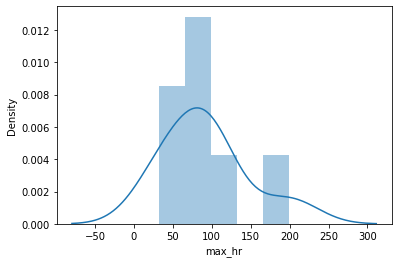

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



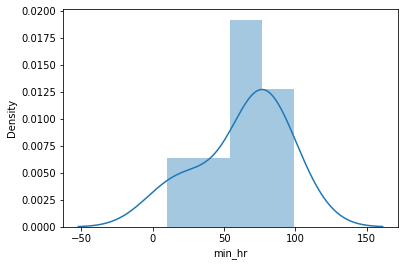

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



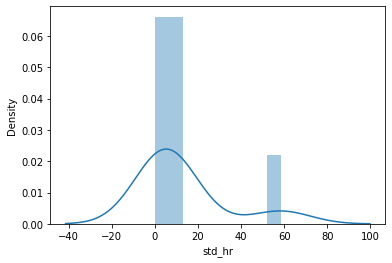

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



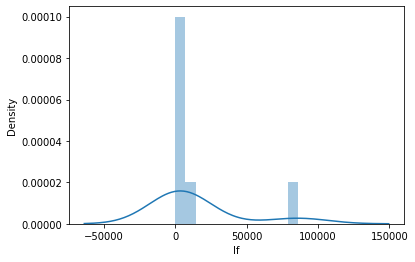

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



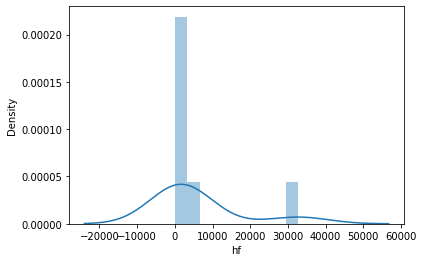

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



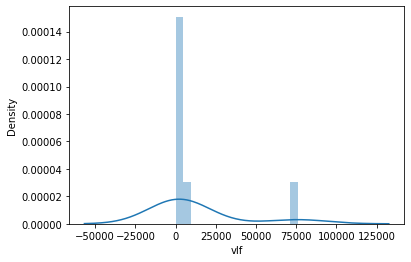

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



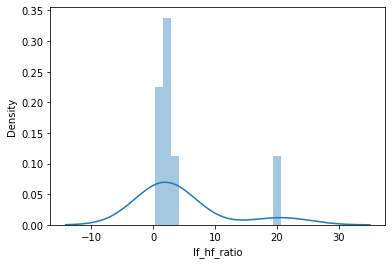

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



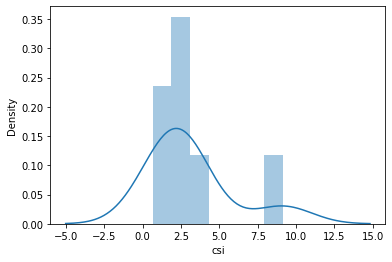

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



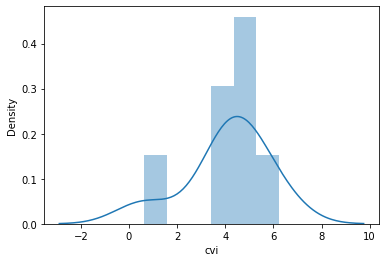

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



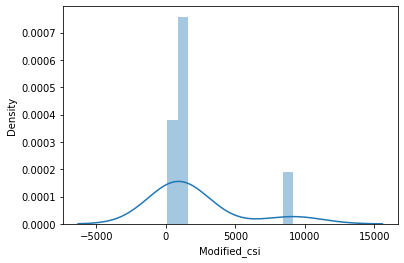

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2465: RuntimeWarning:

invalid value encountered in double_scalars



ValueError: cannot convert float NaN to integer

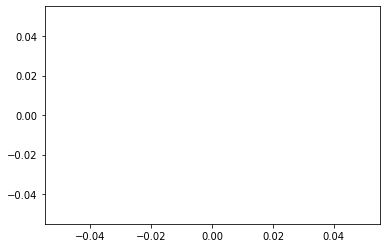

In [47]:
inter_result[6].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = inter_result[6][inter_result[6]['index'] != 'count']
for i in inter_result[6].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

In [48]:
inter_result[11]

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label,previous_label
count,11240.000000,1.124000e+04,10838.000000,10838.000000,10838.000000,11206.000000,11206.000000,11206.000000,11206.000000,10838.000000,...,10839.000000,10839.000000,10839.000000,10839.000000,1.124000e+04,10839.000000,10839.000000,10839.000000,11240.0,11240.000000
mean,24250.500000,2.425050e+07,731.436834,60.769503,47.715169,2.302784,17.614559,5.796270,45.418518,49.121348,...,2.472194,2.687512,4.492695,1176.359155,inf,39.262138,104.521865,2.687512,0.0,0.000089
std,3244.852847,3.244853e+06,91.888701,78.544890,58.132823,3.547493,25.829563,3.409019,24.167076,60.530589,...,1.778608,0.685225,0.684979,1359.616972,NaN,40.261589,109.225133,0.685225,0.0,0.009432
min,18631.000000,1.863100e+07,391.357422,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.410892,1.446462,3.345560,151.035455,2.679819e-02,7.325239,18.906809,1.446462,0.0,0.000000
25%,21440.750000,2.144075e+07,684.451320,21.345883,19.534717,0.000000,0.000000,4.000000,28.571429,19.829454,...,1.290010,2.186136,3.982277,365.930546,1.053079e+00,15.385045,38.482195,2.186136,0.0,0.000000
50%,24250.500000,2.425050e+07,729.867788,28.738283,25.355906,1.000000,7.692308,5.000000,42.857143,25.738799,...,1.972672,2.559906,4.201550,586.955492,1.473306e+00,20.198553,51.232609,2.559906,0.0,0.000000
75%,27060.250000,2.706025e+07,771.259014,51.843891,39.253041,3.000000,26.315789,7.000000,61.538462,40.099644,...,3.082140,3.044656,5.058695,1385.492594,1.828127e+00,50.471307,134.817767,3.044656,0.0,0.000000
max,29870.000000,2.987000e+07,1790.039062,628.136660,485.942902,18.000000,100.000000,20.000000,100.000000,487.601089,...,19.325829,7.016936,6.347841,11780.162718,inf,247.964416,613.667515,7.016936,0.0,1.000000


/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



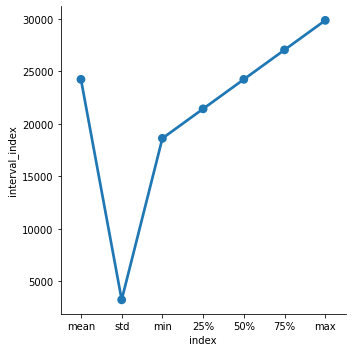

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



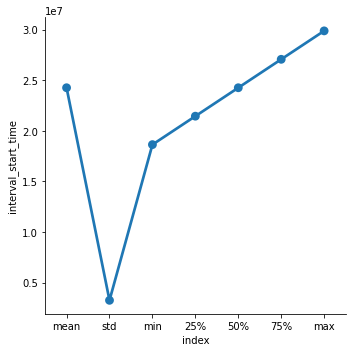

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



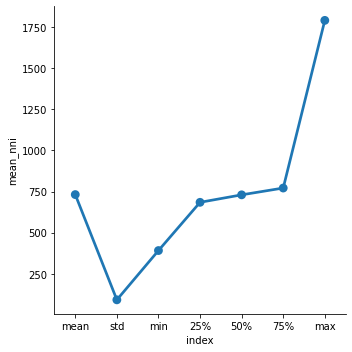

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



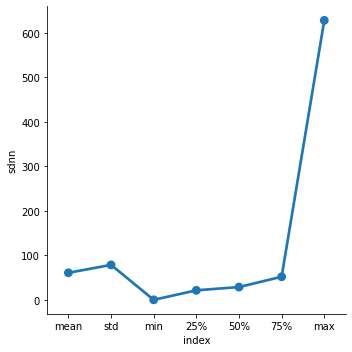

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



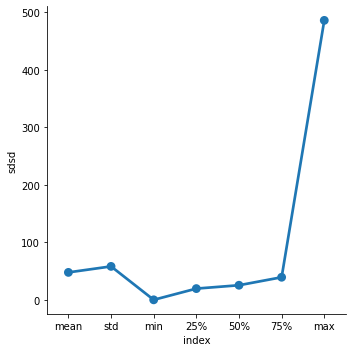

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



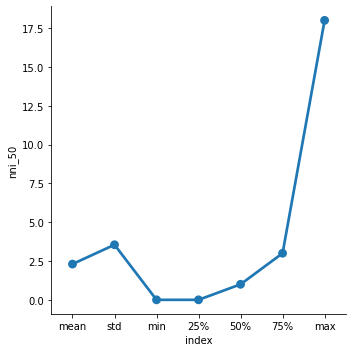

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



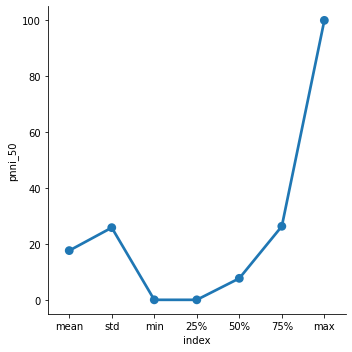

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



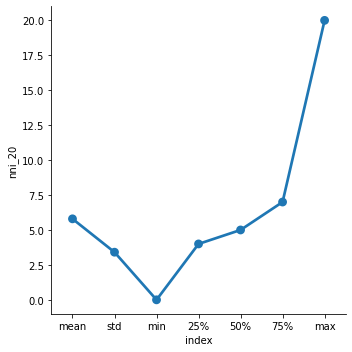

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



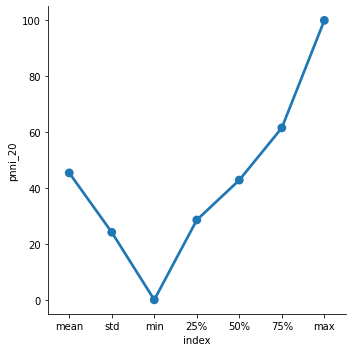

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



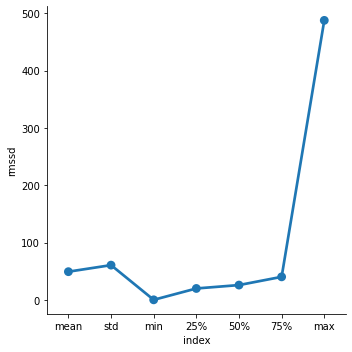

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



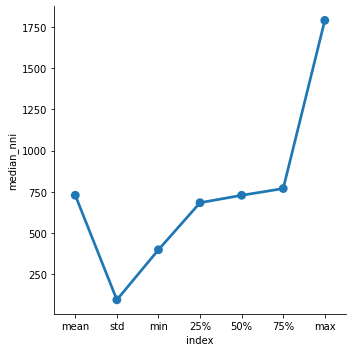

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



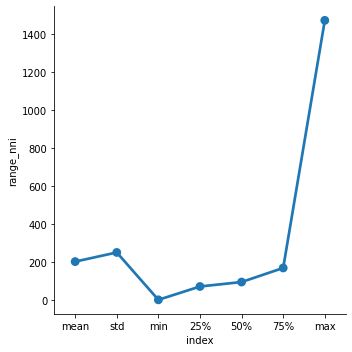

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



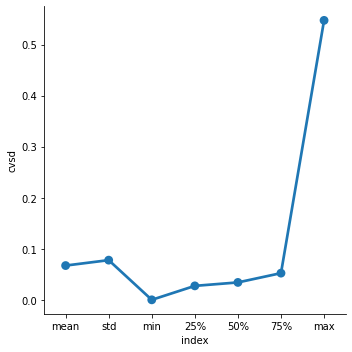

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



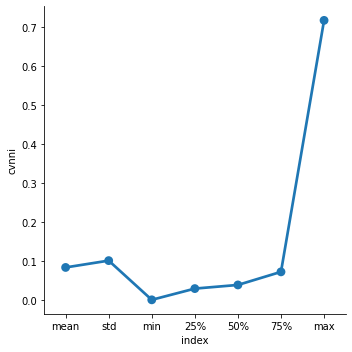

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



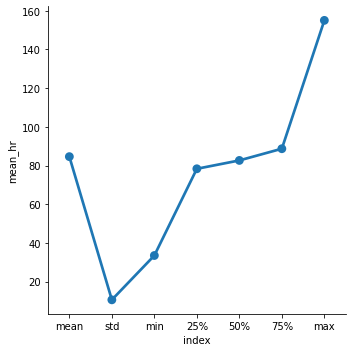

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



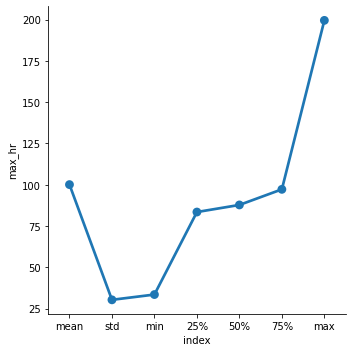

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



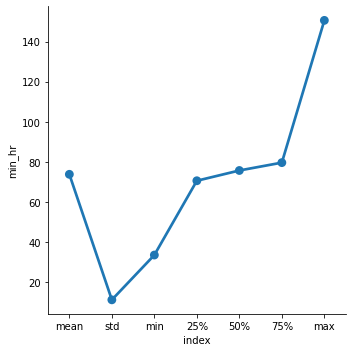

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



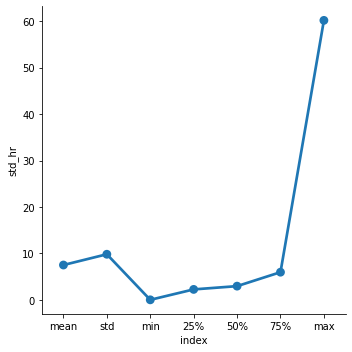

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



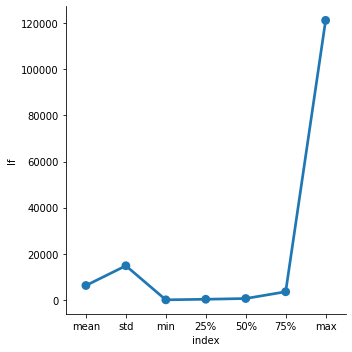

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



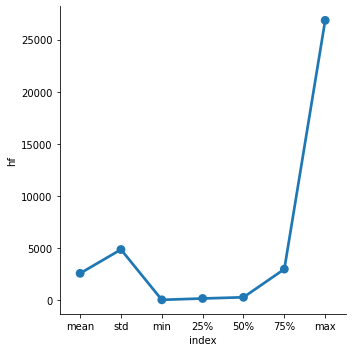

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



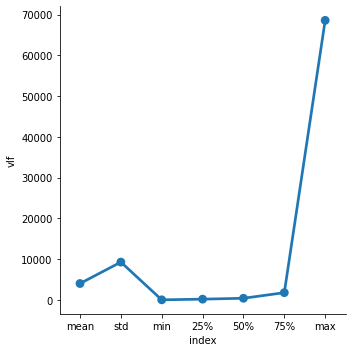

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



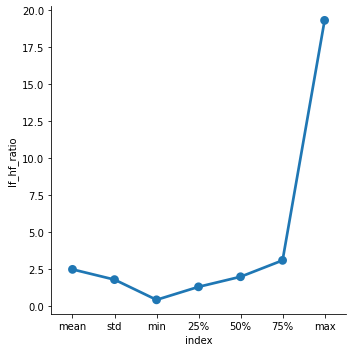

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



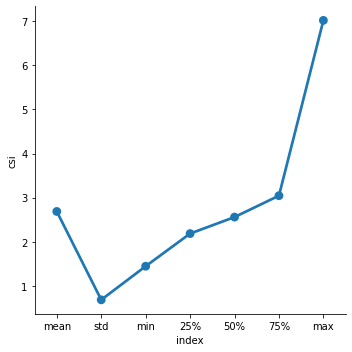

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



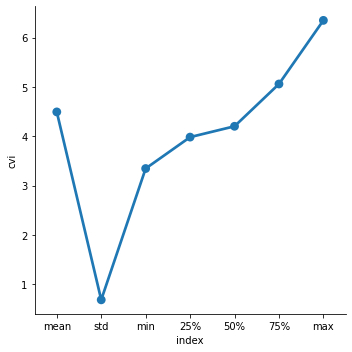

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



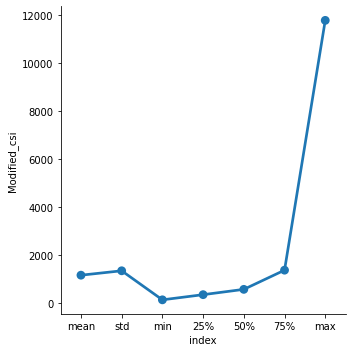

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



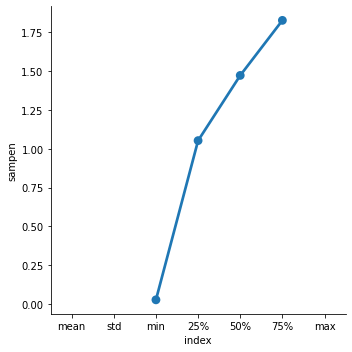

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



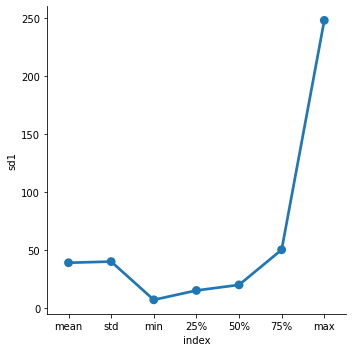

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



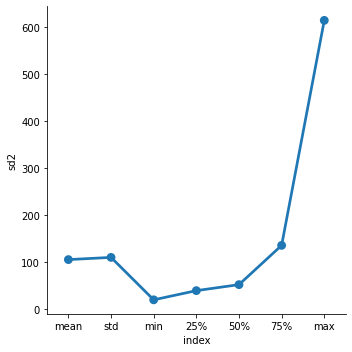

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



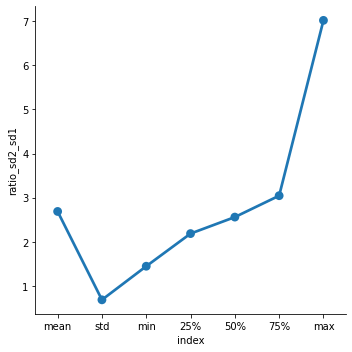

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



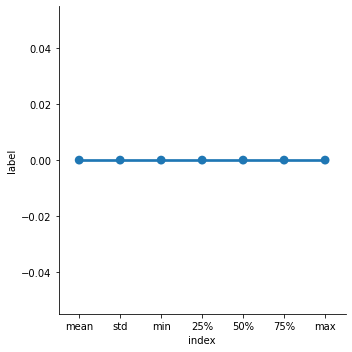

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



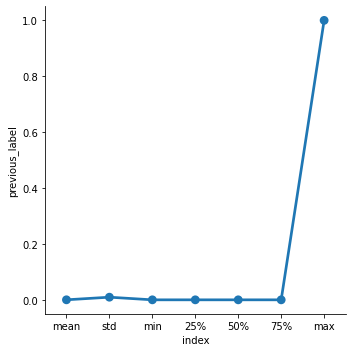

In [49]:
inter_result[11].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = inter_result[11][inter_result[11]['index'] != 'count']
for i in inter_result[11].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



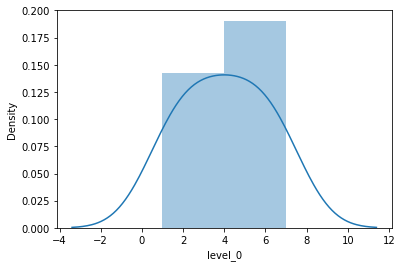

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



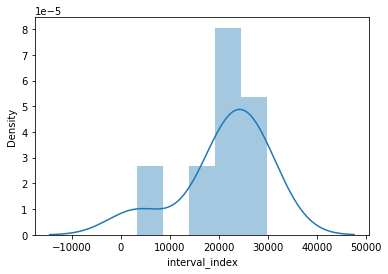

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



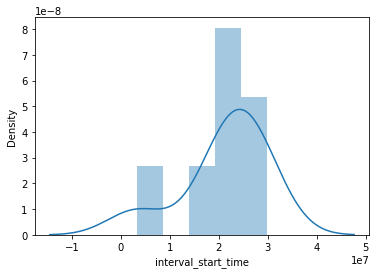

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



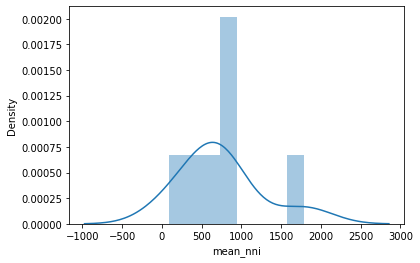

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



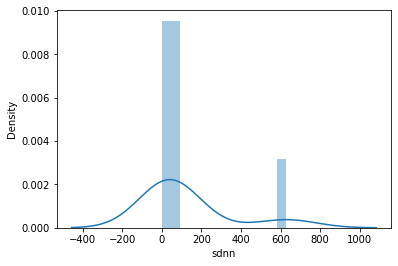

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



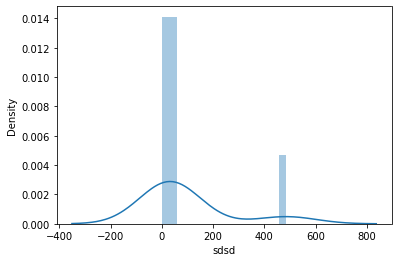

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



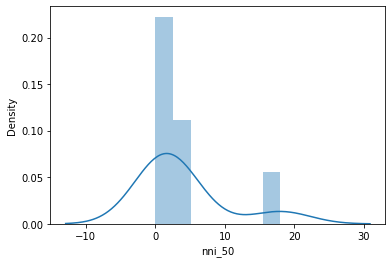

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



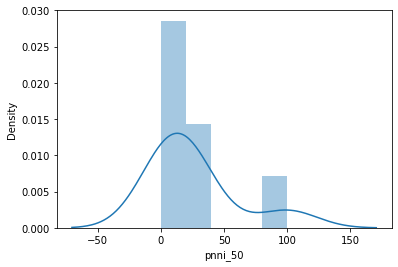

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



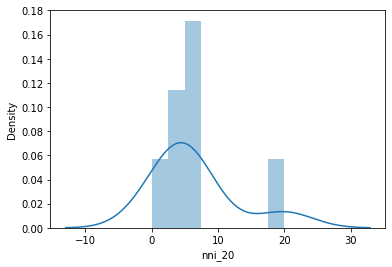

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



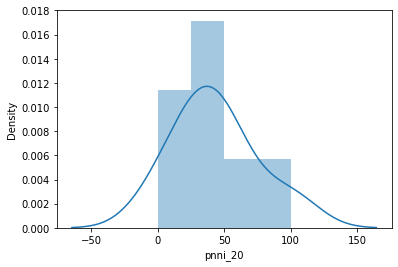

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



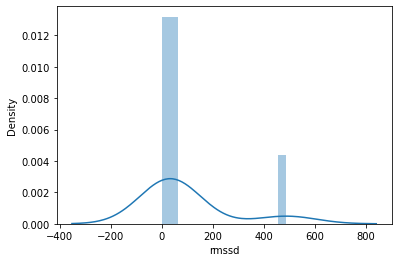

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



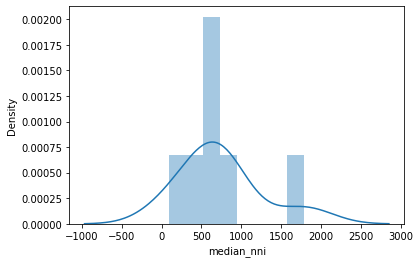

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



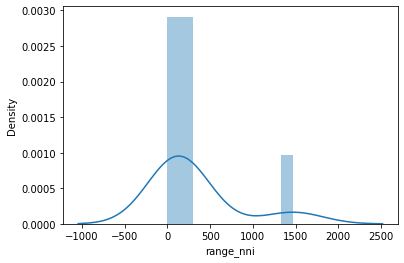

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



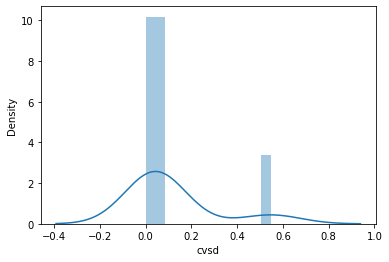

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



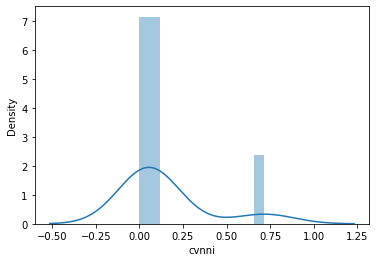

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



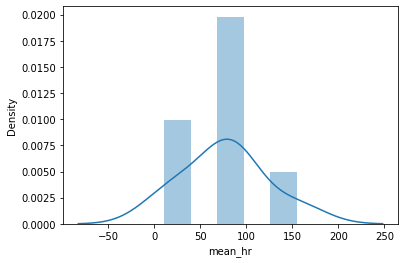

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



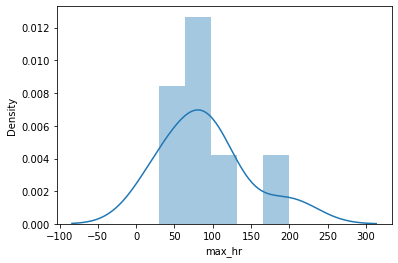

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



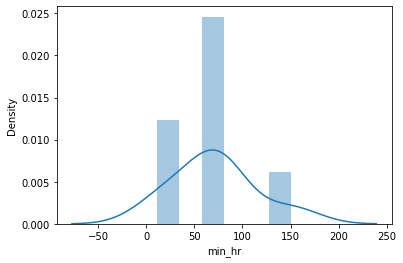

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



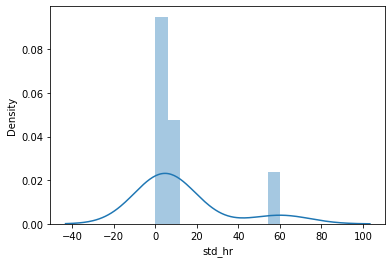

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



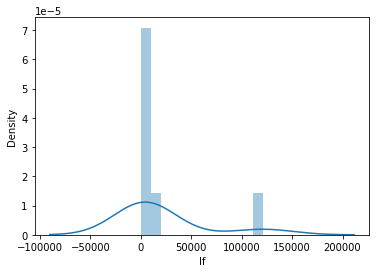

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



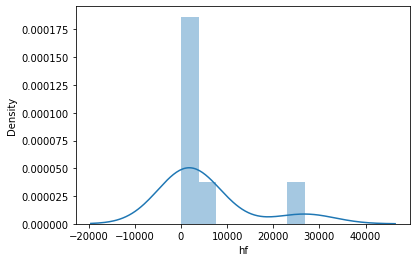

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



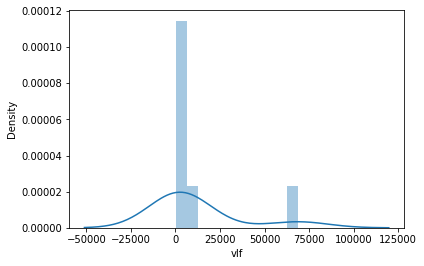

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



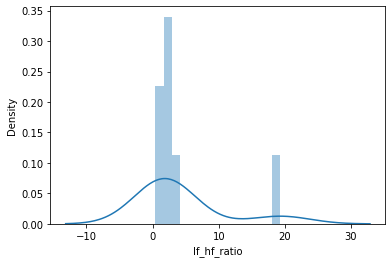

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



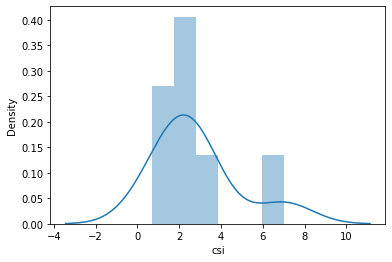

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



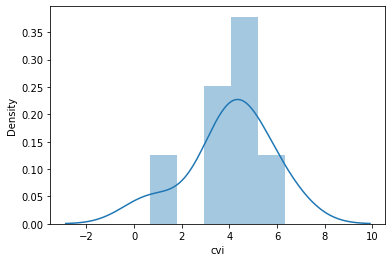

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



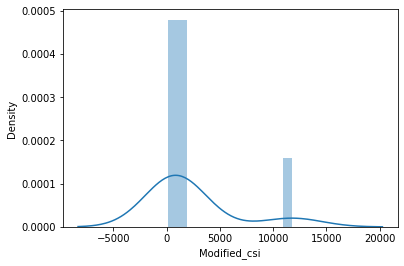

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2465: RuntimeWarning:

invalid value encountered in double_scalars



ValueError: cannot convert float NaN to integer

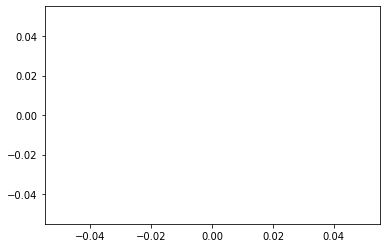

In [50]:
inter_result[11].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = inter_result[11][inter_result[11]['index'] != 'count']
for i in inter_result[11].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

In [51]:
#Nombre de crise
df_seizure.shape[0]

28

In [52]:
#Duree totale des crises
df_seizure['duration_sec'].sum()

204.0

In [53]:
#Duree moyenne des crises
df_seizure['duration_sec'].mean()

7.285714285714286

In [54]:
#Ecart type des crises
df_seizure['duration_sec'].std()

13.10317219962867

In [55]:
#Nombre d'interseizure
df_interseizure.shape[0]

29

In [56]:
#Duree totale des interseizure
df_interseizure['duration_sec'].sum()

61461.0

In [57]:
#Duree moyenne des interseizures
df_interseizure['duration_sec'].mean()

2119.344827586207

In [58]:
#Ecart type des interseizures
df_interseizure['duration_sec'].std()

3071.3377992085616

##### Patient 50

In [59]:
df_session_50 = pd.read_csv(df_files.loc[106]["path"])
df_session_50

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,timestamp,filename,label
0,1.0,1000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:19.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
1,2.0,2000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:20.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
2,3.0,3000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:21.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
3,4.0,4000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:22.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
4,5.0,5000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-10 15:42:23.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61073,61074.0,61074000.0,746.372768,131.820873,95.080681,6.0,46.153846,11.0,84.615385,95.234392,...,2.882984,5.323946,2247.690203,1.134980,67.607067,194.910071,2.882984,2017-07-11 08:40:12.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
61074,61075.0,61075000.0,732.271635,133.360593,96.669823,5.0,41.666667,10.0,83.333333,97.499875,...,2.874461,5.322716,2234.564101,1.027786,67.611394,194.346337,2.874461,2017-07-11 08:40:13.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
61075,61076.0,61076000.0,730.189732,124.955054,95.400160,6.0,46.153846,12.0,92.307692,95.468278,...,2.919763,5.327125,2299.238759,0.983732,67.426233,196.868617,2.919763,2017-07-11 08:40:14.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0
61076,61077.0,61077000.0,722.656250,120.950695,96.112991,7.0,53.846154,12.0,92.307692,96.623141,...,2.917662,5.328471,2300.318936,1.007263,67.555093,197.102930,2.917662,2017-07-11 08:40:15.230468750,/home/aura-sakhite/seizure_detection_pipeline/...,0


In [60]:
df_session_50.label.unique()

array([0, 1])

In [61]:
df_session_50.describe()

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
count,61078.000000,6.107800e+04,60776.000000,60776.000000,60776.000000,61069.000000,61069.000000,61069.000000,61069.000000,60776.000000,...,60640.000000,60640.000000,60727.000000,60727.000000,60727.000000,6.101900e+04,60727.000000,60727.000000,60727.000000,61078.000000
mean,30539.500000,3.053950e+07,927.330121,64.043229,61.917648,4.155496,42.389287,7.195205,72.044765,63.020875,...,2871.494017,3.263053,2.268911,4.823283,1168.894922,inf,47.309334,108.096596,2.268911,0.006680
std,17631.844208,1.763184e+07,149.090605,42.425782,30.468139,2.311858,22.332543,2.043574,17.359292,30.985106,...,4505.090040,2.091062,0.959590,0.339580,1236.127248,NaN,16.869258,65.885776,0.959590,0.081458
min,1.000000,1.000000e+03,415.364583,6.229039,5.752100,0.000000,0.000000,0.000000,0.000000,5.812686,...,26.588179,0.326433,0.644136,4.015404,82.785747,1.517669e-01,14.912976,29.511312,0.644136,0.000000
25%,15270.250000,1.527025e+07,804.361979,38.623240,41.316763,3.000000,25.000000,6.000000,61.538462,42.125968,...,558.738949,1.759440,1.553312,4.567240,406.848759,1.304949e+00,34.789070,62.602543,1.553312,0.000000
50%,30539.500000,3.053950e+07,966.015625,51.230816,56.504394,4.000000,44.444444,7.000000,75.000000,57.599713,...,1162.642272,2.687290,2.099436,4.775817,701.573668,1.714798e+00,45.890482,85.322080,2.099436,0.000000
75%,45808.750000,4.580875e+07,1051.171875,73.552459,75.036612,5.000000,60.000000,8.000000,87.500000,76.369158,...,2988.232671,4.253152,2.774874,5.036243,1432.077486,2.219203e+00,56.106971,131.393699,2.774874,0.000000
max,61078.000000,6.107800e+07,1497.070312,608.046428,467.133606,20.000000,100.000000,22.000000,100.000000,501.928425,...,51095.572658,18.132977,7.575668,6.162108,10314.732182,inf,197.239947,485.731824,7.575668,1.000000


In [62]:
df_session_50 = df_session_50.sort_values(by = 'timestamp').reset_index(drop=True)

In [63]:
df_session_50.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61078 entries, 0 to 61077
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   interval_index       61078 non-null  float64
 1   interval_start_time  61078 non-null  float64
 2   mean_nni             60776 non-null  float64
 3   sdnn                 60776 non-null  float64
 4   sdsd                 60776 non-null  float64
 5   nni_50               61069 non-null  float64
 6   pnni_50              61069 non-null  float64
 7   nni_20               61069 non-null  float64
 8   pnni_20              61069 non-null  float64
 9   rmssd                60776 non-null  float64
 10  median_nni           60776 non-null  float64
 11  range_nni            60776 non-null  float64
 12  cvsd                 60776 non-null  float64
 13  cvnni                60776 non-null  float64
 14  mean_hr              60776 non-null  float64
 15  max_hr               60776 non-null 

<AxesSubplot:>

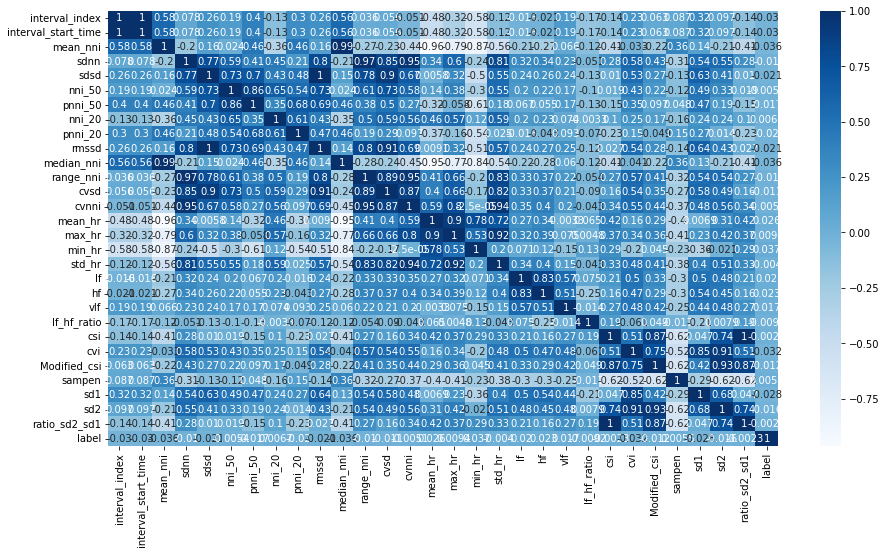

In [64]:
plt.figure(figsize=(15,8))
corr = df_session_50.corr()
sns.heatmap(corr, cmap="Blues", annot=True)

In [65]:
df_session_50.corr()

,interval_index,interval_start_time,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,...,vlf,lf_hf_ratio,csi,cvi,Modified_csi,sampen,sd1,sd2,ratio_sd2_sd1,label
interval_index,1.000000,1.000000,0.575228,0.078123,0.261641,0.185340,0.398534,-0.130515,0.296062,0.264563,...,0.187317,-0.174606,-0.138128,0.232100,0.062566,0.087358,0.315714,0.096875,-0.138128,-0.029769
interval_start_time,1.000000,1.000000,0.575228,0.078123,0.261641,0.185340,0.398534,-0.130515,0.296062,0.264563,...,0.187317,-0.174606,-0.138128,0.232100,0.062566,0.087358,0.315714,0.096875,-0.138128,-0.029769
mean_nni,0.575228,0.575228,1.000000,-0.200740,0.160971,0.023824,0.459928,-0.355130,0.456788,0.158384,...,0.066392,-0.123877,-0.409293,-0.033278,-0.218377,0.363050,0.144410,-0.206887,-0.409293,-0.036243
sdnn,0.078123,0.078123,-0.200740,1.000000,0.770051,0.591053,0.405083,0.453266,0.210757,0.797693,...,0.231439,-0.050796,0.279836,0.579002,0.427525,-0.310234,0.537898,0.551519,0.279836,-0.010492
sdsd,0.261641,0.261641,0.160971,0.770051,1.000000,0.731690,0.699165,0.432136,0.478927,0.996912,...,0.244058,-0.126515,0.010394,0.528275,0.265023,-0.134498,0.629751,0.413560,0.010394,-0.021180
nni_50,0.185340,0.185340,0.023824,0.591053,0.731690,1.000000,0.860188,0.650572,0.536188,0.726523,...,0.169869,-0.101644,0.019424,0.434658,0.221996,-0.124799,0.486376,0.329425,0.019424,-0.005429
pnni_50,0.398534,0.398534,0.459928,0.405083,0.699165,0.860188,1.000000,0.348402,0.676431,0.694786,...,0.172816,-0.130956,-0.151284,0.352445,0.097149,0.047713,0.466781,0.187734,-0.151284,-0.017155
nni_20,-0.130515,-0.130515,-0.355130,0.453266,0.432136,0.650572,0.348402,1.000000,0.605700,0.425858,...,0.073864,-0.003320,0.102446,0.246888,0.166170,-0.164467,0.242213,0.239202,0.102446,0.006724
pnni_20,0.296062,0.296062,0.456788,0.210757,0.478927,0.536188,0.676431,0.605700,1.000000,0.472962,...,0.093173,-0.070184,-0.232832,0.147806,-0.048878,0.152896,0.274637,0.014130,-0.232832,-0.019510
rmssd,0.264563,0.264563,0.158384,0.797693,0.996912,0.726523,0.694786,0.425858,0.472962,1.000000,...,0.249140,-0.124541,0.027128,0.541918,0.282126,-0.144966,0.636373,0.430275,0.027128,-0.021383


In [66]:
df_session_50.corr()['label'].unique()

array([-0.02976891, -0.02976891, -0.03624304, -0.01049196, -0.02117995,
       -0.00542922, -0.01715531,  0.00672367, -0.01950975, -0.02138293,
       -0.03644885, -0.01017408, -0.01134177, -0.00505087,  0.02569924,
        0.00936524,  0.03669355, -0.00396454,  0.02046435,  0.02315743,
        0.01673619, -0.00921935, -0.00230779, -0.03162208, -0.0117162 ,
        0.00553123, -0.02841332, -0.01564843,  1.        ])

In [67]:
#session start
df_session_50['timestamp'].iloc[0]

'2017-07-10 15:42:19.230468750'

In [68]:
#session end
df_session_50['timestamp'].iloc[-1]

'2017-07-11 08:40:16.230468750'

In [69]:
#session duration : since time between row is 1sec
df_session_50.shape[0]

61078

In [70]:
#session in hour
df_session_50.shape[0]/3600

16.96611111111111

In [71]:
#total_seizure_duration_sec
df_session_50[df_session_50['label']==1].label.sum()

408

In [72]:
#total_interseizure_duration_sec
(df_session_50['label'] == 0).sum()    

60670

In [73]:
## Analysis of seizures inside session ##
# Detect change of state
df_session_50['previous_label'] = df_session_50['label'].shift(1)
df_session_50['change_of_state'] = (df_session_50['label'] != df_session_50['previous_label'])
df_session_50['change_of_state'].value_counts()
df_session_50['future_change_of_state'] = df_session_50['change_of_state'].shift(-1).fillna(True)

#### Seizure informations from session

In [74]:
df_seizure_50 = pd.DataFrame()
df_seizure_50['start_date'] = df_session_50.loc[(df_session_50['label']==1) 
                                               & (df_session_50['change_of_state']), 'timestamp'].reset_index(
        drop=True)
df_seizure_50['end_date'] = df_session_50.loc[(df_session_50['label']==1) 
                                             &(df_session_50['future_change_of_state']),'timestamp'].reset_index(
        drop=True)

df_seizure_50['duration_sec'] = (pd.to_datetime(df_seizure_50['end_date']) 
                                 - pd.to_datetime(df_seizure_50['start_date'])).apply(
        lambda x : x.total_seconds() + 1)

In [75]:
df_seizure_50.head()

,start_date,end_date,duration_sec
0,2017-07-10 15:54:29.230468750,2017-07-10 15:54:56.230468750,28.0
1,2017-07-10 17:23:07.230468750,2017-07-10 17:23:18.230468750,12.0
2,2017-07-10 18:23:46.230468750,2017-07-10 18:24:02.230468750,17.0
3,2017-07-10 18:32:47.230468750,2017-07-10 18:33:03.230468750,17.0
4,2017-07-10 19:11:00.230468750,2017-07-10 19:11:16.230468750,17.0


In [76]:
df_seizure_50.describe()

,duration_sec
count,27.000000
mean,15.111111
std,6.565254
min,4.000000
25%,10.000000
50%,15.000000
75%,19.000000
max,29.000000


<AxesSubplot:title={'center':'Duree des seizure du patient 50'}>

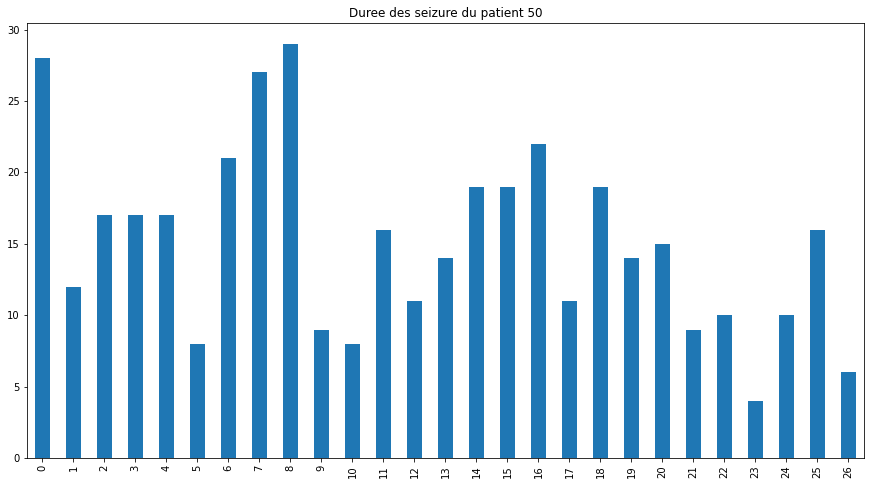

In [77]:
plt.figure(figsize=(15,8))
df_seizure_50.duration_sec.plot(kind="bar", title="Duree des seizure du patient 50")

In [78]:
df_session_50_copy = df_session_50.copy()
df_session_50_copy = df_session_50_copy.set_index("timestamp")

In [79]:
describe_seizure_period = {}
for index, row in df_seizure_50.iterrows():
    describe_seizure_period[index]=df_session_50_copy.loc[row['start_date']:row['end_date']].describe()

/home/aura-sakhite/.local/lib/python3.6/site-packages/numpy/lib/function_base.py:3968: RuntimeWarning:

invalid value encountered in multiply



/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



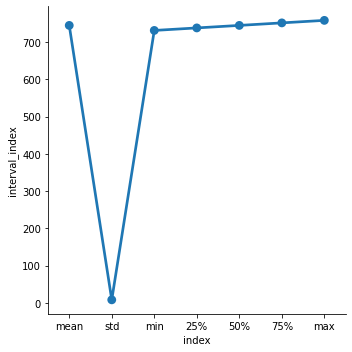

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



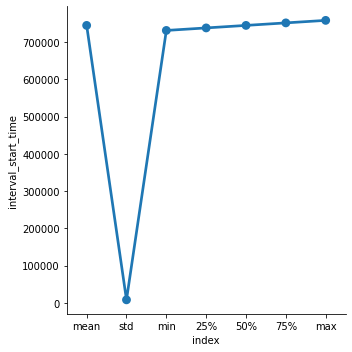

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



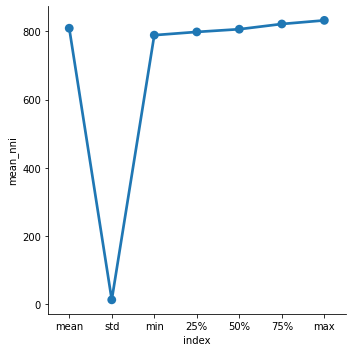

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



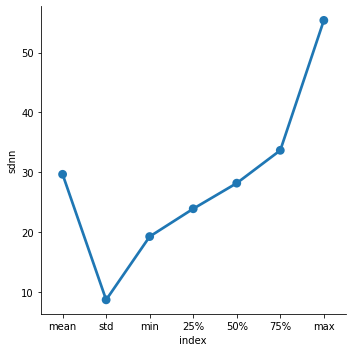

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



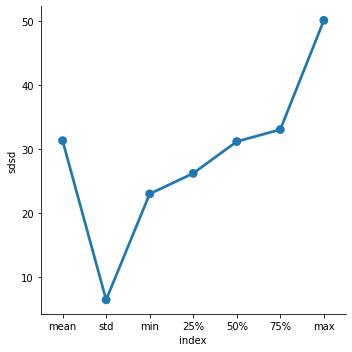

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



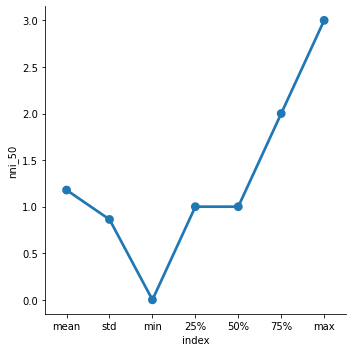

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



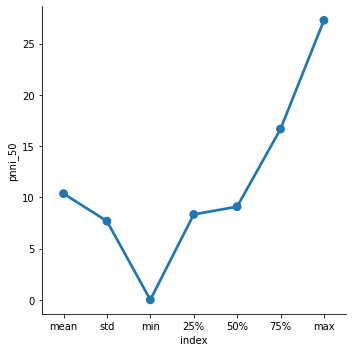

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



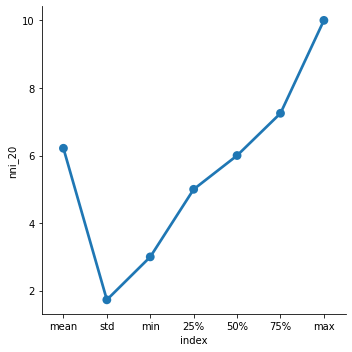

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



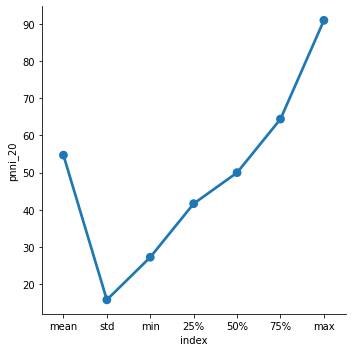

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



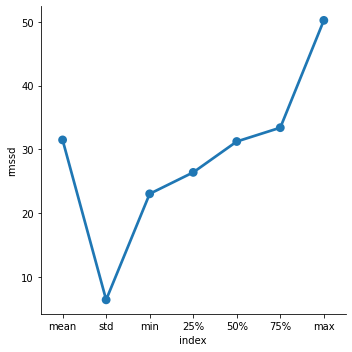

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



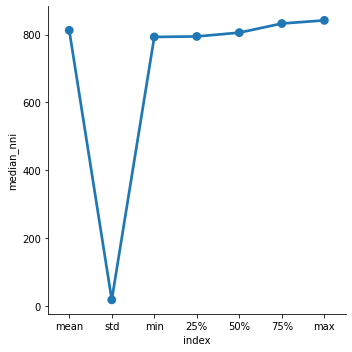

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



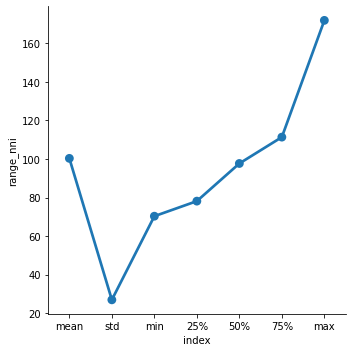

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



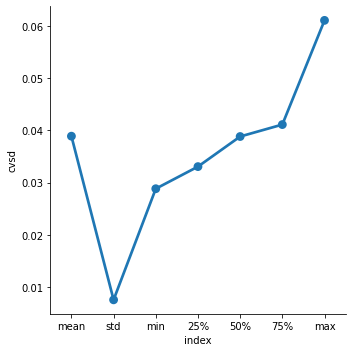

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



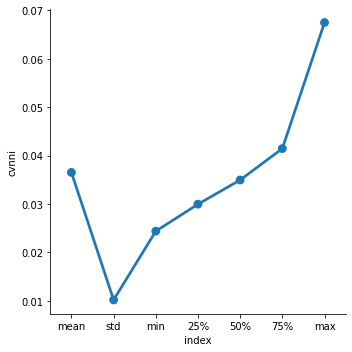

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



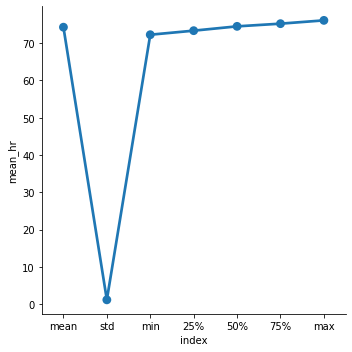

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



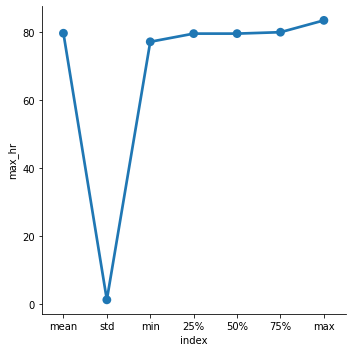

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



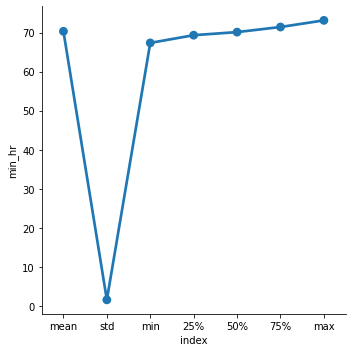

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



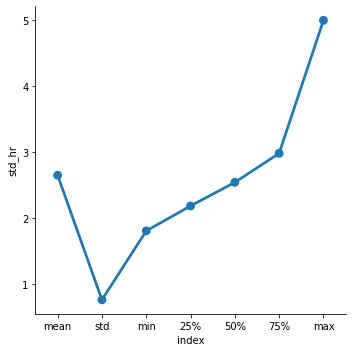

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



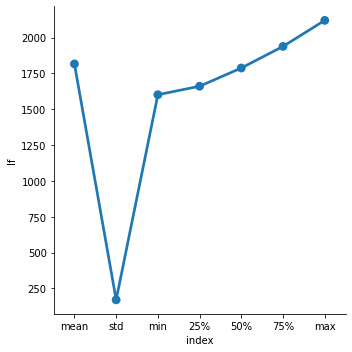

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



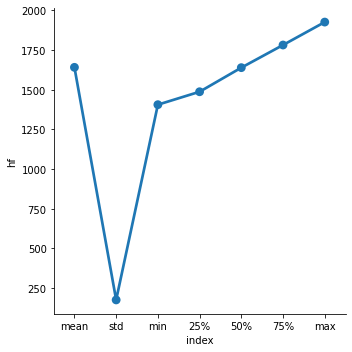

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



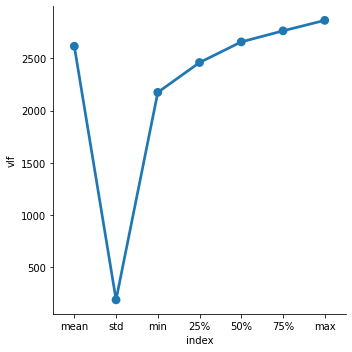

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



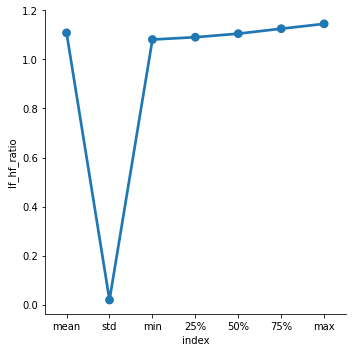

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



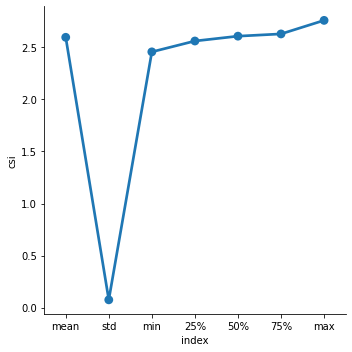

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



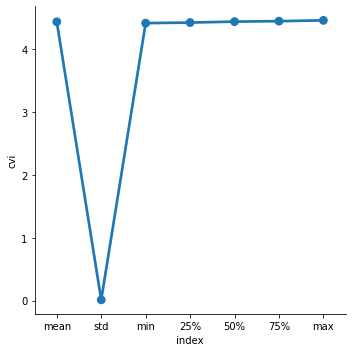

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



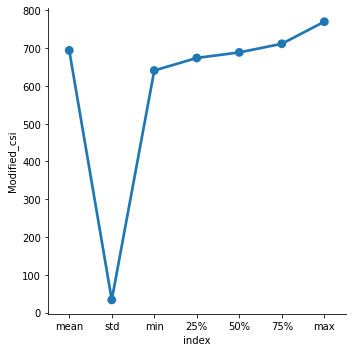

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



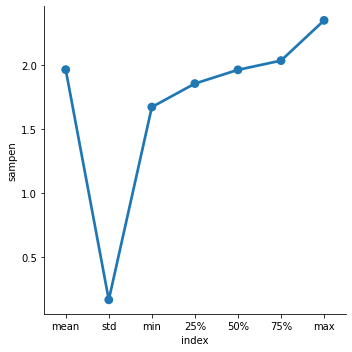

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



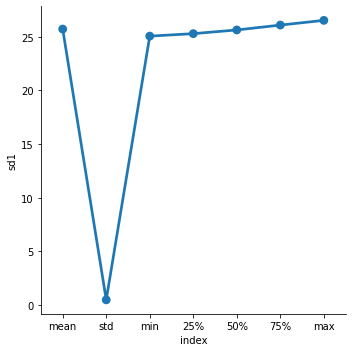

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



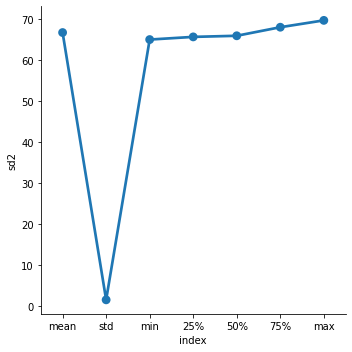

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



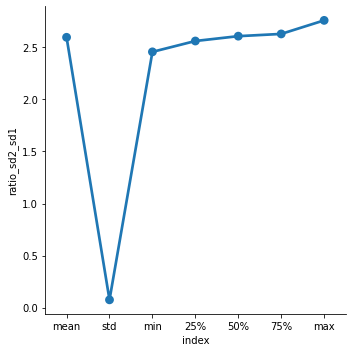

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



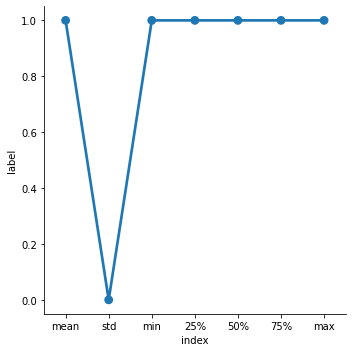

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



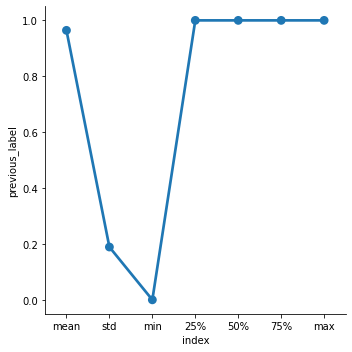

In [80]:
describe_seizure_period[0].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = describe_seizure_period[0][describe_seizure_period[0]['index'] != 'count']
for i in describe_seizure_period[0].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



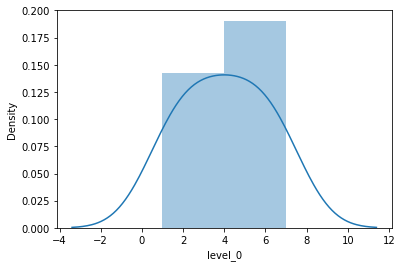

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



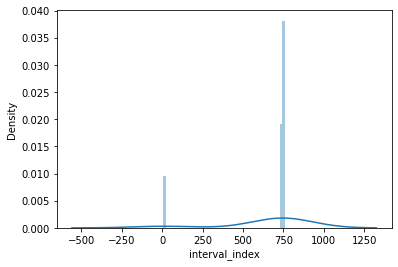

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



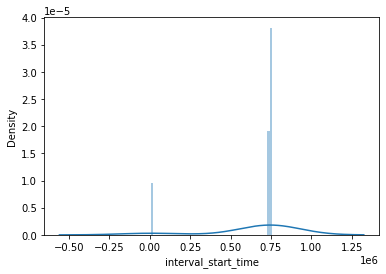

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



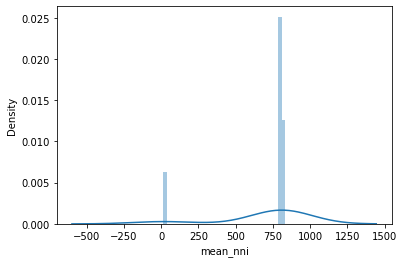

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



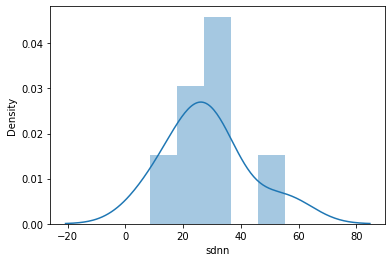

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



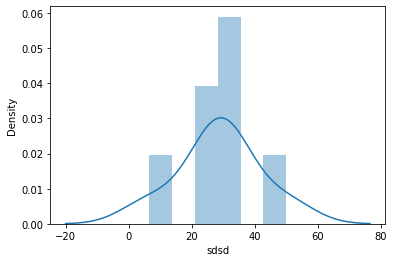

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



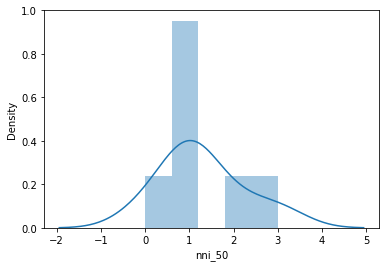

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



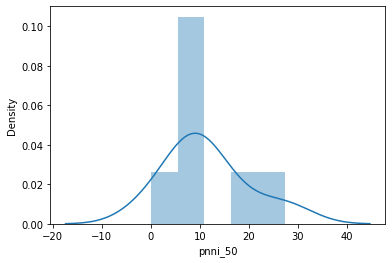

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



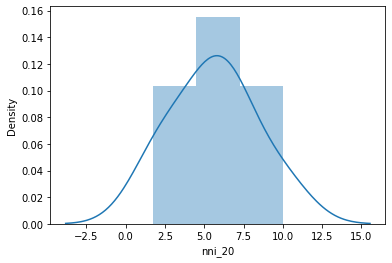

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



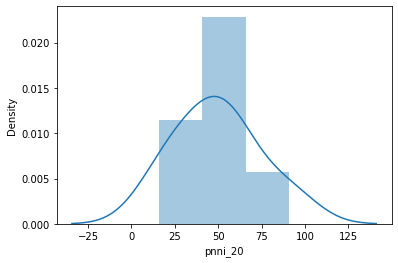

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



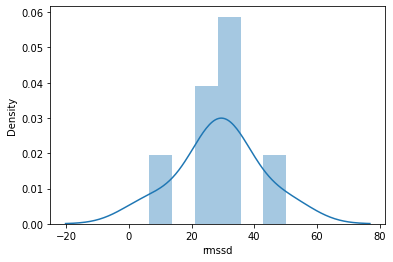

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



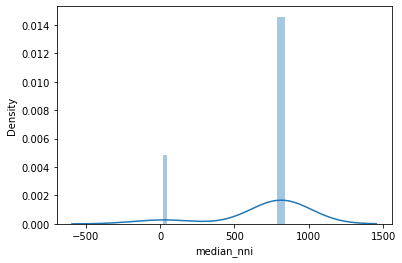

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



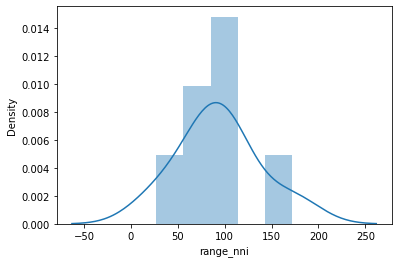

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



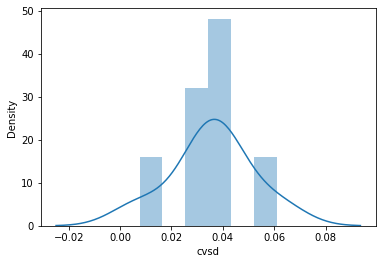

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



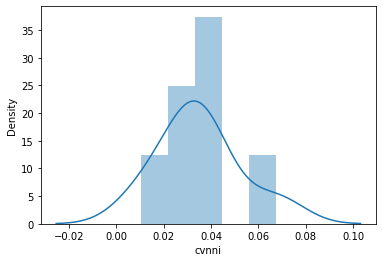

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



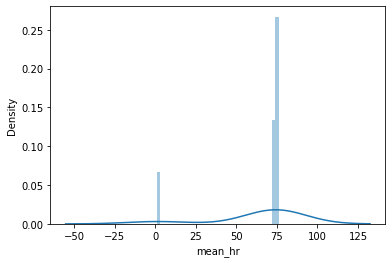

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



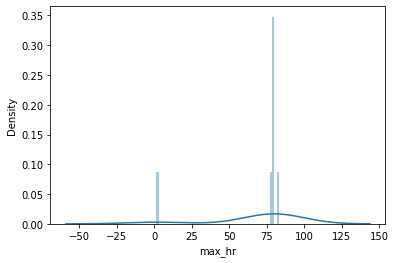

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



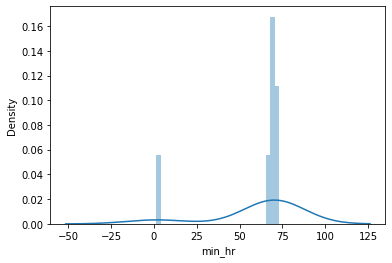

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



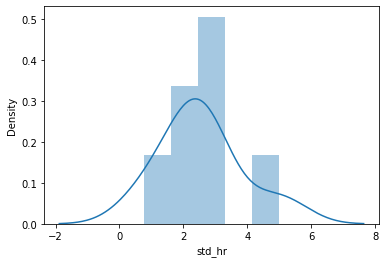

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



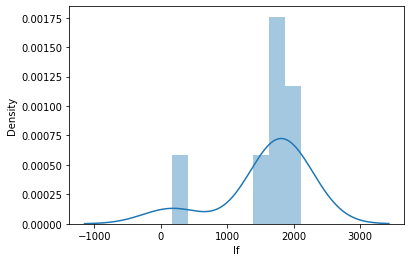

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



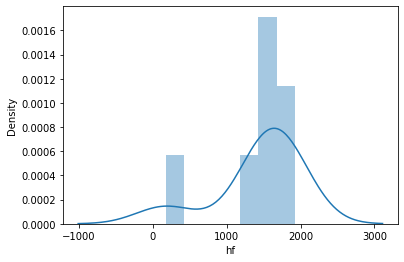

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



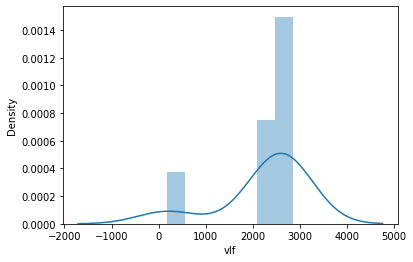

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



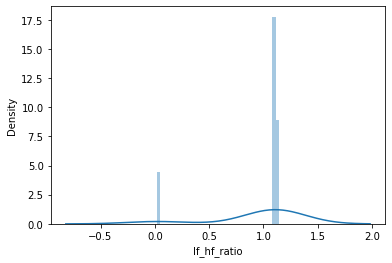

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



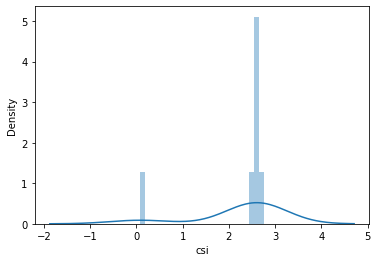

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



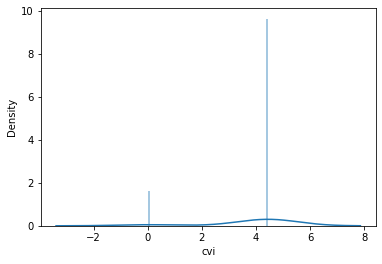

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



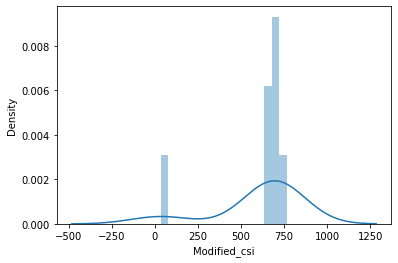

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



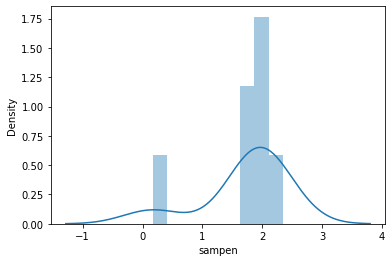

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



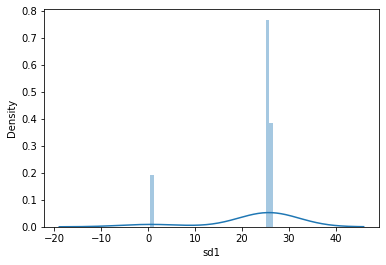

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



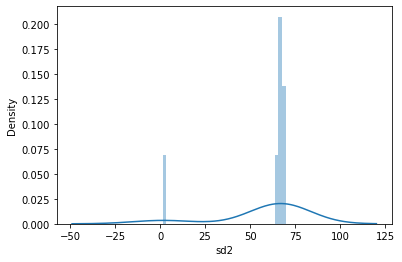

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



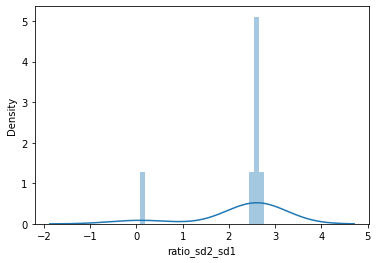

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



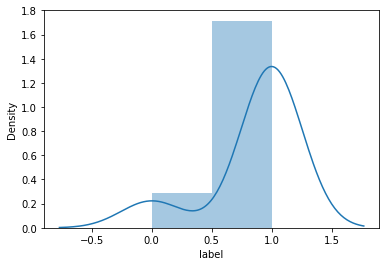

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



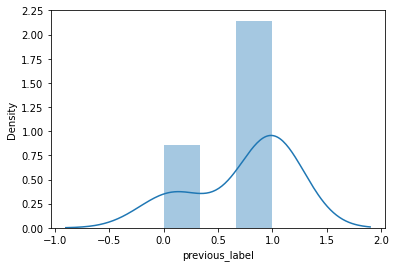

In [81]:
describe_seizure_period[0].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = describe_seizure_period[0][describe_seizure_period[0]['index'] != 'count']
for i in describe_seizure_period[0].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



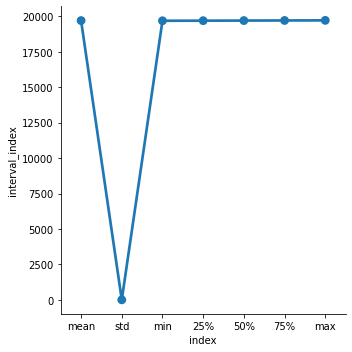

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



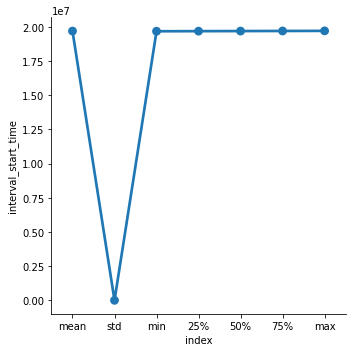

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



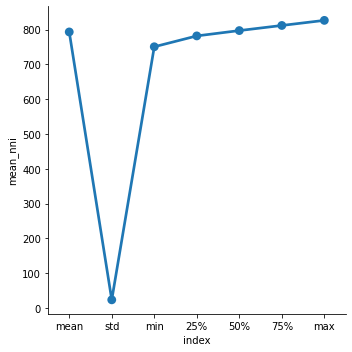

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



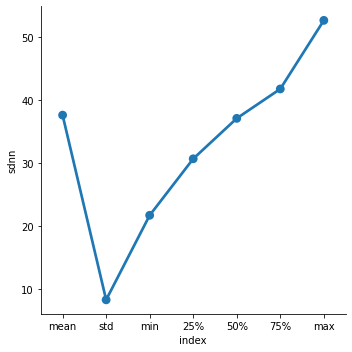

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



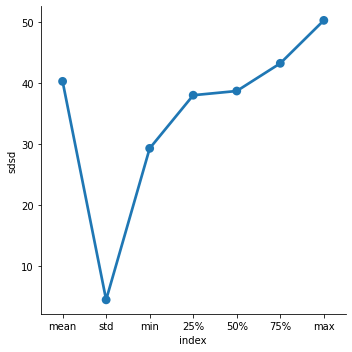

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



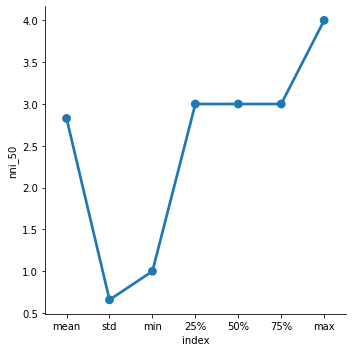

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



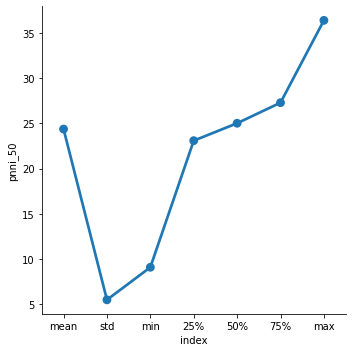

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



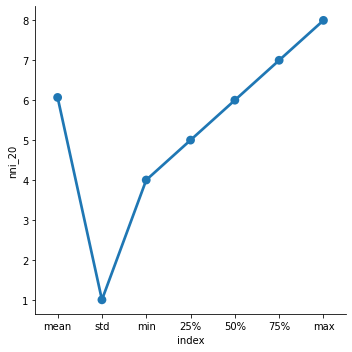

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



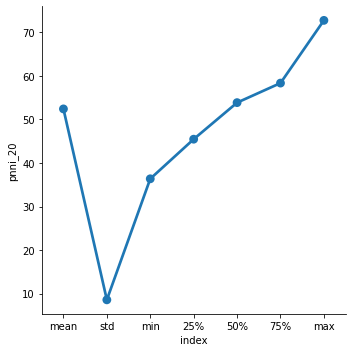

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



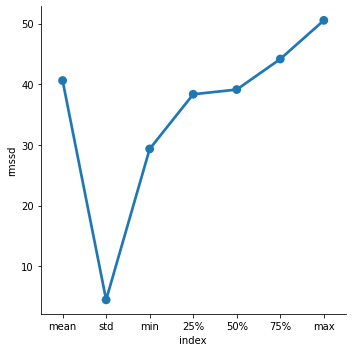

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



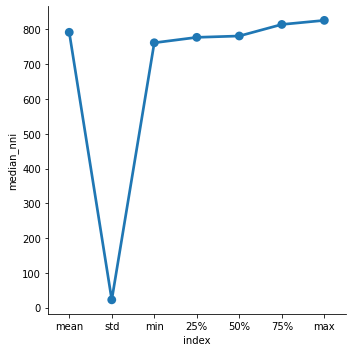

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



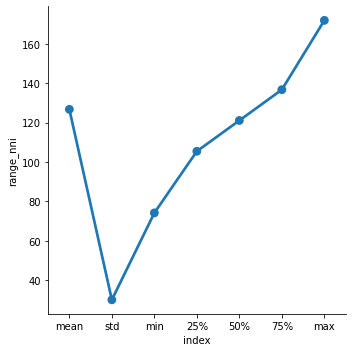

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



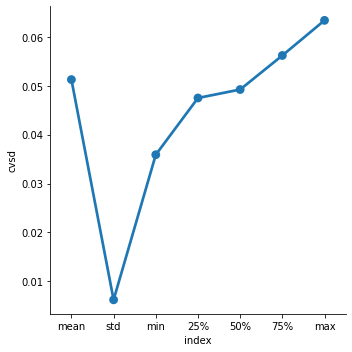

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



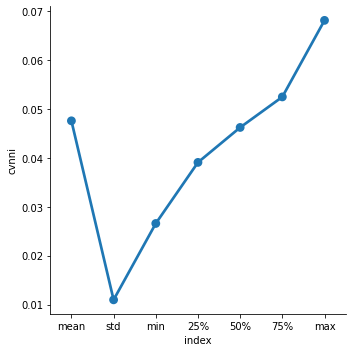

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



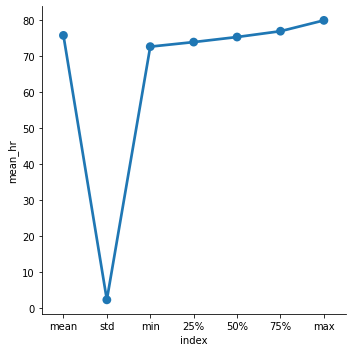

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



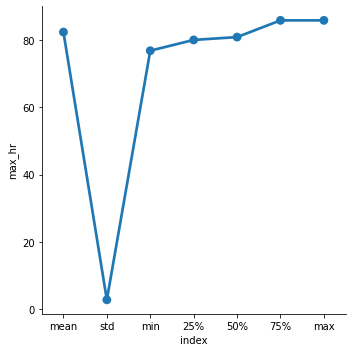

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



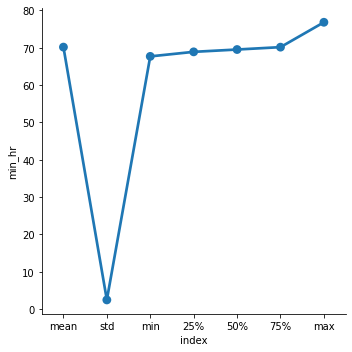

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



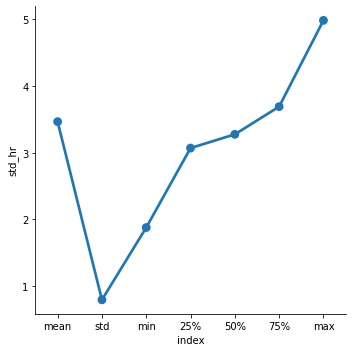

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



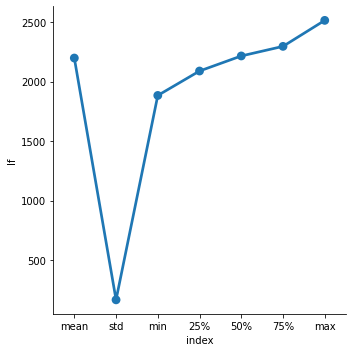

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



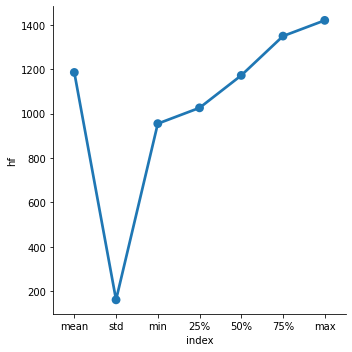

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



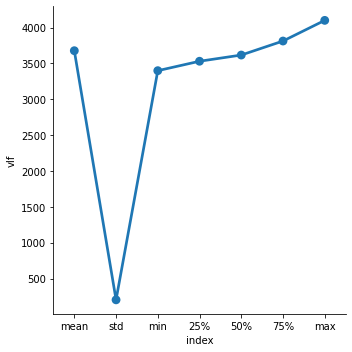

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



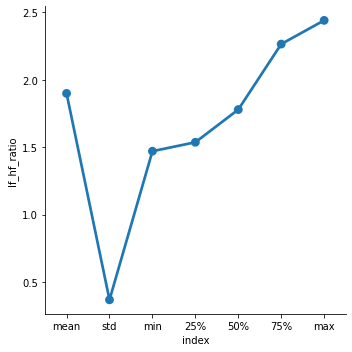

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



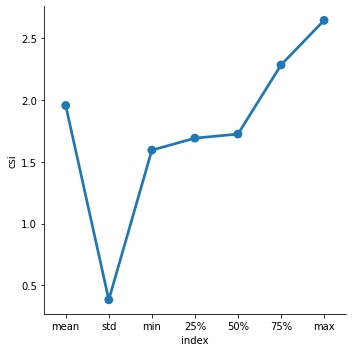

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



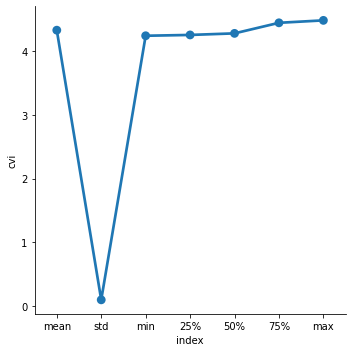

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



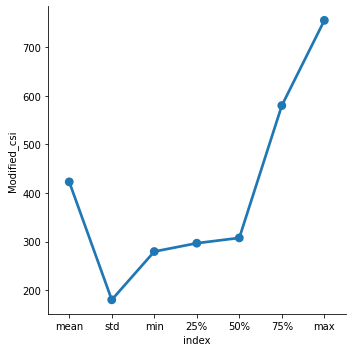

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



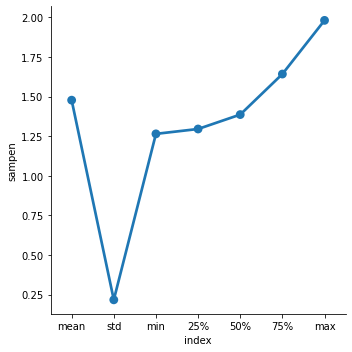

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



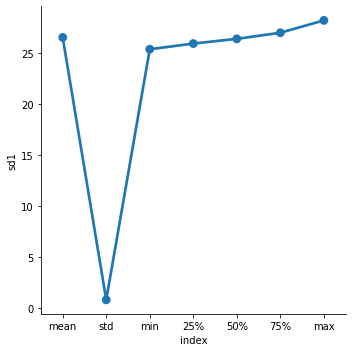

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



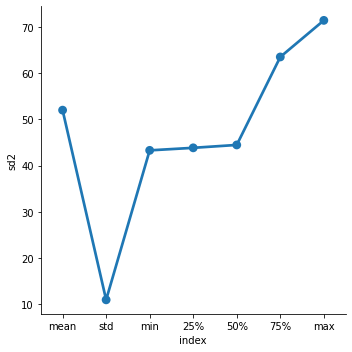

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



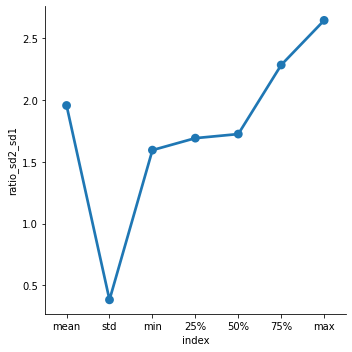

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



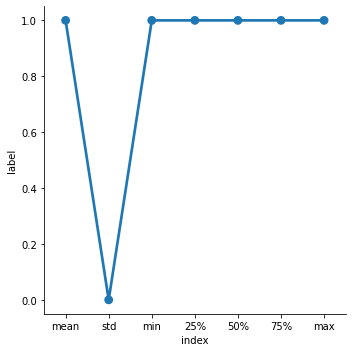

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



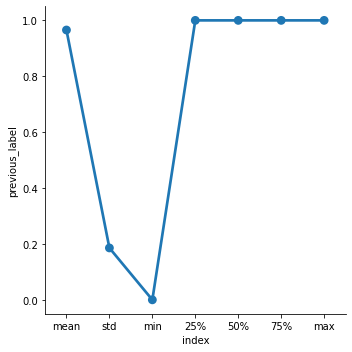

In [82]:
describe_seizure_period[8].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = describe_seizure_period[8][describe_seizure_period[8]['index'] != 'count']
for i in describe_seizure_period[8].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



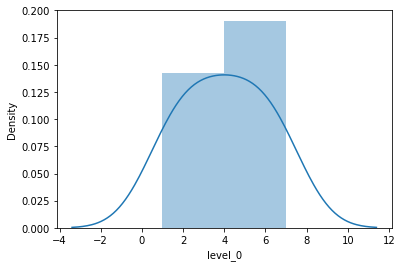

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



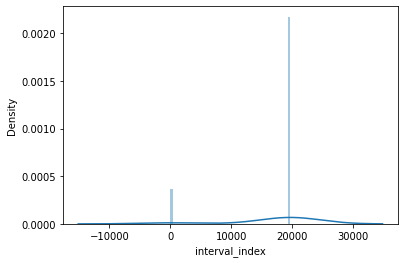

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



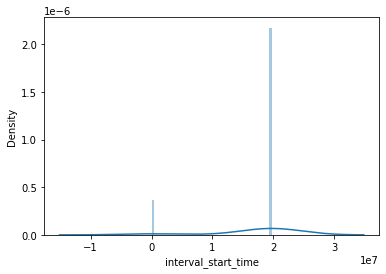

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



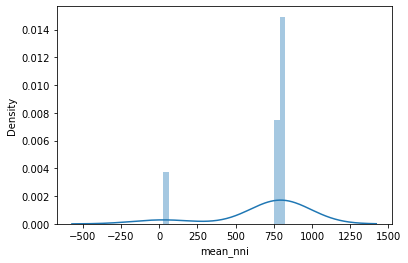

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



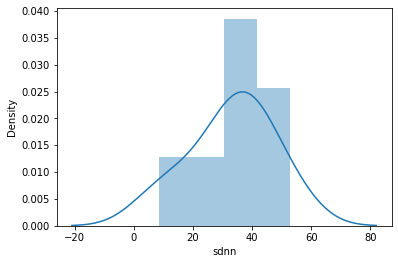

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



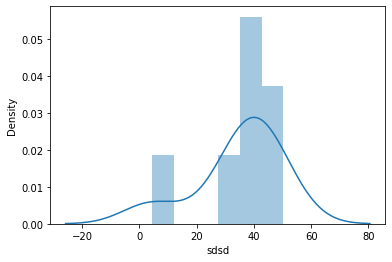

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



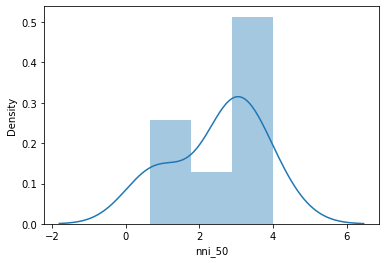

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



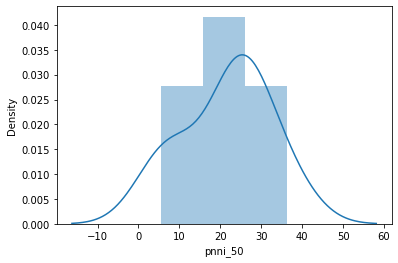

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



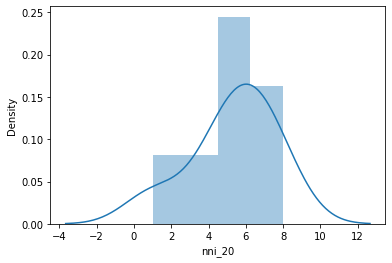

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



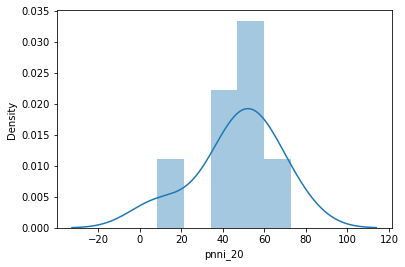

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



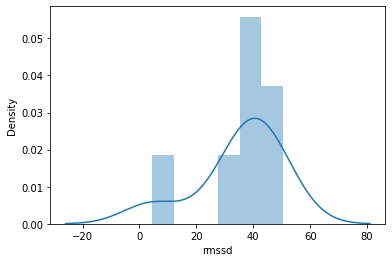

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



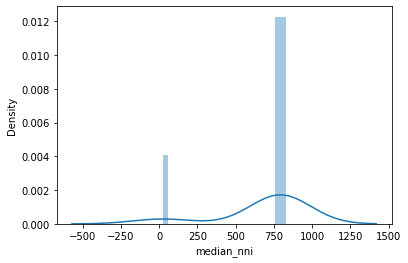

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



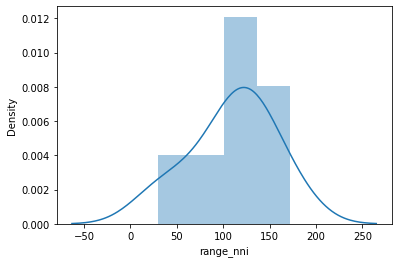

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



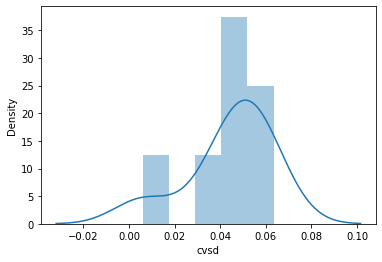

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



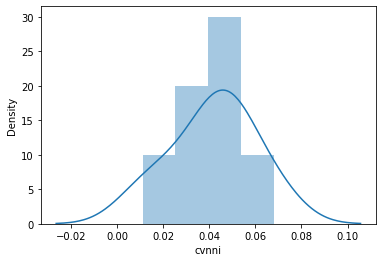

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



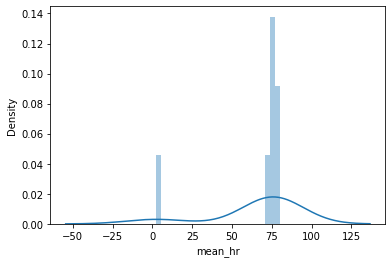

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



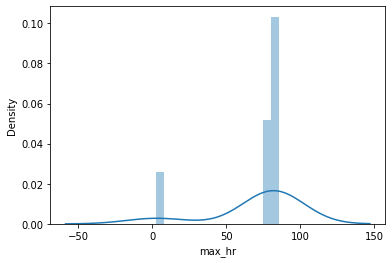

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



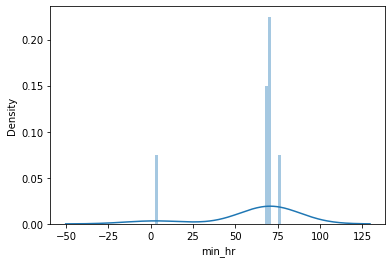

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



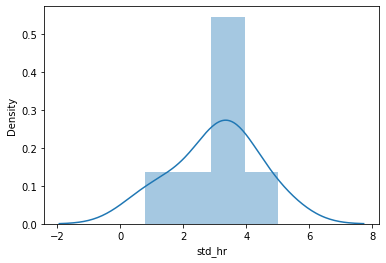

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



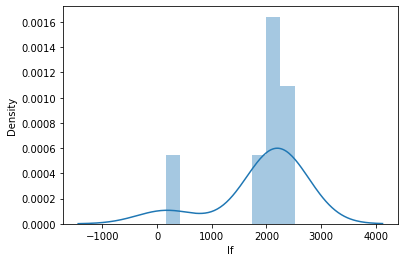

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



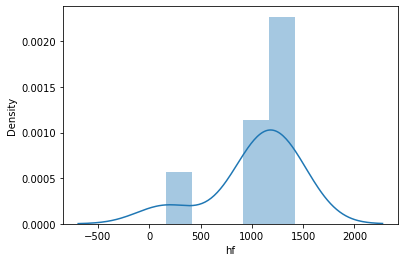

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



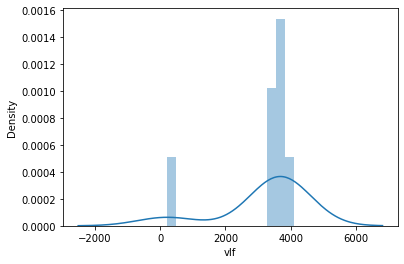

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



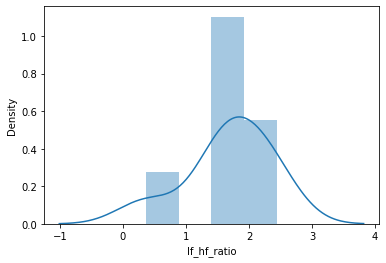

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



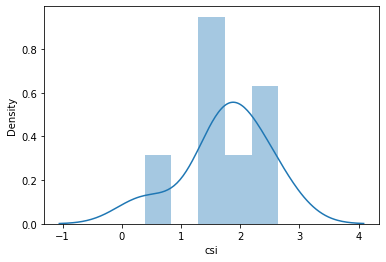

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



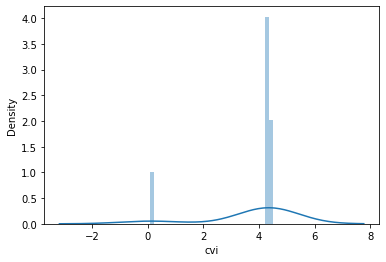

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



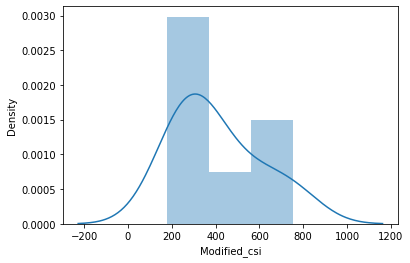

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



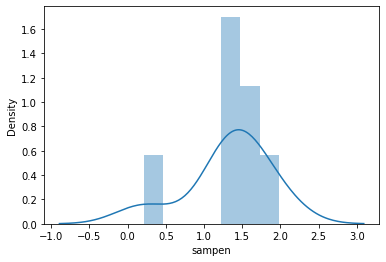

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



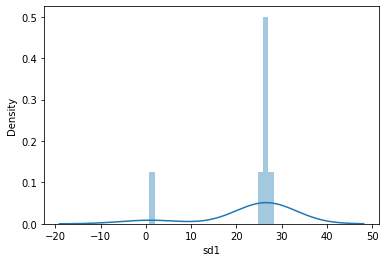

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



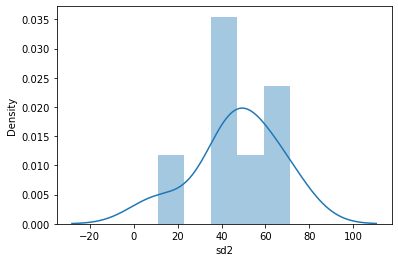

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



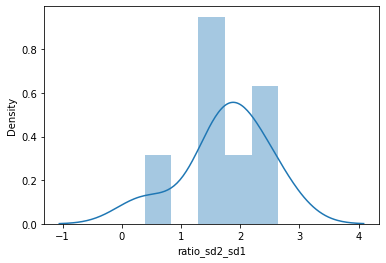

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



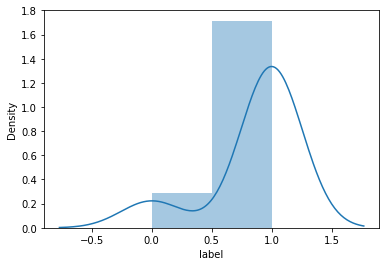

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



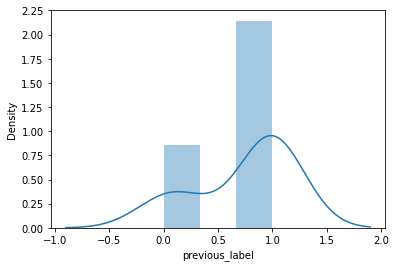

In [83]:
describe_seizure_period[8].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = describe_seizure_period[8][describe_seizure_period[8]['index'] != 'count']
for i in describe_seizure_period[8].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



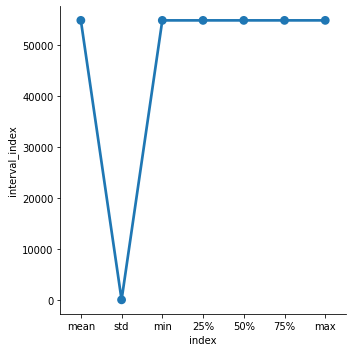

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



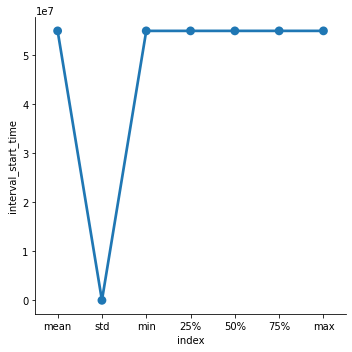

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



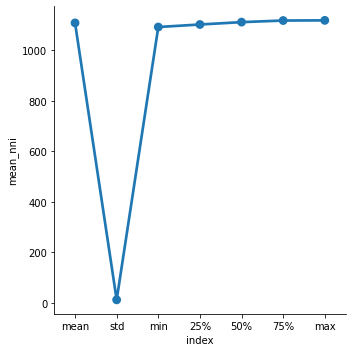

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



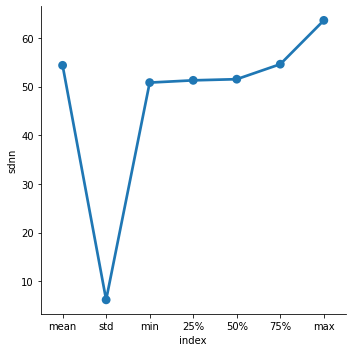

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



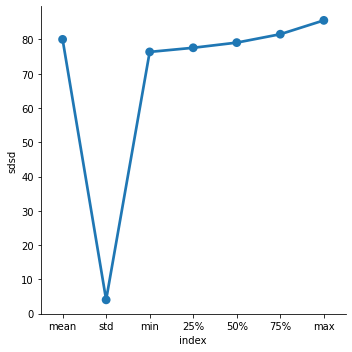

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



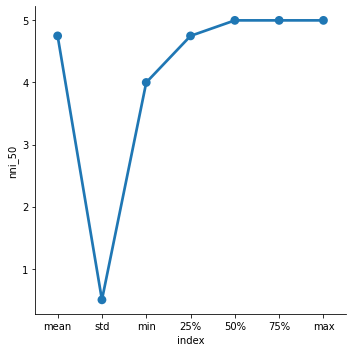

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



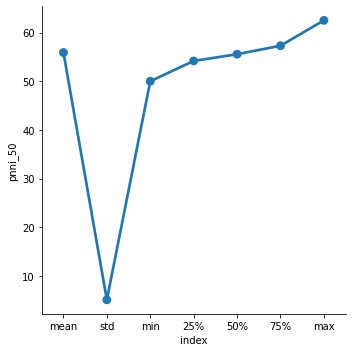

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



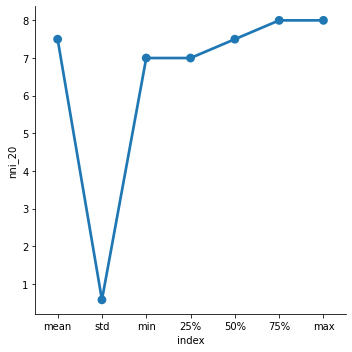

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



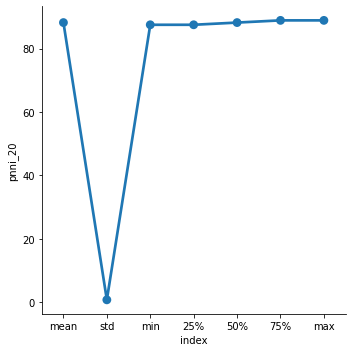

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



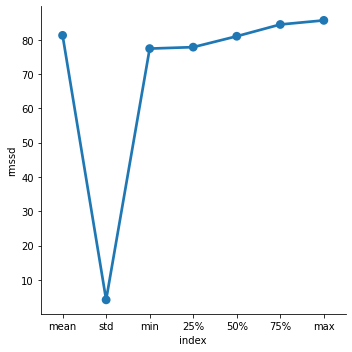

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



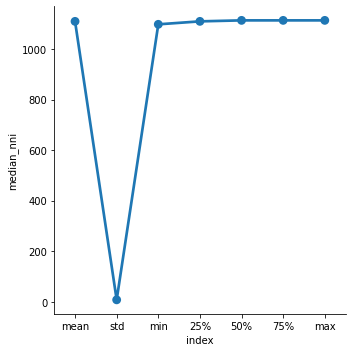

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



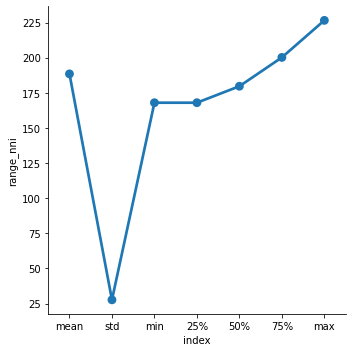

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



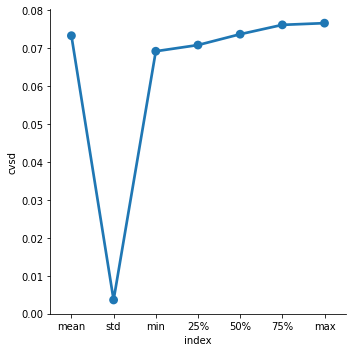

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



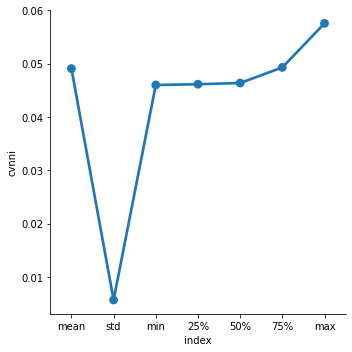

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



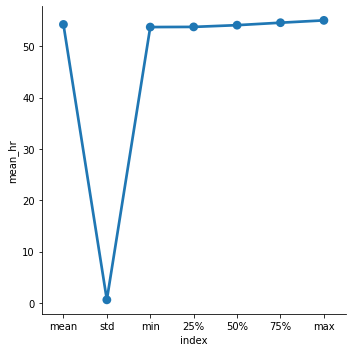

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



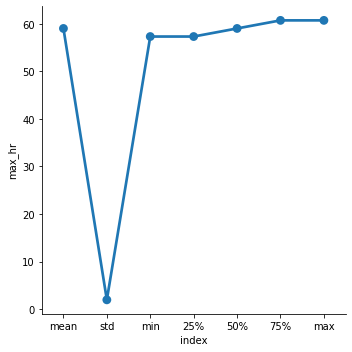

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



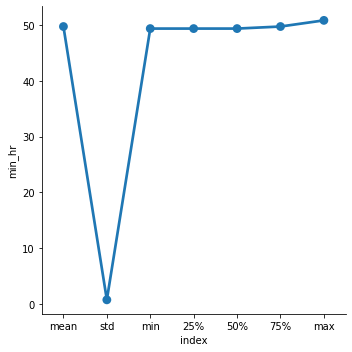

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



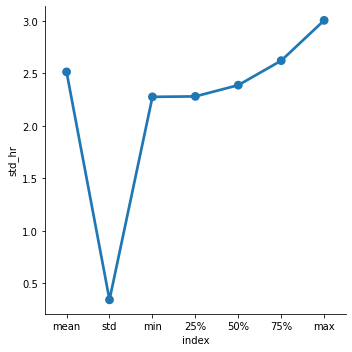

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



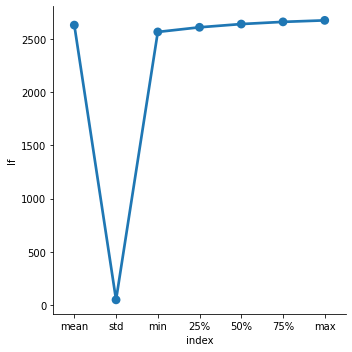

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



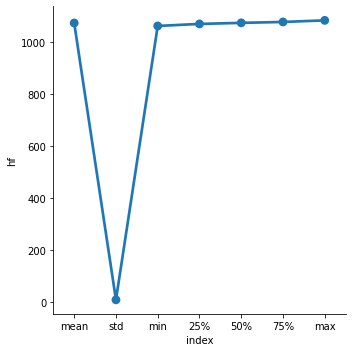

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



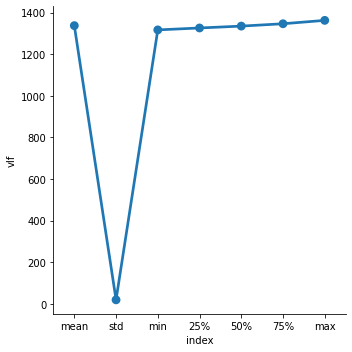

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



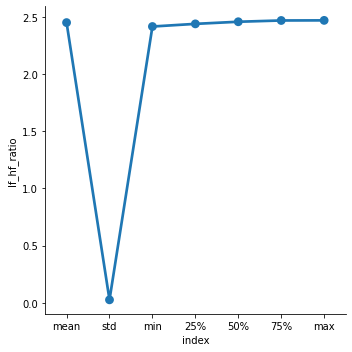

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



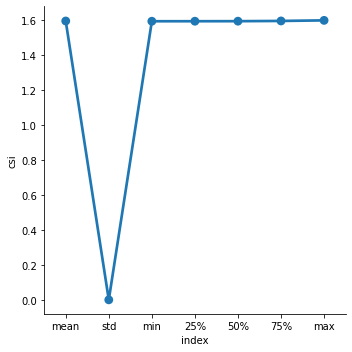

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



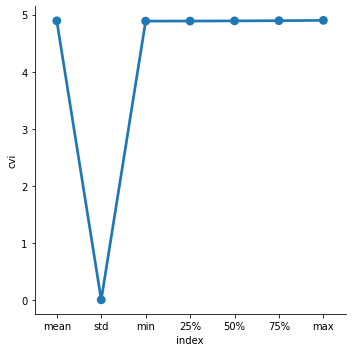

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



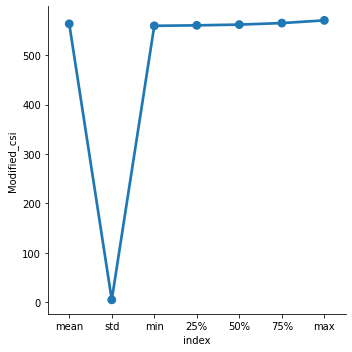

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



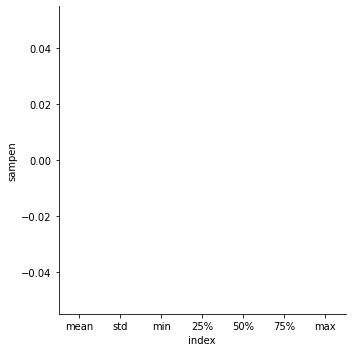

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



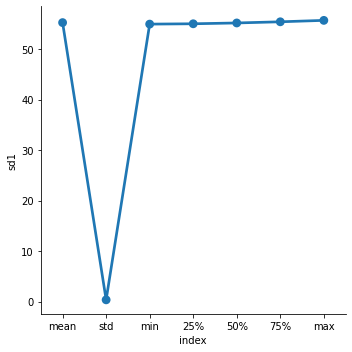

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



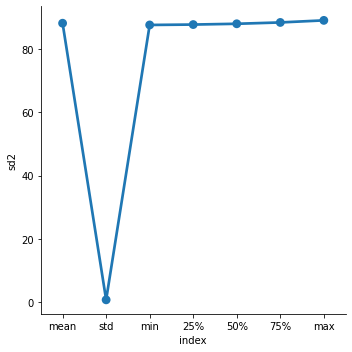

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



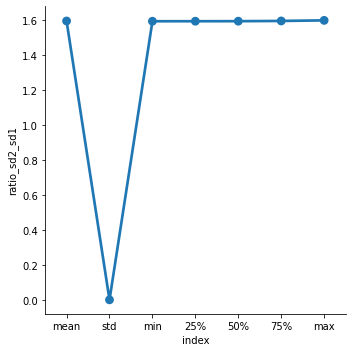

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



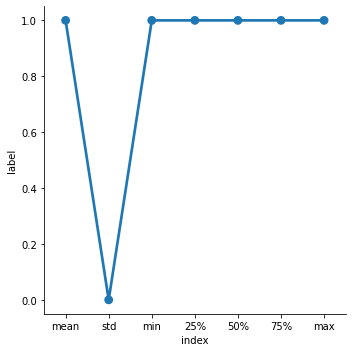

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



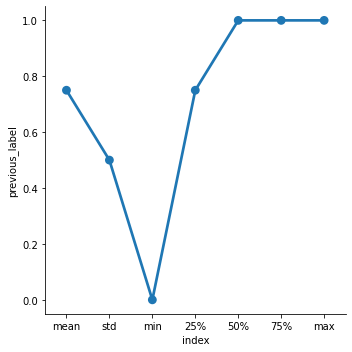

In [84]:
describe_seizure_period[23].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = describe_seizure_period[23][describe_seizure_period[23]['index'] != 'count']
for i in describe_seizure_period[23].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



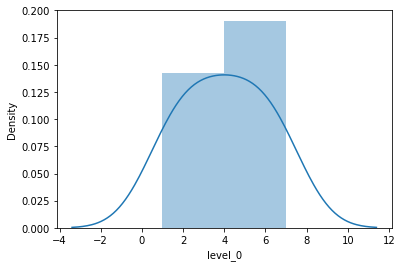

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



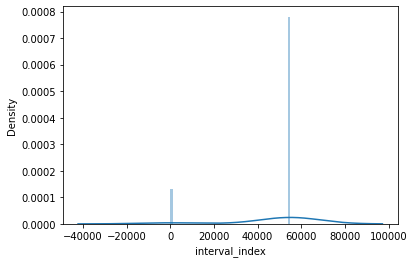

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



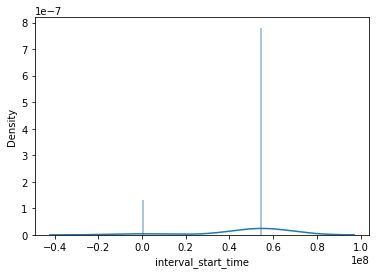

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



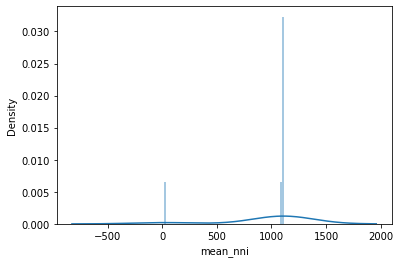

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



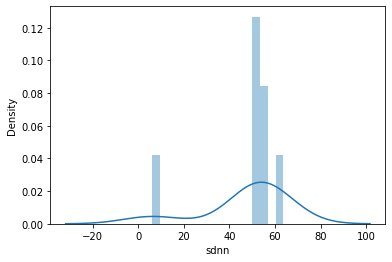

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



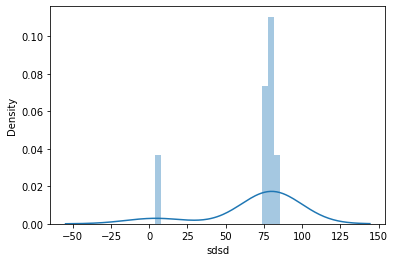

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



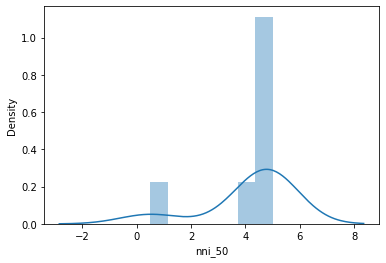

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



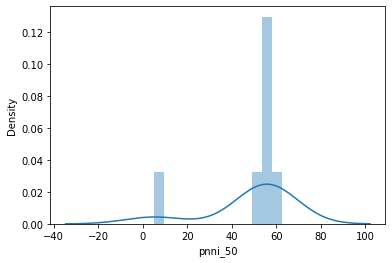

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



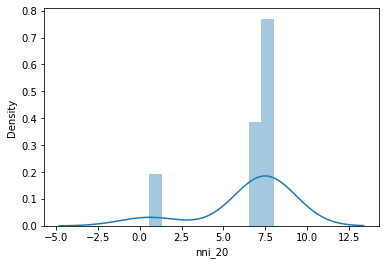

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



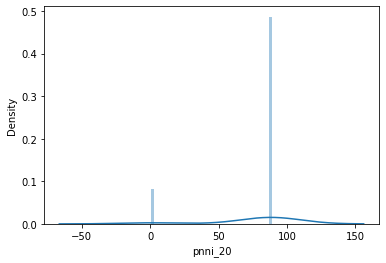

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



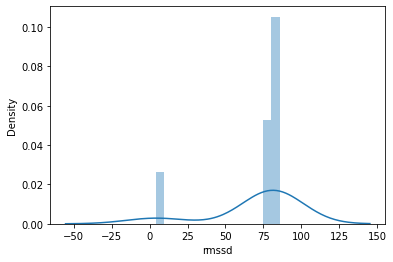

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



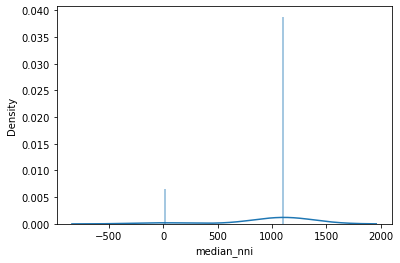

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



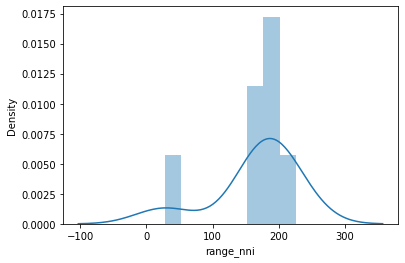

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



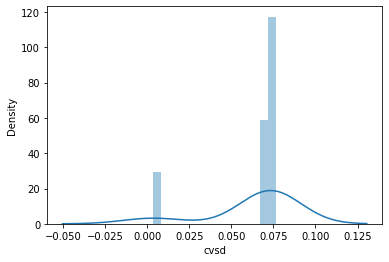

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



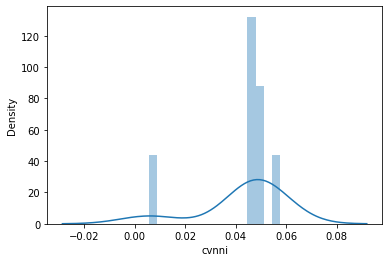

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



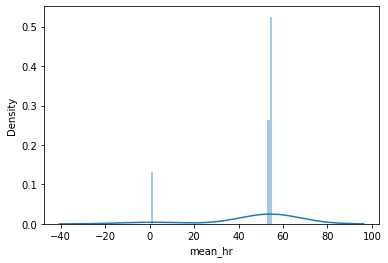

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



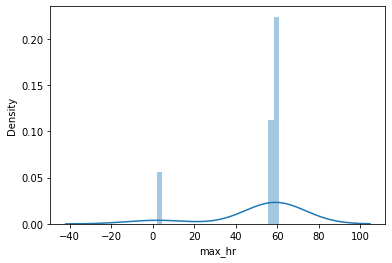

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



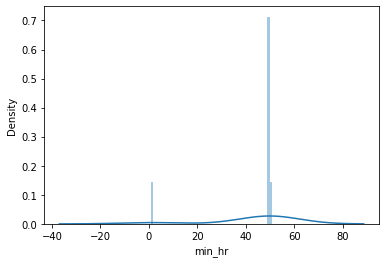

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



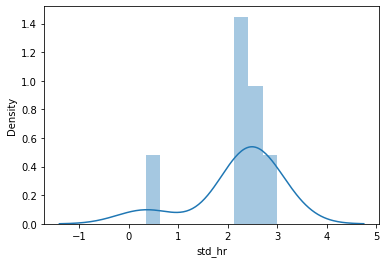

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



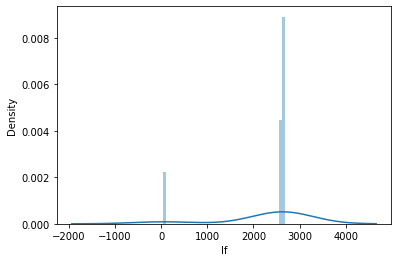

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



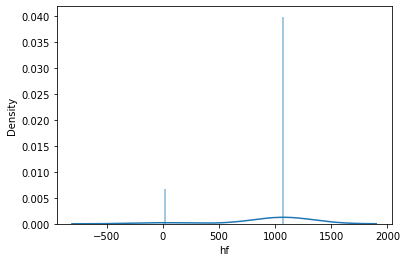

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



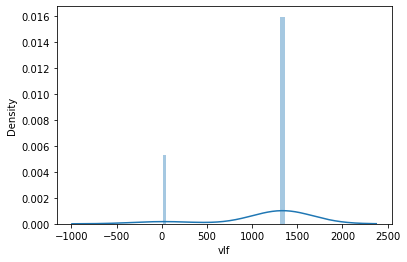

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



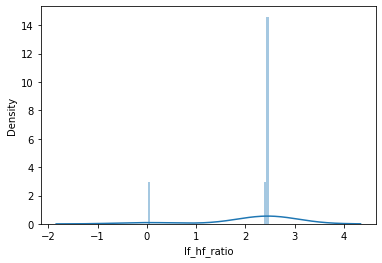

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



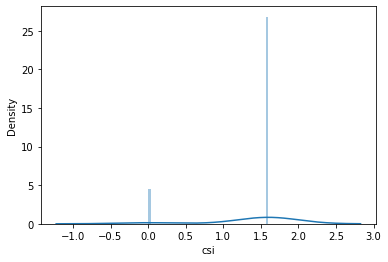

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



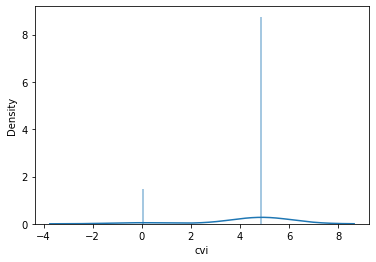

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



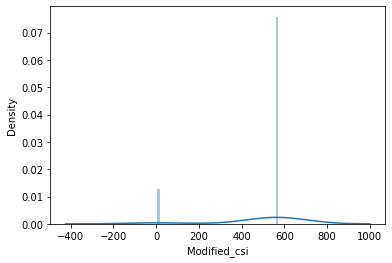

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/home/aura-sakhite/.local/lib/python3.6/site-packages/scipy/stats/stats.py:2848: RuntimeWarning:

invalid value encountered in subtract

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2465: RuntimeWarning:

invalid value encountered in double_scalars



ValueError: cannot convert float NaN to integer

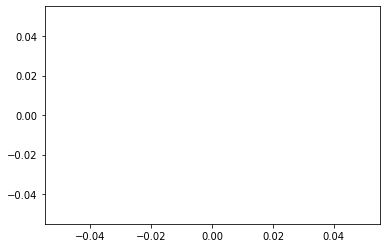

In [85]:
describe_seizure_period[23].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = describe_seizure_period[23][describe_seizure_period[23]['index'] != 'count']
for i in describe_seizure_period[23].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

In [86]:
# Create df_interseizures with detail of start and end of each interseizure
df_interseizure_50 = pd.DataFrame()
df_interseizure_50['start_date'] = df_session_50.loc[(df_session_50['label']==0) 
                                           & (df_session_50['change_of_state']), 'timestamp'].reset_index(
    drop=True)
df_interseizure_50['end_date'] = df_session_50.loc[(df_session_50['label']==0) 
                                         &(df_session_50['future_change_of_state']),'timestamp'].reset_index(
    drop=True)

df_interseizure_50['duration_sec'] = (pd.to_datetime(df_interseizure_50['end_date']) 
                             - pd.to_datetime(df_interseizure_50['start_date'])).apply(lambda x: 
                                                                                     x.total_seconds()+1)

In [87]:
df_interseizure_50.describe()

,duration_sec
count,28.000000
mean,2166.785714
std,2841.382832
min,60.000000
25%,238.250000
50%,823.500000
75%,3201.750000
max,11986.000000


In [88]:
df_interseizure_50

,start_date,end_date,duration_sec
0,2017-07-10 15:42:19.230468750,2017-07-10 15:54:28.230468750,730.0
1,2017-07-10 15:54:57.230468750,2017-07-10 17:23:06.230468750,5290.0
2,2017-07-10 17:23:19.230468750,2017-07-10 18:23:45.230468750,3627.0
3,2017-07-10 18:24:03.230468750,2017-07-10 18:32:46.230468750,524.0
4,2017-07-10 18:33:04.230468750,2017-07-10 19:10:59.230468750,2276.0
5,2017-07-10 19:11:17.230468750,2017-07-10 19:26:33.230468750,917.0
6,2017-07-10 19:26:42.230468750,2017-07-10 19:41:58.230468750,917.0
7,2017-07-10 19:42:20.230468750,2017-07-10 21:02:59.230468750,4840.0
8,2017-07-10 21:03:27.230468750,2017-07-10 21:10:20.230468750,414.0
9,2017-07-10 21:10:50.230468750,2017-07-10 21:21:46.230468750,657.0


<AxesSubplot:title={'center':'Duree des interseizures du patient 50'}>

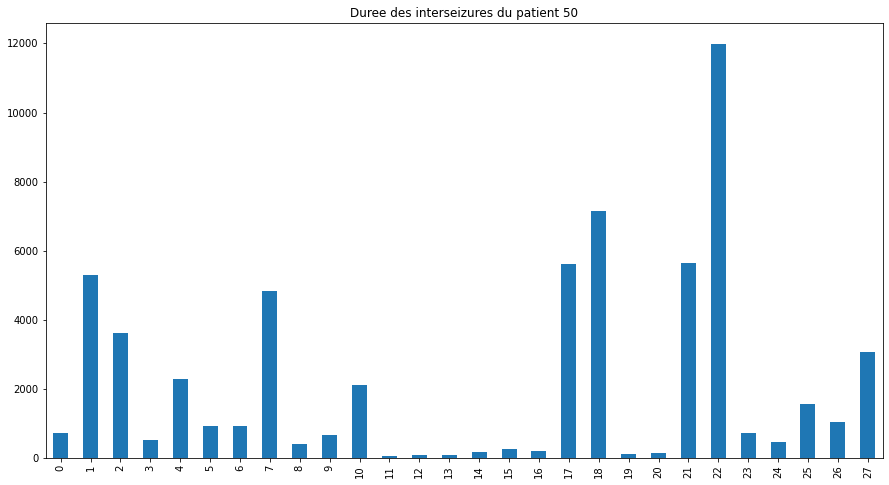

In [89]:
plt.figure(figsize=(15,8))
df_interseizure_50.duration_sec.plot(kind="bar", title="Duree des interseizures du patient 50")

In [90]:
interseizure_50_period = {}
for index, row in df_interseizure_50.iterrows():
    interseizure_50_period[index]=df_session_50_copy.loc[row['start_date']:row['end_date']].describe()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



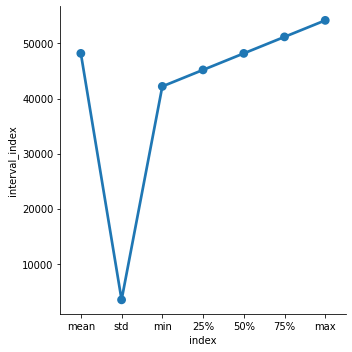

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



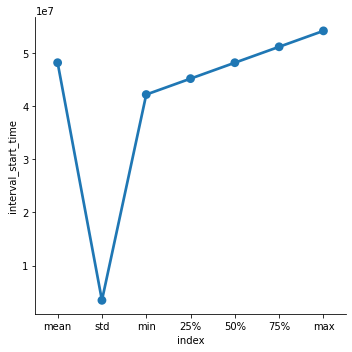

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



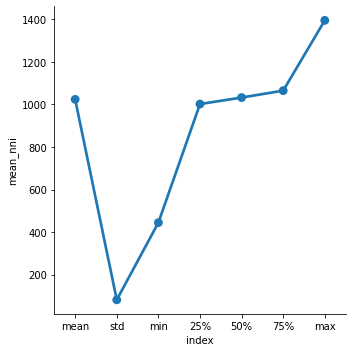

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



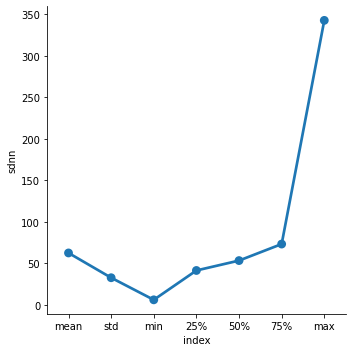

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



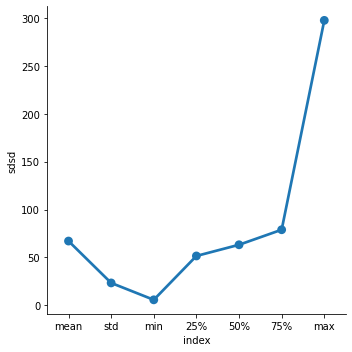

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



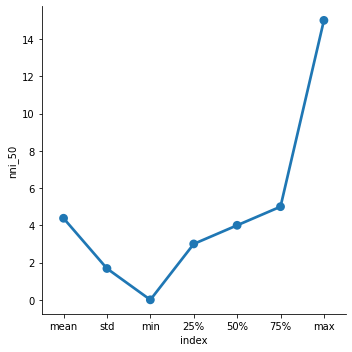

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



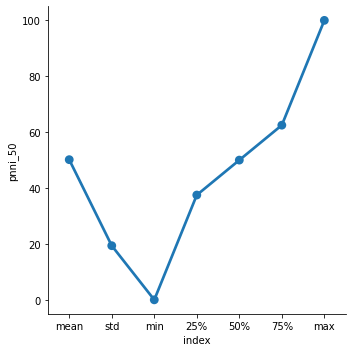

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



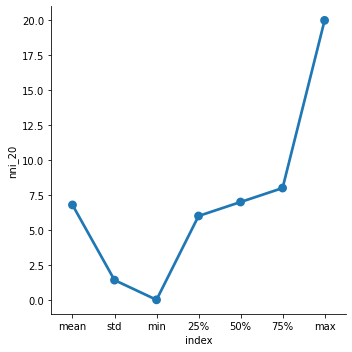

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



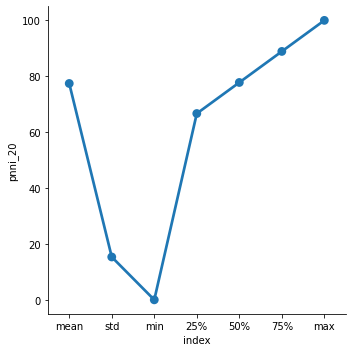

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



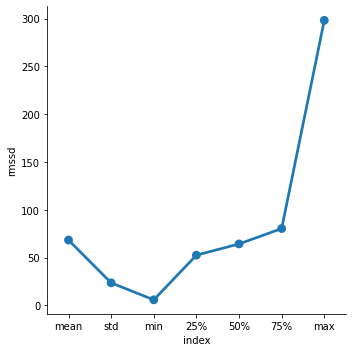

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



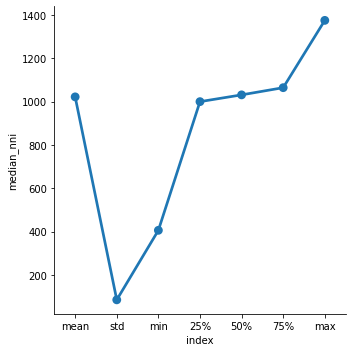

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



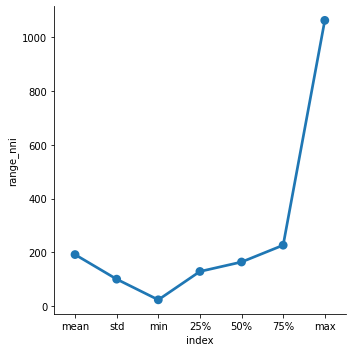

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



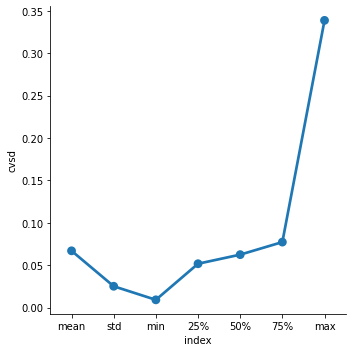

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



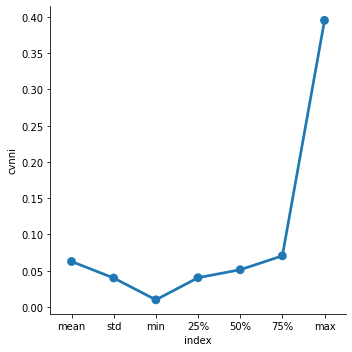

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



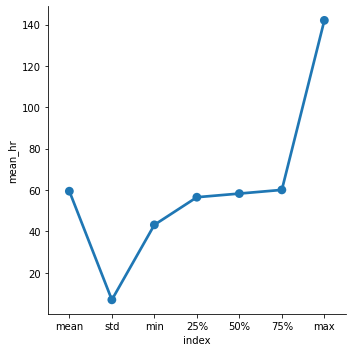

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



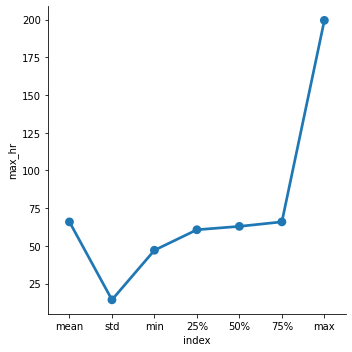

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



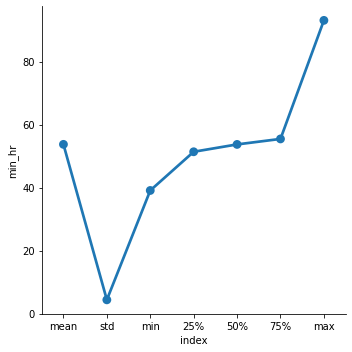

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



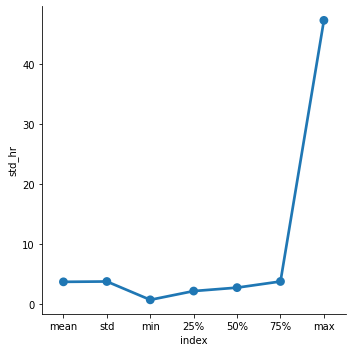

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



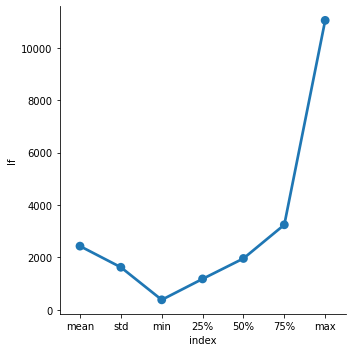

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



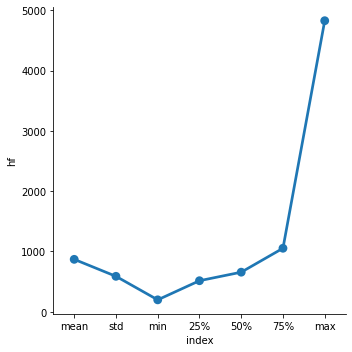

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



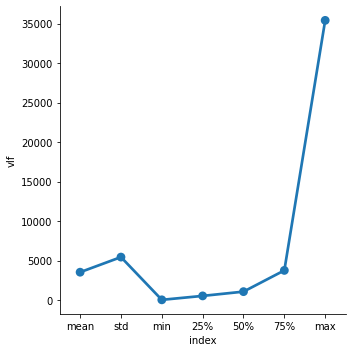

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



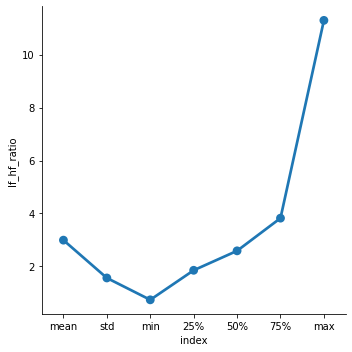

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



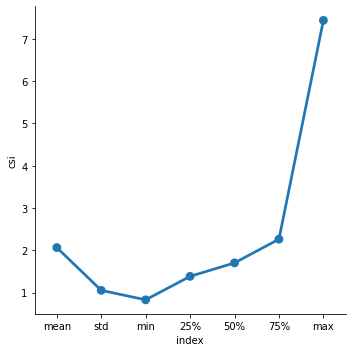

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



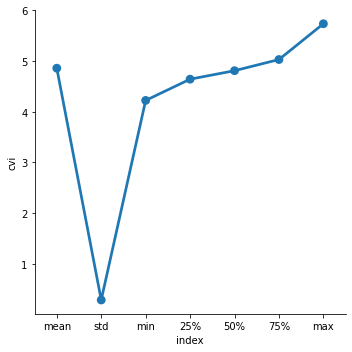

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



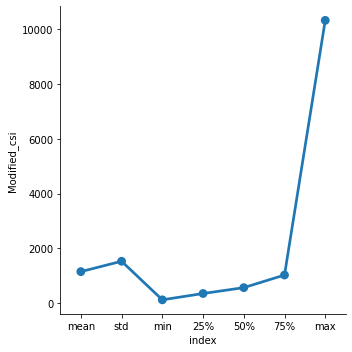

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



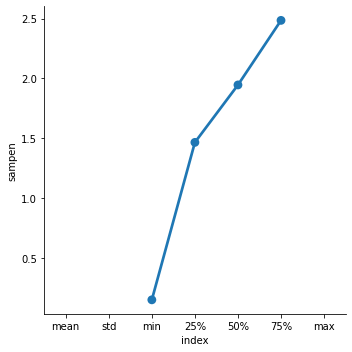

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



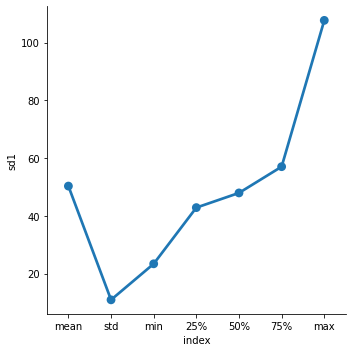

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



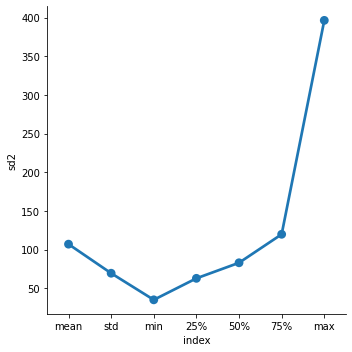

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



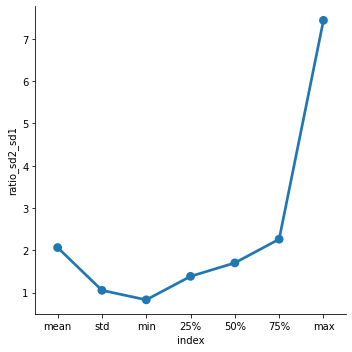

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



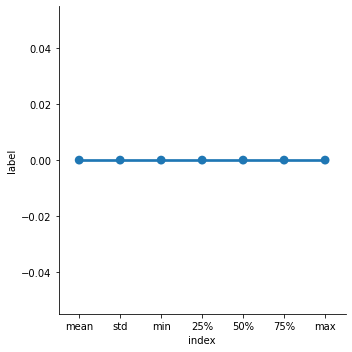

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



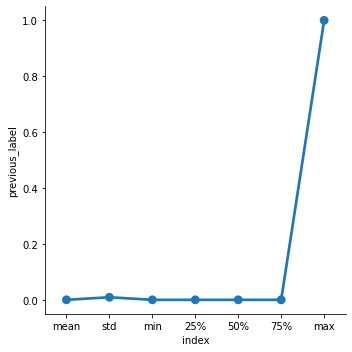

In [91]:
interseizure_50_period[22].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = interseizure_50_period[22][interseizure_50_period[22]['index'] != 'count']
for i in interseizure_50_period[22].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



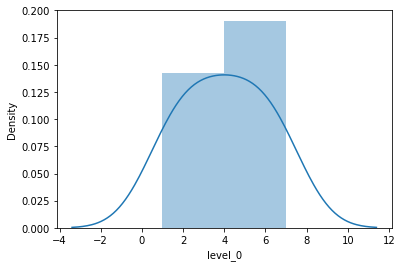

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



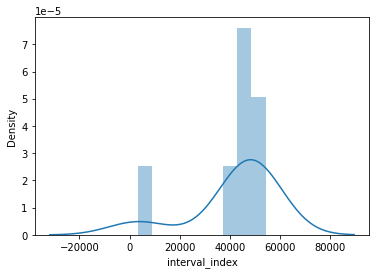

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



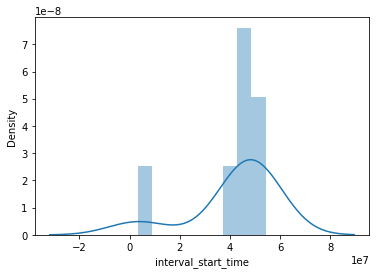

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



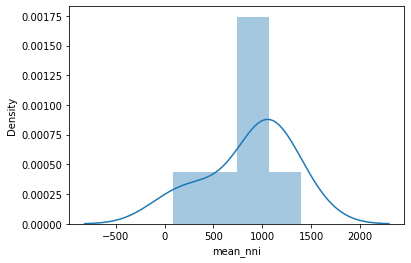

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



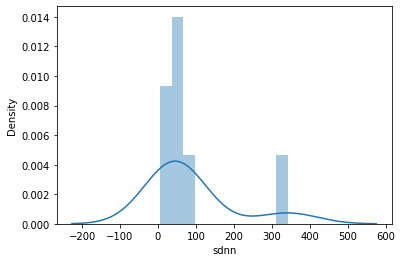

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



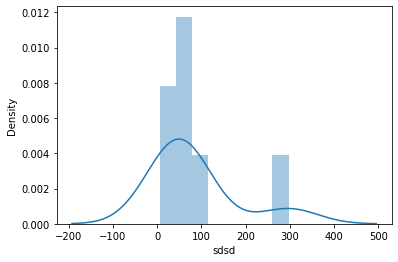

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



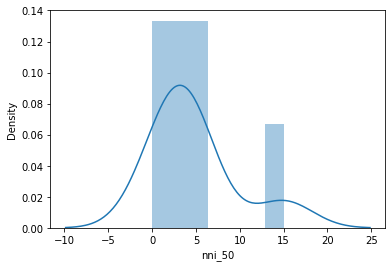

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



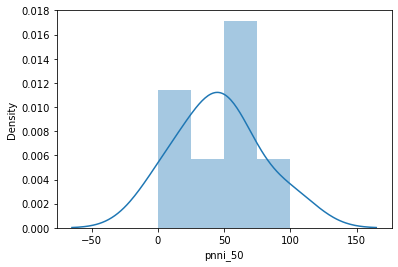

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



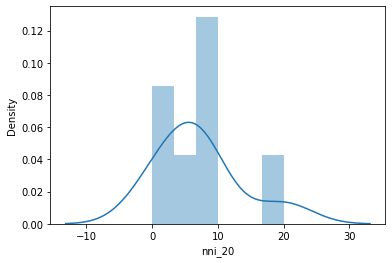

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



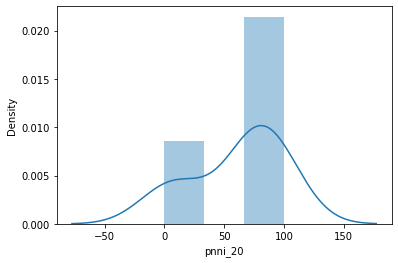

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



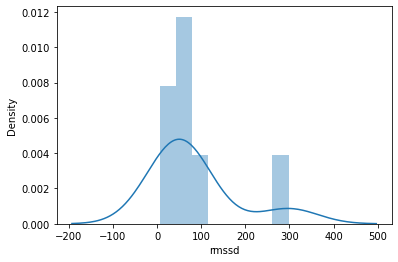

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



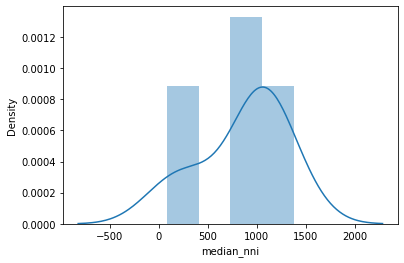

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



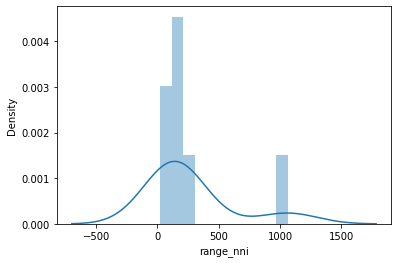

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



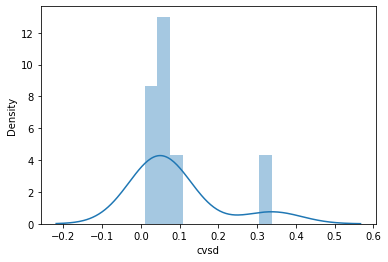

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



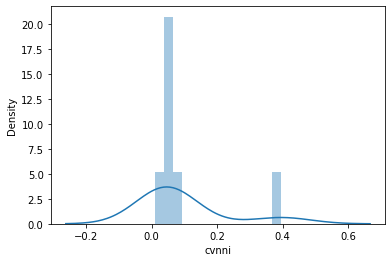

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



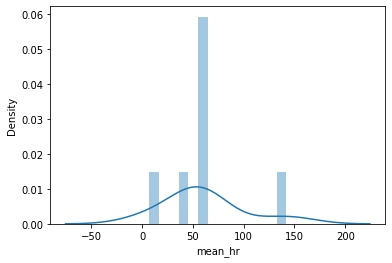

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



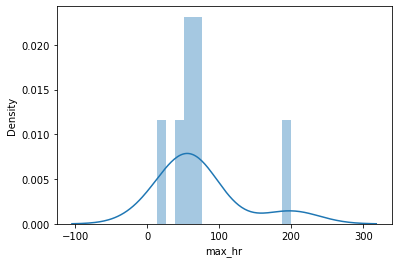

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



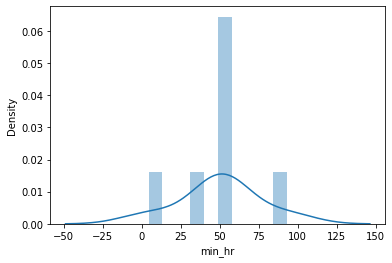

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



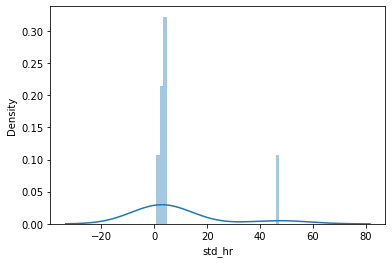

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



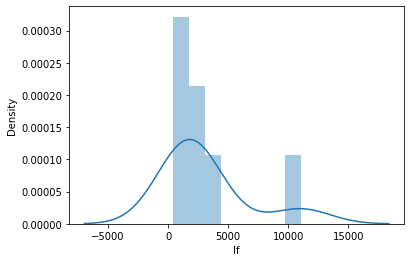

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



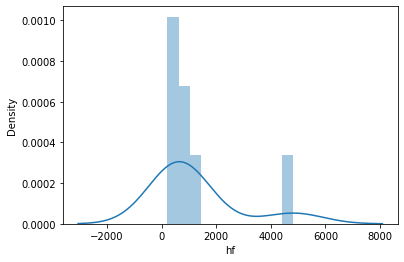

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



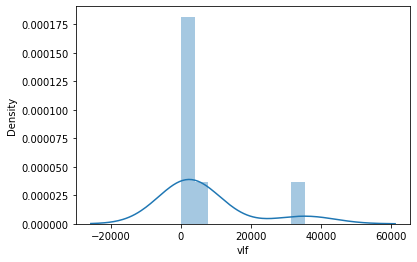

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



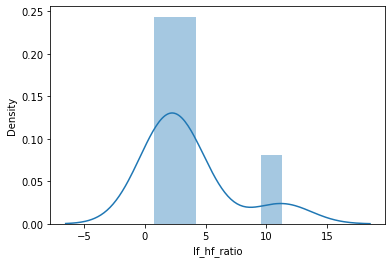

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



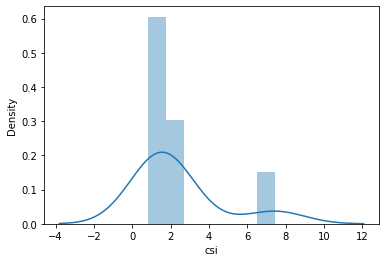

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



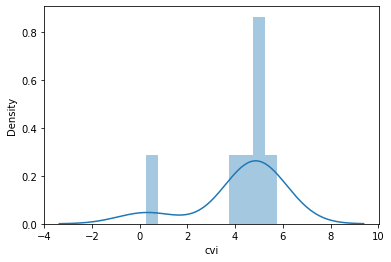

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



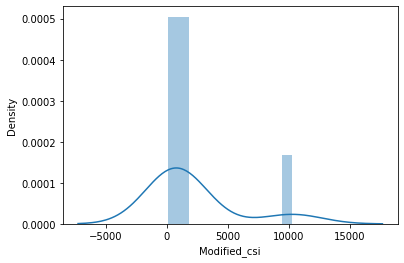

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2465: RuntimeWarning:

invalid value encountered in double_scalars



ValueError: cannot convert float NaN to integer

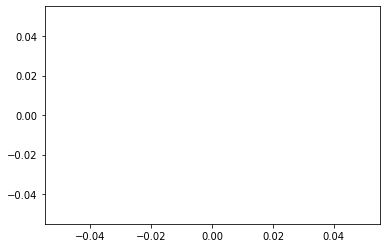

In [92]:
interseizure_50_period[22].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = interseizure_50_period[22][interseizure_50_period[22]['index'] != 'count']
for i in interseizure_50_period[22].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



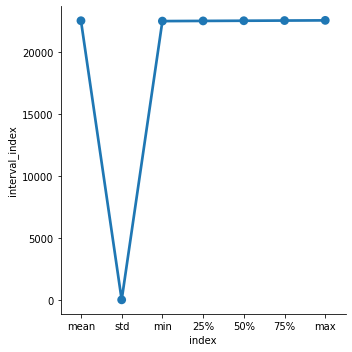

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



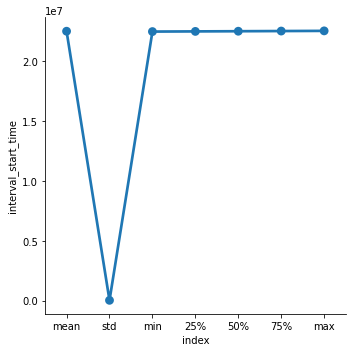

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



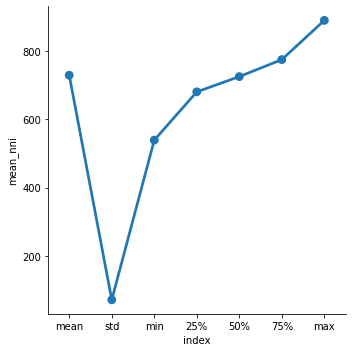

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



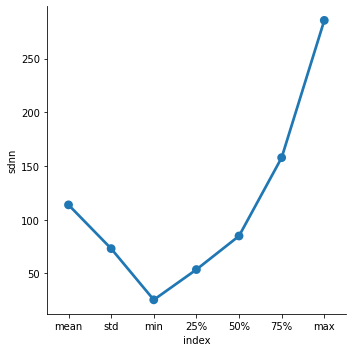

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



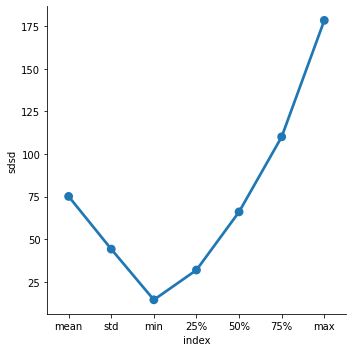

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



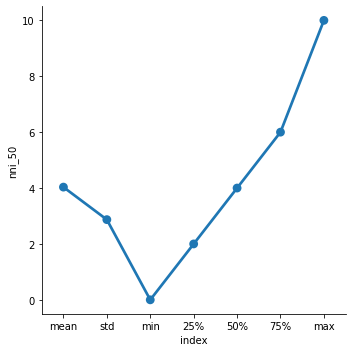

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



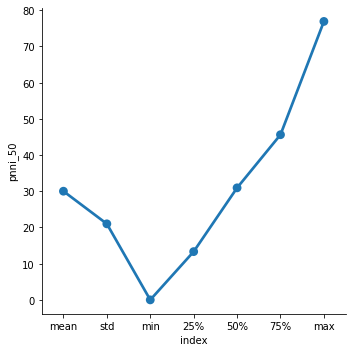

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



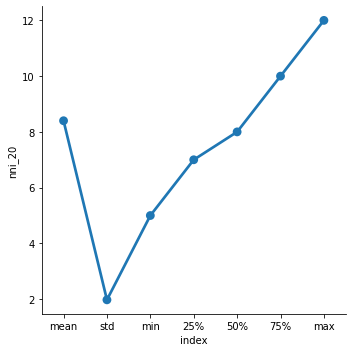

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



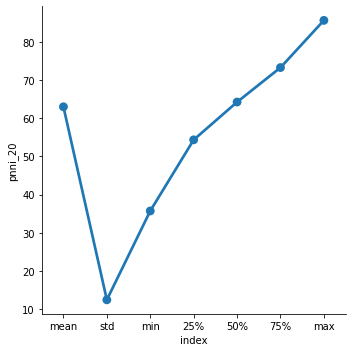

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



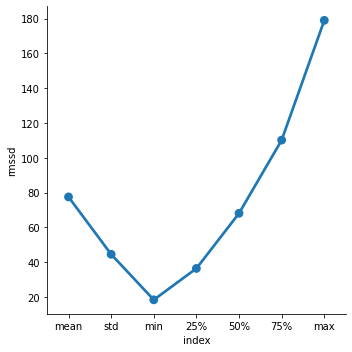

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



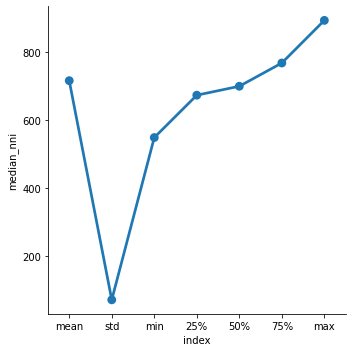

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



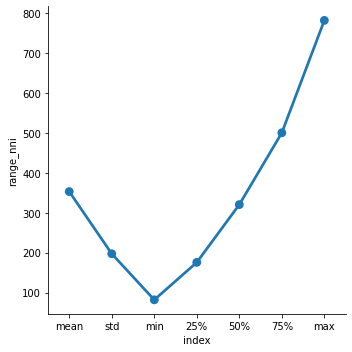

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



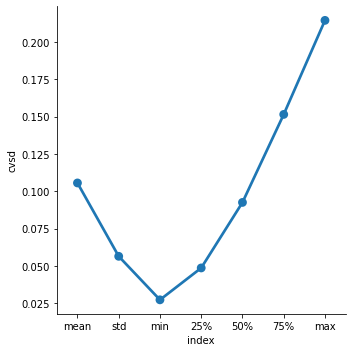

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



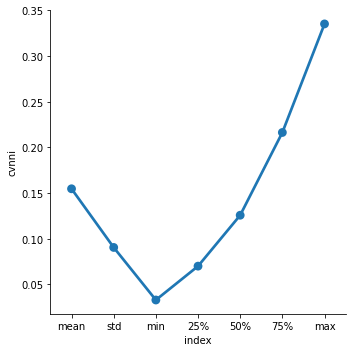

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



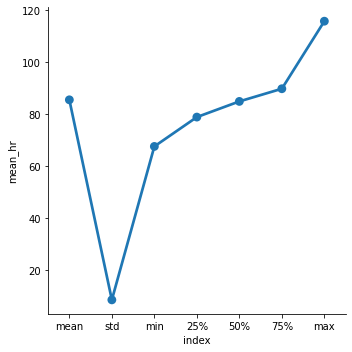

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



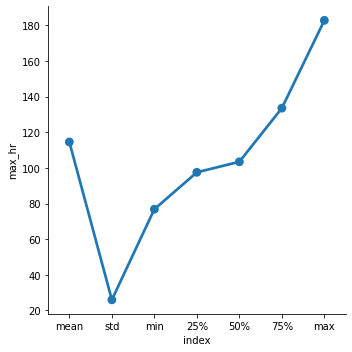

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



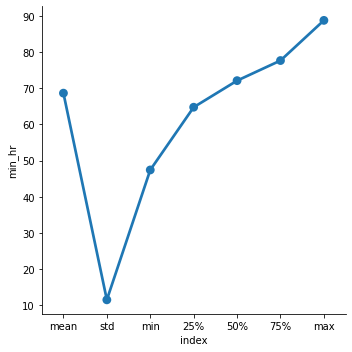

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



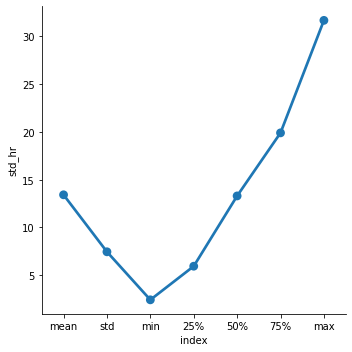

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



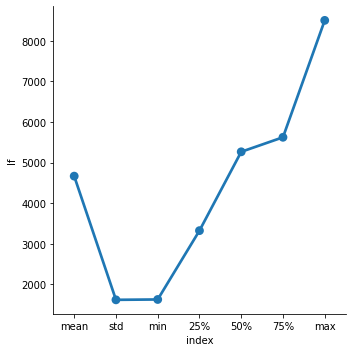

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



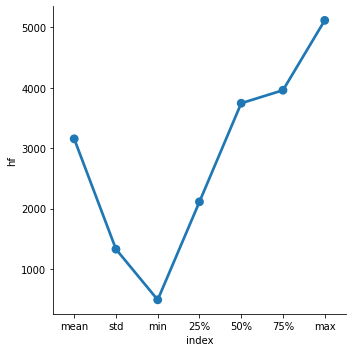

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



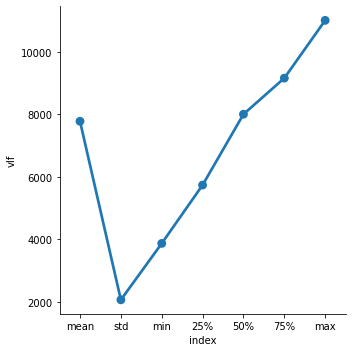

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



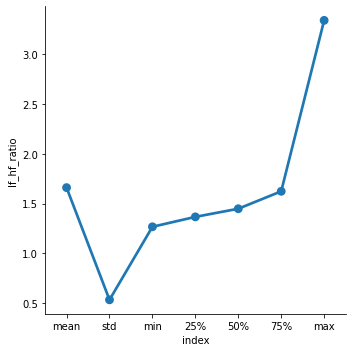

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



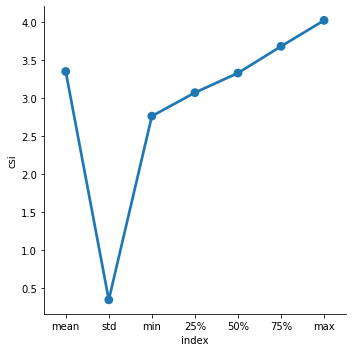

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



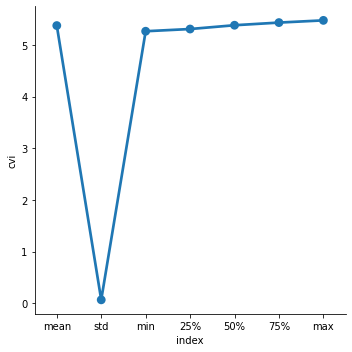

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



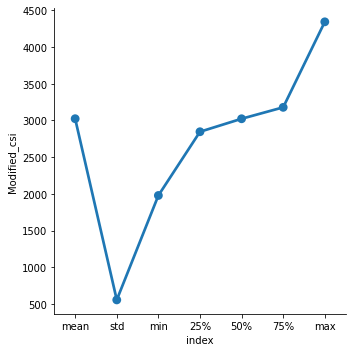

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



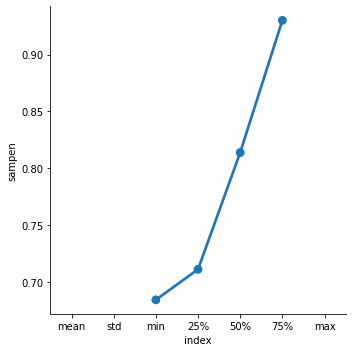

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



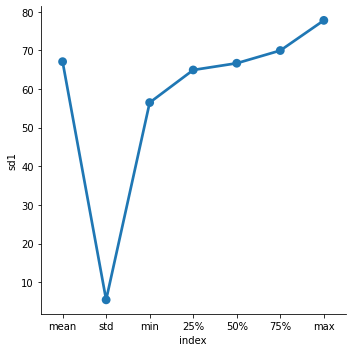

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



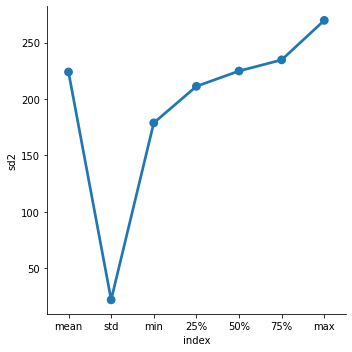

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



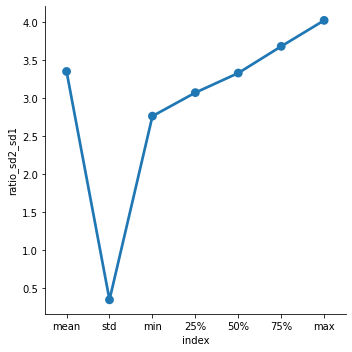

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



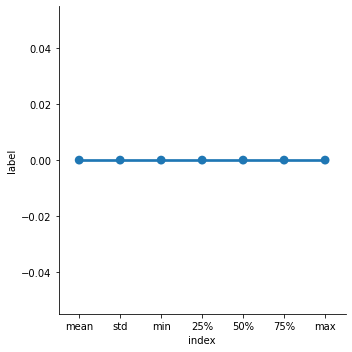

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/categorical.py:3717: UserWarning:

The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.



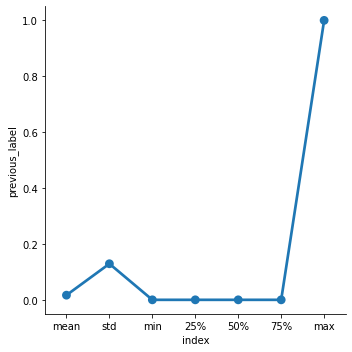

In [93]:
interseizure_50_period[11].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = interseizure_50_period[11][interseizure_50_period[11]['index'] != 'count']
for i in interseizure_50_period[11].columns.tolist():
    if i in ['index']:
        continue
    sns.factorplot(x='index', y=i, data=describe_num_df)
    plt.show()

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



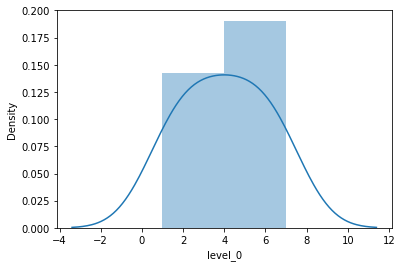

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



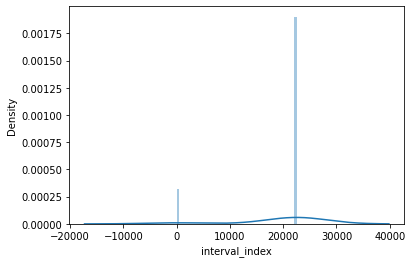

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



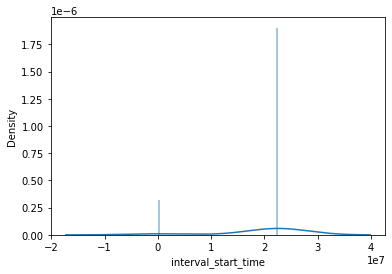

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



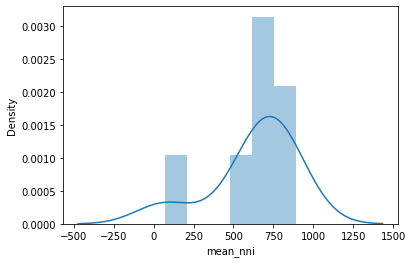

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



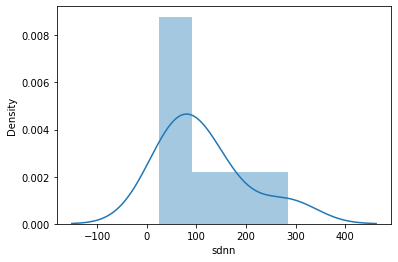

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



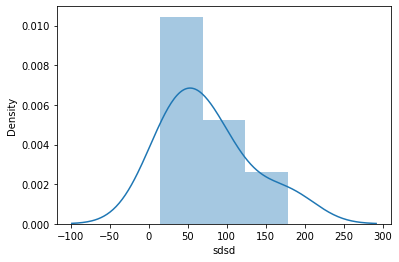

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



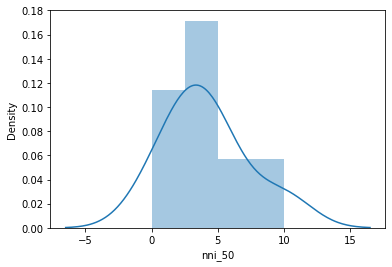

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



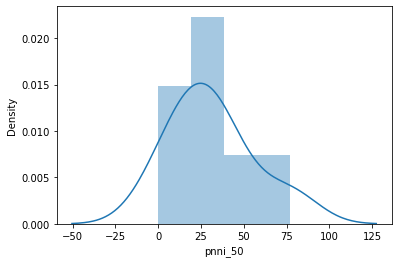

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



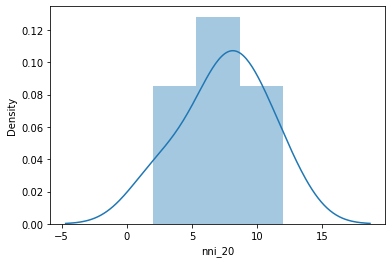

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



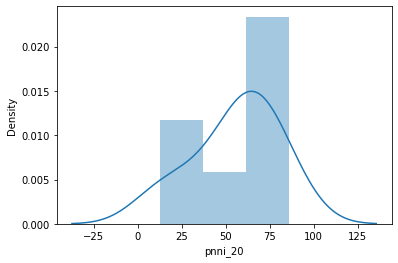

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



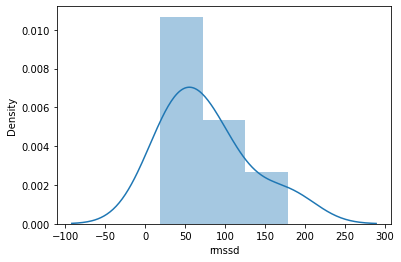

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



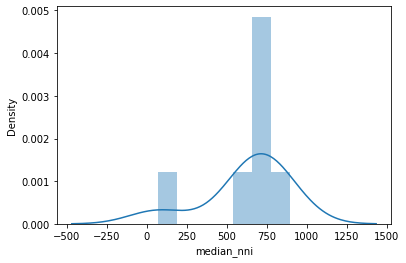

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



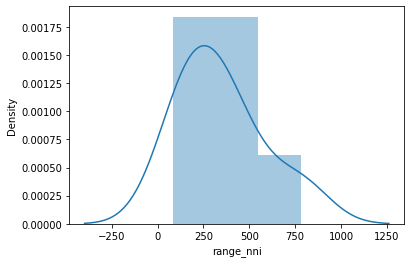

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



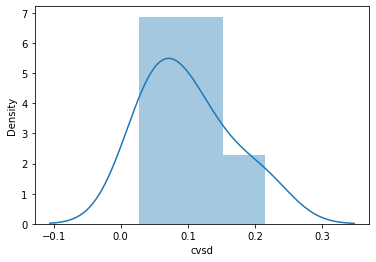

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



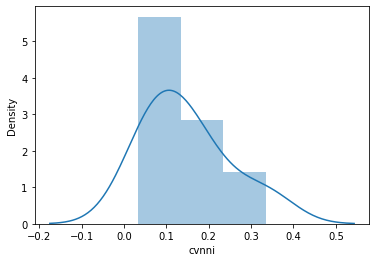

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



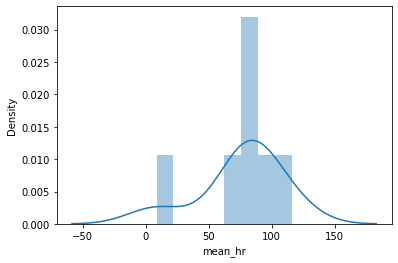

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



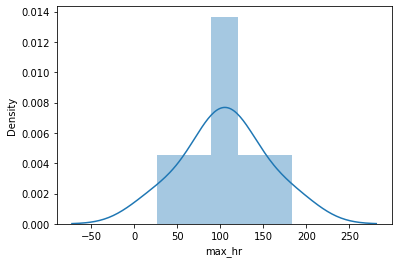

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



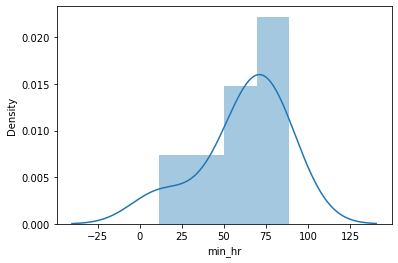

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



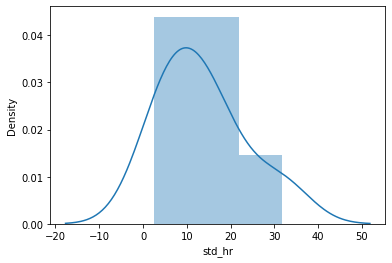

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



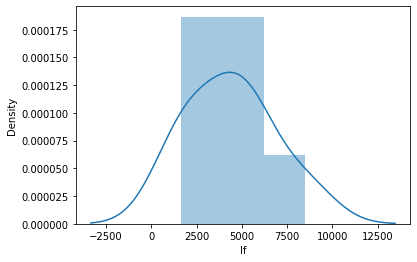

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



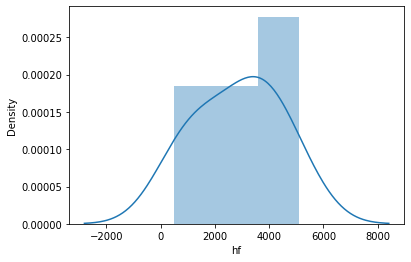

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



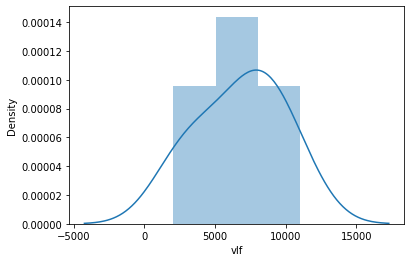

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



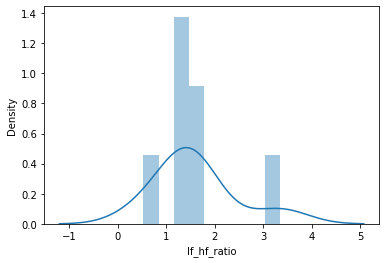

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



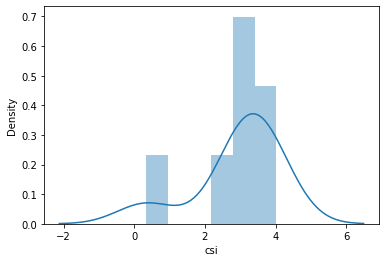

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



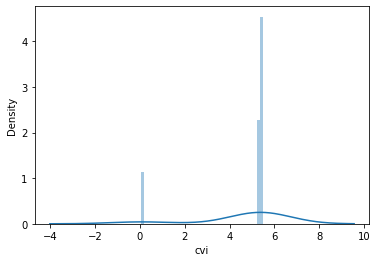

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



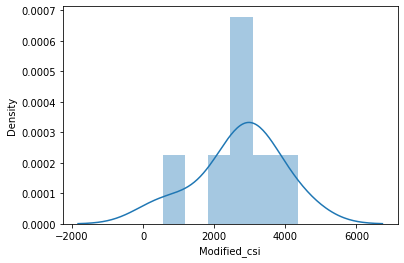

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/home/aura-sakhite/.local/lib/python3.6/site-packages/seaborn/distributions.py:2465: RuntimeWarning:

invalid value encountered in double_scalars



ValueError: cannot convert float NaN to integer

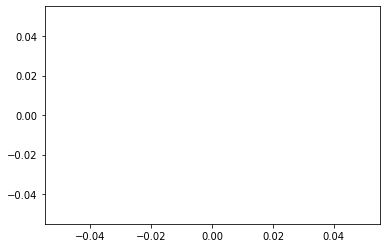

In [94]:
interseizure_50_period[11].reset_index(inplace=True)
# To remove any variable from plot
describe_num_df = interseizure_50_period[11][interseizure_50_period[11]['index'] != 'count']
for i in interseizure_50_period[11].columns.tolist():
    if i in ['index']:
        continue
    sns.distplot(describe_num_df[i])
    plt.show()

### Visualisation

In [ ]:
labels_list = []
for i, p in df_files.loc[:, 'path'].iteritems():
    ## Create figure with heart rates and seizures for each session  
    if i==0:
        buttons_list = [[True]]
        labels_list = [df_files.loc[i, 'path'].split('/')[-1]]
        fig = go.Figure(
            data = go.Scatter(
                name = 'Seizure',
                x = df_session['timestamp'], 
                y = df_session['mean_hr'], 
                mode = 'markers',
                marker = go.scatter.Marker(color = df_session['label'].map({0:'blue', 1:'red'}))
            ),
            layout = go.Layout(
                title = go.layout.Title(text = "Mean heart rate and seizures vs. time", x = 0.5),
                xaxis = go.layout.XAxis(title = 'Time', 
                                        rangeslider = go.layout.xaxis.Rangeslider(visible = True)),
                yaxis = go.layout.YAxis(title = 'Mean heart rate')
            )
        )
    else:
        fig.add_trace(
            go.Scatter(
                name = 'Seizure',
                x = df_session['timestamp'], 
                y = df_session['mean_hr'], 
                mode = 'markers',
                marker = go.scatter.Marker(color = df_session['label'].map({0:'blue', 1:'red'})),
                visible = False
            )
        )
        new_list = []
        for j in range(len(buttons_list)):
            buttons_list[j].extend([False])
            new_list.extend([False])
        new_list.extend([True])
        buttons_list.append(new_list)
        
        labels_list.append(df_files.loc[i, 'path'].split('/')[-1])

In [97]:
update_buttons = [go.layout.updatemenu.Button(
                        label = labels_list[i],
                        method = "update",
                        args = [{"visible" : buttons_list[i]}]) for i in range(len(buttons_list))]

fig.update_layout(
    updatemenus = [go.layout.Updatemenu(
        active = 0,
        buttons = update_buttons,
        xanchor = 'center',
        yanchor = 'top'
    )]
)
fig.show()
pio.write_html(fig, figures_path + "heatrates_seizures_vs_time.html")

In [52]:
buttons_list = [[True]]
fig1 = go.Figure(
    data = go.Scatter(
        name = 'Seizure',
        x = df_session['timestamp'], 
        y = df_session['csi'], 
        mode = 'markers',
        marker = go.scatter.Marker(color = df_session['label'].map({0:'blue', 1:'red'}))
    ),
    layout = go.Layout(
        title = go.layout.Title(text = "Cardiac Sympathetic Index vs. time", x = 0.5),
        xaxis = go.layout.XAxis(title = 'Time', 
                                rangeslider = go.layout.xaxis.Rangeslider(visible = True)),
        yaxis = go.layout.YAxis(title = 'CSI')
    )
)

In [54]:
update_buttons = [go.layout.updatemenu.Button(
                        label = labels_list[i],
                        method = "update",
                        args = [{"visible" : buttons_list[i]}]) for i in range(len(buttons_list))]

fig1.update_layout(
    updatemenus = [go.layout.Updatemenu(
        active = 0,
        buttons = update_buttons,
        xanchor = 'center',
        yanchor = 'top'
    )]
)
fig1.show()
pio.write_html(fig, figures_path + "csi_vs_time.html")

In [42]:
df_session_seizure = df_session[df_session['label']==1]
df_session_nonseizure = df_session[df_session['label']==0]

In [43]:
df_session_seizure['label'].unique()

array([1])

In [44]:
df_session_nonseizure['label'].unique()

array([0])

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.



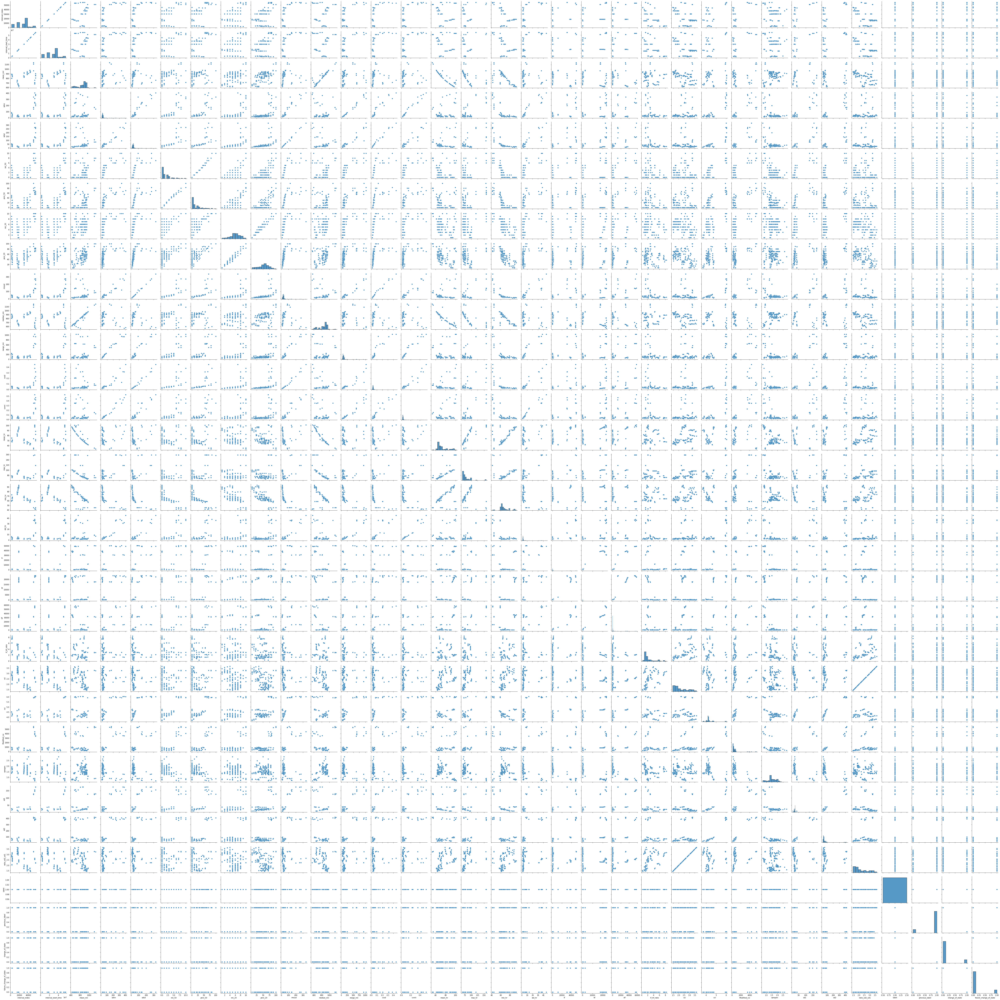

In [45]:
sns.pairplot(df_session_seizure)

In [ ]:
sns.pairplot(df_session_nonseizure)

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

<string>:6: RuntimeWarning:

Converting input from bool to <class 'numpy.uint8'> for compatibility.

